<a href="https://colab.research.google.com/github/Feetly/ML/blob/master/180020006_Prml_Quiz1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Programming Assignment :  Regression

Course Advisor: Prof. S.R.M. Prasanna

Course TA's: Jagabandhu Mishra (183081002@iitdh.ac.in) and 
             Seema K. (173021001@iitdh.ac.in)

Student Name : Dhruv Jain

Roll no. : 180020006

Link to Colab File : 
https://colab.research.google.com/github/Feetly/ML/blob/master/180020006_Prml_Quiz1.ipynb

<h1><strong> # Importing Libraries</strong></h1>

In [1]:
import numpy as np
import pandas as pd
import cv2
from random import randrange
import matplotlib.pyplot as plt
from google.colab import files

<h1><strong> # Importing Files</strong></h1>

In [2]:
files.upload()
data = pd.read_csv("quiz1_dataset.csv",header=None)
data.describe() , data.info(), data.head()

Saving Page1.jpg to Page1.jpg
Saving Page2.jpg to Page2.jpg
Saving Page3.jpg to Page3.jpg
Saving quiz1_dataset.csv to quiz1_dataset.csv
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 487 entries, 0 to 486
Data columns (total 4 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   0       487 non-null    float64
 1   1       487 non-null    float64
 2   2       487 non-null    float64
 3   3       487 non-null    float64
dtypes: float64(4)
memory usage: 15.3 KB


(                0           1           2           3
 count  487.000000  487.000000  487.000000  487.000000
 mean     6.239230   12.963778   18.524641    4.542425
 std      0.644741    7.085219    2.110304    1.656648
 min      3.561000    1.980000   12.600000    1.050000
 25%      5.879500    7.380000   17.400000    3.496500
 50%      6.182000   11.720000   19.100000    4.368000
 75%      6.573000   17.135000   20.200000    5.187000
 max      8.398000   37.970000   22.000000   10.248000,
 None,
        0      1     2      3
 0  7.185   4.03  17.8  7.287
 1  6.998   2.94  18.7  7.014
 2  7.147   5.33  18.7  7.602
 3  6.430   5.21  18.7  6.027
 4  6.012  12.43  15.2  4.809)

<h1><strong> # Regression Class</strong></h1>

In [3]:
class regression:
  def error(self,w,y,x):
    return np.mean(np.square(y - x.T @ w))
  def mat_inv(self,y,x_aug):
    return np.linalg.pinv(x_aug @ x_aug.T) @ x_aug @ y
  def Regression_grad_des(self,x,y,lr=0.0001,epoch=0,A=[],scope=0.0001):
    err = []
    w_pred = np.round(A,4) 
    err_prev = 100000000000000000000
    if (epoch!=0):
        while epoch>0:
            epoch-=1
            err.append(self.error(w_pred,y,x))
            w_pred = w_pred + 2*lr*(x @ (y - x.T @ w_pred))/y.shape[0]
            if ((err_prev - self.error(w_pred,y,x)) <= scope) : break
            err_prev = self.error(w_pred,y,x)
            err = np.asarray(err)
            return w_pred,err
    else:
        while (True):
            err.append(self.error(w_pred,y,x))
            w_pred = w_pred + 2*lr*(x @ (y - x.T @ w_pred))/y.shape[0]
            if ((err_prev - self.error(w_pred,y,x)) <= scope) : break
            err_prev = self.error(w_pred,y,x)
            err = np.asarray(err)
            return w_pred,err

<h1><strong> # K-Fold Cross Validation Class</strong></h1>

In [4]:
class kFoldCV:
    def kFCVEvaluate(self, dataset=data, numFolds=5,extra=[],p=0,q=0,epoch=1000000,scope=0.0001,lr=0.001):
        folds = list()
        dataCopy = dataset.values.tolist()
        foldSize = int(len(dataset) / numFolds)
        for _ in range(numFolds):
            fold = list()
            while len(fold) < foldSize:
                index = randrange(len(dataCopy))
                fold.append(dataCopy.pop(index))
            folds.append(fold)
        
        normalized_test_errors, normalized_train_errors, normalized_test_errors_grad, normalized_train_errors_grad, weights, weights_grad  = [],[],[],[],[],[]
        if (p==1):
            fig, axes = plt.subplots(nrows=6, ncols=2, figsize=(15,30))
            axes_list = [item for sublist in axes for item in sublist] 
        reg = regression()
        
        for index, fold in enumerate(folds): 
            trainSet = list(folds)
            trainSet.remove(fold)
            trainSet = sum(trainSet, [])
            testSet = list()
            for row in fold :   testSet.append(list(row))
                
            y_train = [row[-1] for row in trainSet]
            x_train = [train[:-1] for train in trainSet]
            y_test = [row[-1] for row in testSet]
            x_test = [test[:-1] for test in testSet]
            x_train = np.asarray(x_train).T
            x_train_aug = np.concatenate((np.ones((1,x_train.shape[1])), x_train),axis=0)
            x_test = np.asarray(x_test).T
            x_test_aug = np.concatenate((np.ones((1,x_test.shape[1])), x_test),axis=0)
            y_train = np.asarray(y_train).reshape(len(y_train),1)
            y_test = np.asarray(y_test).reshape(len(y_test),1)

            w_pred_matrix = reg.mat_inv(y_train,x_train_aug)
            w_pred_gradient,err = reg.Regression_grad_des(x_train_aug,y_train,lr=lr,epoch=epoch,A=w_pred_matrix,scope=scope)

            y_pred_test_grad = x_test_aug.T @ w_pred_gradient
            y_pred_train_grad = x_train_aug.T @ w_pred_gradient
            y_pred_test = x_test_aug.T @ w_pred_matrix
            y_pred_train = x_train_aug.T @ w_pred_matrix

            normalized_test_error_grad  = np.mean((y_test - y_pred_test_grad)**2)/((np.max(y_test)-np.mean(y_test))**2)
            normalized_train_error_grad  = np.mean((y_train - y_pred_train_grad)**2)/((np.max(y_train)-np.mean(y_train))**2)
            normalized_test_error  = np.mean((y_test - y_pred_test)**2)/((np.max(y_test)-np.mean(y_test))**2)
            normalized_train_error  = np.mean((y_train - y_pred_train)**2)/((np.max(y_train)-np.mean(y_train))**2)
            
            normalized_test_errors_grad.append(normalized_test_error_grad)
            normalized_train_errors_grad.append(normalized_train_error_grad)
            normalized_test_errors.append(normalized_test_error)
            normalized_train_errors.append(normalized_train_error)
            weights.append(w_pred_matrix)
            weights_grad.append(w_pred_gradient)

            if(p==1):
                ax = axes_list.pop(0)
                ax.plot(x_train_aug[1].T,y_pred_train,'.',label="Regression Line")
                ax.scatter(x_train_aug[1].T, y_train,s=5,c=extra[1],label="Actual Training Scatter")
                ax.scatter(x_test_aug[1].T, y_test,s=5,c='cyan',label="Actual Testing Scatter")
                now = "\nEq : Target = "+str(extra[0])+"*"+str(w_pred_matrix[1])+" + "+str(w_pred_matrix[0]) if (q==0) else "\nDegree : "+str(q)
                ax.set_title("By Matrix Inversion\n"+extra[0]+' vs Target with Fold no. : '+str(index+1)+str(now)+"\nNormalised Train Error : "+str(normalized_train_error)+"\nNormalised Test Error : "+str(normalized_test_error)+"\n")
                ax.set(xlabel=extra[0], ylabel='Target')
                ax.legend(shadow=True, fancybox=True)

                ax = axes_list.pop(0)
                ax.plot(x_train_aug[1].T,y_pred_train_grad,'.',label="Regression Line")
                ax.scatter(x_train_aug[1].T, y_train,s=5,c=extra[1],label="Actual Training Scatter")
                ax.scatter(x_test_aug[1].T, y_test,s=5,c='cyan',label="Actual Testing Scatter")
                now = "\nEq : Target = "+str(extra[0])+"*"+str(w_pred_gradient[1])+" + "+str(w_pred_gradient[0]) if (q==0) else "\nDegree : "+str(q)
                ax.set_title("By Gradient Descent\n"+extra[0]+' vs Target with Fold no. : '+str(index+1)+str(now)+"\nNormalised Train Error : "+str(normalized_train_error_grad)+"\nNormalised Test Error : "+str(normalized_test_error_grad)+"\n")
                ax.set(xlabel=extra[0], ylabel='Target')
                ax.legend(shadow=True, fancybox=True)

            if(p==2) : 
                plt.figure(figsize=(16,8))
                ax = plt.axes(projection ="3d")
                x,y = [],[]
                if (extra[0]=='Feature 1'):
                    x = np.linspace(4, 8, 100)
                elif (extra[0]=='Feature 2'):
                    x = np.linspace(5, 35, 100)
                elif (extra[0]=='Feature 4'):
                    x = np.linspace(14,22, 100)
                else:
                    x = np.linspace(0, 35, 100)
                if (extra[1]=='Feature 1'):
                    y = np.linspace(4, 8, 100)
                elif (extra[1]=='Feature 2'):
                    y = np.linspace(5, 35, 100)
                elif (extra[1]=='Feature 4'):
                    y = np.linspace(14,22, 100)
                else:
                    y = np.linspace(0, 35, 100)
                X, Y = np.meshgrid(x, y)
                Z = X*w_pred_matrix[1] + Y*w_pred_matrix[2] + w_pred_matrix[0]
                ax.plot_surface(X, Y, Z,color='cyan')
                ax.scatter(x_train[0],x_train[1], y_train,c='r',s=7,label="Actual Training Scatter")
                ax.scatter(x_train[0],x_train[1], y_pred_train,c='b',s=10,label="Regression Fit")
                ax.scatter(x_test[0],x_test[1], y_test,c='g',s=7,label="Actual Test Scatter")
                now = " \nEq : Target = "+extra[0]+"*"+str(w_pred_matrix[1])+" + "+extra[1]+"*"+str(w_pred_matrix[2])+" + "+str(w_pred_matrix[0]) if (q==0) else "\nDegree : "+str(q)
                ax.set_title("By Matrix Inversion\n"+extra[0]+", "+extra[1]+" vs Target of Fold no.:"+str(index+1)+str(now)+"\n Normalised Train Error : "+str(normalized_train_error)+"\nNormalised Test Error : "+str(normalized_test_error)+"\n")
                ax.set(xlabel=extra[0], ylabel=extra[1], zlabel="Target")
                ax.legend(shadow=True, fancybox=True)

                plt.figure(figsize=(16,8))
                ax = plt.axes(projection ="3d")
                x,y = [],[]
                if (extra[0]=='Feature 1'):
                    x = np.linspace(4, 8, 100)
                elif (extra[0]=='Feature 2'):
                    x = np.linspace(5, 35, 100)
                elif (extra[0]=='Feature 4'):
                    x = np.linspace(14,22, 100)
                else:
                    x = np.linspace(0, 35, 100)
                if (extra[1]=='Feature 1'):
                    y = np.linspace(4, 8, 100)
                elif (extra[1]=='Feature 2'):
                    y = np.linspace(5, 35, 100)
                elif (extra[1]=='Feature 4'):
                    y = np.linspace(14,22, 100)
                else:
                    y = np.linspace(0, 35, 100)
                X, Y = np.meshgrid(x, y)
                Z = X*w_pred_gradient[1] + Y*w_pred_gradient[2] + w_pred_gradient[0]
                ax.plot_surface(X, Y, Z,color='cyan')
                ax.scatter(x_train[0],x_train[1], y_train,c='r',s=7,label="Actual Training Scatter")
                ax.scatter(x_train[0],x_train[1], y_pred_train,c='b',s=10,label="Regression Fit")
                ax.scatter(x_test[0],x_test[1], y_test,c='g',s=7,label="Actual Test Scatter")
                now = " \nEq : Target = "+extra[0]+"*"+str(w_pred_gradient[1])+" + "+extra[1]+"*"+str(w_pred_gradient[2])+" + "+str(w_pred_gradient[0]) if (q==0) else "\nDegree : "+str(q)
                ax.set_title("By Gradient Descend\n"+extra[0]+", "+extra[1]+" vs Target of Fold no.:"+str(index+1)+str(now)+"\n Normalised Train Error : "+str(normalized_train_error_grad)+"\nNormalised Test Error : "+str(normalized_test_error_grad)+"\n")
                ax.set(xlabel=extra[0], ylabel=extra[1], zlabel="Target")
                ax.legend(shadow=True, fancybox=True)

            print('\n')
            print('*'*20)
            print("Results of Parameters and Errors in K-Fold no. : "+str(index+1))
            print("Weights by Matrix Inversion : \n"+str(w_pred_matrix))
            print("Weights by Gradient Descent : \n"+str(w_pred_gradient))
            print("Normalized Train Error by Matrix Inversion : "+str(normalized_train_error))
            print("Normalized Test Error by Matrix Inversion : "+str(normalized_test_error))
            print("Normalized Train Error by Gradient Descent : "+str(normalized_train_error_grad))
            print("Normalized Test Error by Gradient Descent : "+str(normalized_test_error_grad))
            print('*'*20)
   
        average_weights = np.mean(weights,axis=0)
        average_weights_grad = np.mean(weights_grad,axis=0)
        normalized_test_errors_avg = np.mean(normalized_test_errors)
        normalized_train_errors_avg = np.mean(normalized_train_errors)
        normalized_test_errors_avg_grad = np.mean(normalized_test_errors_grad)
        normalized_train_errors_avg_grad = np.mean(normalized_train_errors_grad)

        if(p==1):
            ax = axes_list.pop(0)
            ax.plot(dataset[dataset.columns[0]],np.dot(dataset.iloc[:,:-1].to_numpy(),average_weights[1:]) + average_weights[0],'.',label="Regression Line")
            ax.scatter(dataset[dataset.columns[0]], dataset[dataset.columns[-1]],s=5,c=extra[1],label="Actual Scatter")
            now = "\nEq : Target = "+str(extra[0])+"*"+str(average_weights[1])+" + "+str(average_weights[0]) if (q==0) else "\nDegree : "+str(q)
            ax.set_title("By Matrix Inversion\n"+extra[0]+" vs Target Final Average"+str(now)+"\n Average Normalised Train Error : "+str(normalized_train_errors_avg)+"\nAverage Normalised Test Error : "+str(normalized_test_errors_avg)+"\n")
            ax.set(xlabel=extra[0], ylabel='Target')
            ax.legend(shadow=True, fancybox=True)

            ax = axes_list.pop(0)
            ax.plot(dataset[dataset.columns[0]],np.dot(dataset.iloc[:,:-1].to_numpy(),average_weights_grad[1:]) + average_weights_grad[0],'.',label="Regression Line")
            ax.scatter(dataset[dataset.columns[0]], dataset[dataset.columns[-1]],s=5,c=extra[1],label="Actual Scatter")
            now = "\nEq : Target = "+str(extra[0])+"*"+str(average_weights_grad[1])+" + "+str(average_weights_grad[0]) if (q==0) else "\nDegree : "+str(q)
            ax.set_title("By Gradient Descend\n"+extra[0]+" vs Target Final Average"+str(now)+"\n Average Normalised Train Error : "+str(normalized_train_errors_avg_grad)+"\nAverage Normalised Test Error : "+str(normalized_test_errors_avg_grad)+"\n")
            ax.set(xlabel=extra[0], ylabel='Target')
            ax.legend(shadow=True, fancybox=True)
            plt.tight_layout()
            plt.show()

        if(p==2):
            plt.figure(figsize=(16,8))
            ax = plt.axes(projection ="3d")
            x,y = [],[]
            if (extra[0]=='Feature 1'):
                x = np.linspace(4, 8, 100)
            elif (extra[0]=='Feature 2'):
                x = np.linspace(5, 35, 100)
            elif (extra[0]=='Feature 4'):
                x = np.linspace(14,22, 100)
            else:
                x = np.linspace(0, 35, 100)
            if (extra[1]=='Feature 1'):
                y = np.linspace(4, 8, 100)
            elif (extra[1]=='Feature 2'):
                y = np.linspace(5, 35, 100)
            elif (extra[1]=='Feature 4'):
                y = np.linspace(14,22, 100)
            else:
                y = np.linspace(0, 35, 100)
            X, Y = np.meshgrid(x, y)
            Z = X*average_weights[1] + Y*average_weights[2] + average_weights[0]
            ax.plot_surface(X, Y, Z,color='cyan')
            ax.scatter(dataset[dataset.columns[0]],dataset[dataset.columns[1]],np.dot(dataset.iloc[:,:-1].to_numpy(),average_weights[1:]) + average_weights[0],label="Regression Line",s=10)
            ax.scatter(dataset[dataset.columns[0]],dataset[dataset.columns[1]], dataset[dataset.columns[-1]],c='r',s=7,label="Actual Scatter")
            now = "\nEq : Target = "+extra[0]+"*"+str(average_weights[1])+" + "+extra[1]+"*"+str(average_weights[2])+" + "+str(average_weights[0]) if (q==0) else "\nDegree : "+str(q)
            ax.set_title("By Matrix Inversion\n"+extra[0]+", "+extra[1]+" vs Target Final Average"+str(now)+"\nAverage Normalised Train Error : "+str(normalized_train_errors_avg)+"\nAverage Normalised Test Error : "+str(normalized_test_errors_avg)+"\n")
            ax.set(xlabel=extra[0], ylabel=extra[1], zlabel="Target")
            ax.legend(shadow=True, fancybox=True)

            plt.figure(figsize=(16,8))
            ax = plt.axes(projection ="3d")
            x,y = [],[]
            if (extra[0]=='Feature 1'):
                x = np.linspace(4, 8, 100)
            elif (extra[0]=='Feature 2'):
                x = np.linspace(5, 35, 100)
            elif (extra[0]=='Feature 4'):
                x = np.linspace(14,22, 100)
            else:
                x = np.linspace(0, 35, 100)
            if (extra[1]=='Feature 1'):
                y = np.linspace(4, 8, 100)
            elif (extra[1]=='Feature 2'):
                y = np.linspace(5, 35, 100)
            elif (extra[1]=='Feature 4'):
                y = np.linspace(14,22, 100)
            else:
                y = np.linspace(0, 35, 100)
            X, Y = np.meshgrid(x, y)
            Z = X*average_weights_grad[1] + Y*average_weights_grad[2] + average_weights_grad[0]
            ax.plot_surface(X, Y, Z,color='cyan')
            ax.scatter(dataset[dataset.columns[0]],dataset[dataset.columns[1]],np.dot(dataset.iloc[:,:-1].to_numpy(),average_weights_grad[1:]) + average_weights_grad[0],label="Regression Line",s=10)
            ax.scatter(dataset[dataset.columns[0]],dataset[dataset.columns[1]], dataset[dataset.columns[-1]],c='r',s=7,label="Actual Scatter")
            now = "\nEq : Target = "+extra[0]+"*"+str(average_weights_grad[1])+" + "+extra[1]+"*"+str(average_weights_grad[2])+" + "+str(average_weights_grad[0]) if (q==0) else "\nDegree : "+str(q)
            ax.set_title("By Gradient Descend\n"+extra[0]+", "+extra[1]+" vs Target Final Average"+str(now)+"\nAverage Normalised Train Error : "+str(normalized_train_errors_avg_grad)+"\nAverage Normalised Test Error : "+str(normalized_test_errors_avg_grad)+"\n")
            ax.set(xlabel=extra[0], ylabel=extra[1], zlabel="Target")
            ax.legend(shadow=True, fancybox=True)
            plt.tight_layout()
            plt.show()

        if(p==3):
            fig = plt.figure(figsize=(16,8))
            ax = fig.add_subplot(111, projection='3d')
            img  = ax.scatter(dataset[dataset.columns[0]],dataset[dataset.columns[1]],dataset[dataset.columns[2]],s=4,c=dataset.iloc[:,-1],cmap=plt.hot(),label="Actual Scatter Output Color")
            img2  = ax.scatter(dataset[dataset.columns[0]],dataset[dataset.columns[1]],dataset[dataset.columns[2]],s=4,c=np.dot(dataset.iloc[:,:-1].to_numpy(),average_weights[1:]) + average_weights[0],cmap=plt.hot(),label="Regression Scatter Output Color by Matrix Inversion ")
            img3  = ax.scatter(dataset[dataset.columns[0]],dataset[dataset.columns[1]],dataset[dataset.columns[2]],s=4,c=np.dot(dataset.iloc[:,:-1].to_numpy(),average_weights_grad[1:]) + average_weights_grad[0],cmap=plt.hot(),label="Regression Scatter Output Color by Gradient Descend")
            now =  ' of Degree : '+str(q) if (q>=1) else ''
            ax.set_title('Feature 1,Feature 2,Feature 3 vs Target'+str(now))
            ax.set(xlabel='Feature 1', ylabel='Feature 2', zlabel="Feature 3")
            a = plt.colorbar(img)
            a.set_label("Target, Actual in Color")
            b = plt.colorbar(img2)
            b.set_label("Target, Predicted by Matrix Inversion")
            c = plt.colorbar(img3)
            c.set_label("Target, Predicted by Gradient Descend")
            plt.tight_layout()
            plt.show()

        print('\n')
        print('*'*20)
        print("Final Results :")
        print("Mean of Weights in k-Fold by Matrix Inversion Method : \n"+str(average_weights))
        print("Standard Deviation of Weights in k-Fold by Matrix Inversion Method : \n"+str(np.std(weights,axis=0)))
        print("Mean of Weights in k-Fold by Gradient Descend Method : \n"+str(average_weights_grad))
        print("Standard Deviation of Weights in k-Fold by Gradient Descend Method : \n"+str(np.std(weights_grad,axis=0)))
        print("Mean of Normalised Train Error in k-Fold by Matrix Inversion : "+str(normalized_train_errors_avg))
        print("Standard Deviation of Normalised Train Error in k-Fold by Matrix Inversion : "+str(np.std(normalized_train_errors)))
        print("Mean of Normalised Test Error in k-Fold by Matrix Inversion : "+str(normalized_test_errors_avg))
        print("Standard Deviation of Normalised Test Error in k-Fold by Matrix Inversion : "+str(np.std(normalized_test_errors)))
        print("Mean of Normalised Train Error in k-Fold by Gradient Descent : "+str(normalized_train_errors_avg_grad))
        print("Standard Deviation of Normalised Train Error in k-Fold by Gradient Descent : "+str(np.std(normalized_train_errors_grad)))
        print("Mean of Normalised Test Error in k-Fold by Gradient Descent : "+str(normalized_test_errors_avg_grad))
        print("Standard Deviation of Normalised Test Error in k-Fold by Gradient Descent : "+str(np.std(normalized_test_errors_grad)))
        print('*'*20)
        print("\n")

        return average_weights,average_weights_grad

k = kFoldCV()

<h1><strong> # Visualization of Data</strong></h1>

<h3><strong> 1. 2D Plots</strong></h3>

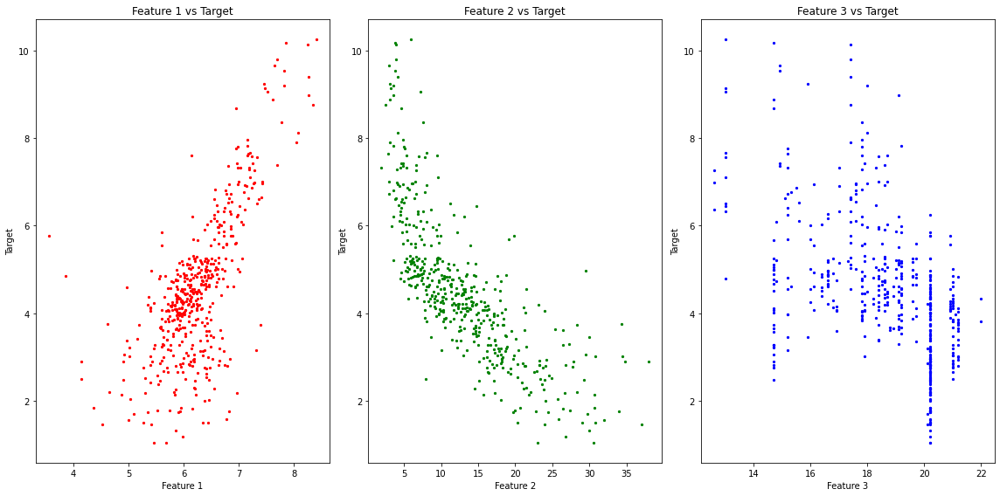

In [5]:
fig, (ax1, ax2, ax3) = plt.subplots(figsize=(16, 8),nrows = 1, ncols = 3)

ax1.scatter(data[0], data[3],s=5,c='r')
ax1.set_title('Feature 1 vs Target')
ax1.set(xlabel='Feature 1', ylabel='Target')

ax2.scatter(data[1], data[3],s=5,c='g')
ax2.set_title('Feature 2 vs Target')
ax2.set(xlabel='Feature 2', ylabel='Target')

ax3.scatter(data[2], data[3],s=5,c='b')
ax3.set_title('Feature 3 vs Target')
ax3.set(xlabel='Feature 3', ylabel='Target')

fig.tight_layout()

<h3><strong> 2. 3D Plots</strong></h3>

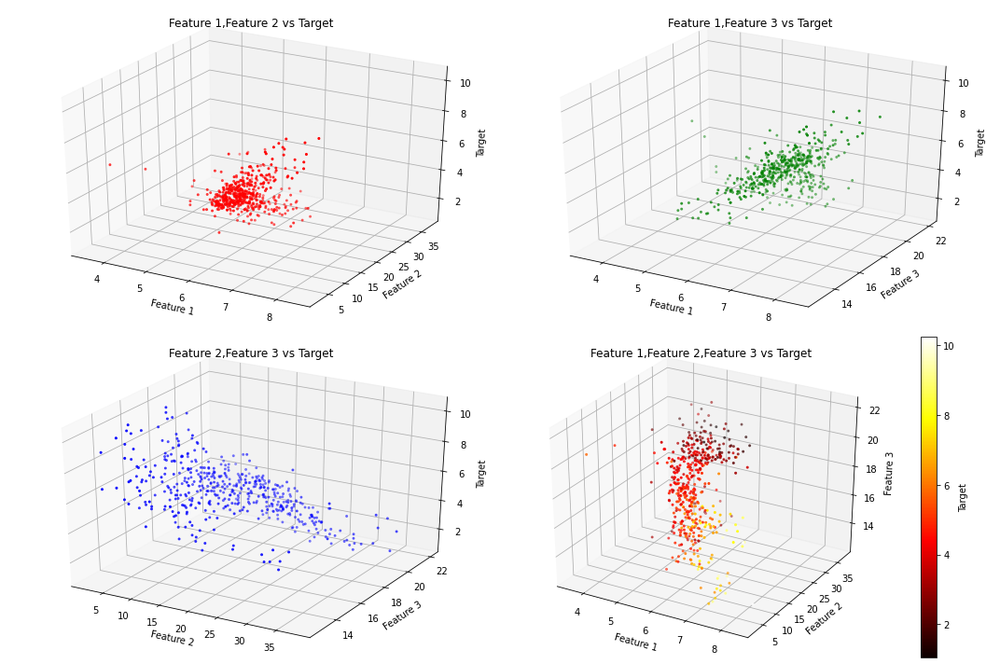

In [6]:
fig = plt.figure(figsize=(15,10))

ax1 = fig.add_subplot(2, 2, 1, projection='3d')
ax1.scatter(data[0], data[1], data[3],s=4,c='r')
ax1.set_title('Feature 1,Feature 2 vs Target')
ax1.set(xlabel='Feature 1', ylabel='Feature 2', zlabel="Target")

ax2 = fig.add_subplot(2, 2, 2, projection='3d')
ax2.scatter(data[0], data[2], data[3],s=4,c='g')
ax2.set_title('Feature 1,Feature 3 vs Target')
ax2.set(xlabel='Feature 1', ylabel='Feature 3', zlabel="Target")

ax3 = fig.add_subplot(2, 2, 3, projection='3d')
ax3.scatter(data[1], data[2], data[3],s=4,c='b')
ax3.set_title('Feature 2,Feature 3 vs Target')
ax3.set(xlabel='Feature 2', ylabel='Feature 3', zlabel="Target")

ax4 = fig.add_subplot(2, 2, 4, projection='3d')
img  = ax4.scatter(data[0], data[1], data[2],s=4,c=data[3],cmap=plt.hot())
ax4.set_title('Feature 1,Feature 2,Feature 3 vs Target')
ax4.set(xlabel='Feature 1', ylabel='Feature 2', zlabel="Feature 3")

a = plt.colorbar(img)
a.set_label("Target")
fig.tight_layout()
plt.show()

<h1><strong> Question 1</strong></h1>
<h2><strong> A. Univariate Linear Regression</strong></h2>

<h3><strong> A. Handwritten Notes</strong></h3>

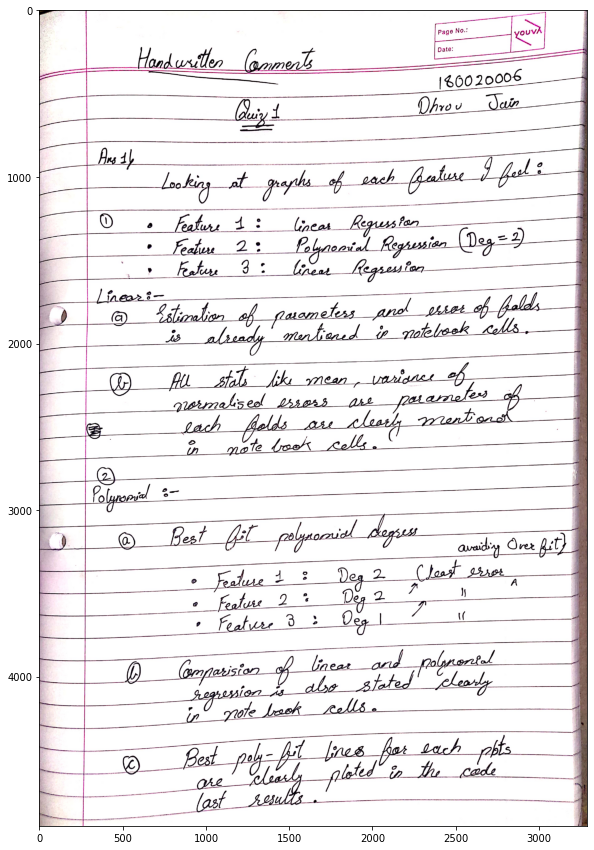

In [7]:
im = cv2.imread('Page1.jpg')
plt.figure(figsize=(30,15))
plt.imshow(cv2.cvtColor(im, cv2.COLOR_BGR2RGB))
plt.show()

<h3><strong> A. Solution Code</strong></h3>



********************
Results of Parameters and Errors in K-Fold no. : 1
Weights by Matrix Inversion : 
[[-7.33243159]
 [ 1.90131364]]
Weights by Gradient Descent : 
[[-7.33239989]
 [ 1.90130068]]
Normalized Train Error by Matrix Inversion : 0.042270235626546034
Normalized Test Error by Matrix Inversion : 0.055104882317564524
Normalized Train Error by Gradient Descent : 0.042270235703583146
Normalized Test Error by Gradient Descent : 0.05510479297712656
********************


********************
Results of Parameters and Errors in K-Fold no. : 2
Weights by Matrix Inversion : 
[[-5.97229048]
 [ 1.67821182]]
Weights by Gradient Descent : 
[[-5.97229983]
 [ 1.67820105]]
Normalized Train Error by Matrix Inversion : 0.0459888073861873
Normalized Test Error by Matrix Inversion : 0.03857764525164366
Normalized Train Error by Gradient Descent : 0.04598880757097284
Normalized Test Error by Gradient Descent : 0.038578758302180285
********************


********************
Results of Parameter

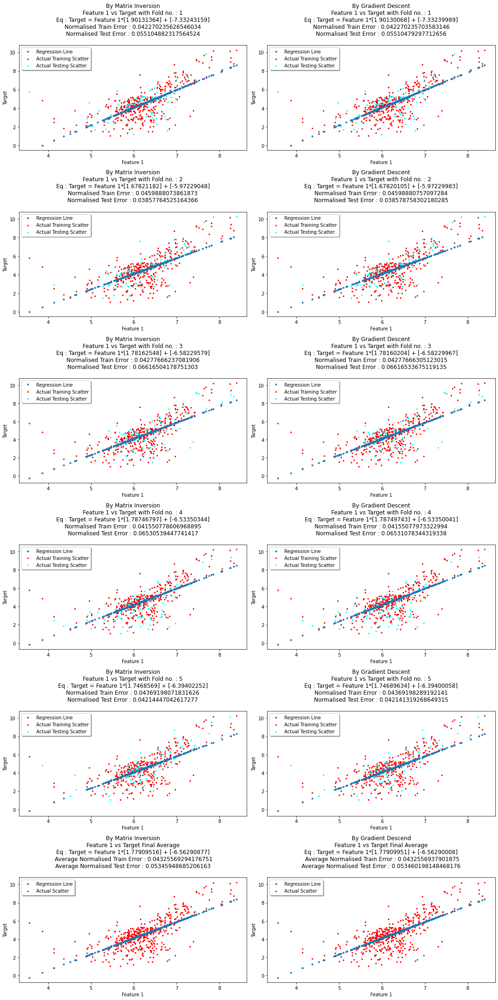



********************
Final Results :
Mean of Weights in k-Fold by Matrix Inversion Method : 
[[-6.56290877]
 [ 1.77909516]]
Standard Deviation of Weights in k-Fold by Matrix Inversion Method : 
[[0.44062647]
 [0.07243013]]
Mean of Weights in k-Fold by Gradient Descend Method : 
[[-6.56290008]
 [ 1.77909951]]
Standard Deviation of Weights in k-Fold by Gradient Descend Method : 
[[0.44061465]
 [0.07242577]]
Mean of Normalised Train Error in k-Fold by Matrix Inversion : 0.04325569294176751
Standard Deviation of Normalised Train Error in k-Fold by Matrix Inversion : 0.0015341180454769739
Mean of Normalised Test Error in k-Fold by Matrix Inversion : 0.05345948685206163
Standard Deviation of Normalised Test Error in k-Fold by Matrix Inversion : 0.011436457371600019
Mean of Normalised Train Error in k-Fold by Gradient Descent : 0.0432556937901875
Standard Deviation of Normalised Train Error in k-Fold by Gradient Descent : 0.0015341179322295882
Mean of Normalised Test Error in k-Fold by Grad

In [8]:
w1 = k.kFCVEvaluate(dataset=data[[0,3]],extra=['Feature 1','r'],p=1,epoch=0,scope=0.0001,lr=0.001)



********************
Results of Parameters and Errors in K-Fold no. : 1
Weights by Matrix Inversion : 
[[ 6.83536671]
 [-0.17757657]]
Weights by Gradient Descent : 
[[ 6.83540053]
 [-0.17759079]]
Normalized Train Error by Matrix Inversion : 0.03739455866977244
Normalized Test Error by Matrix Inversion : 0.037439513404299636
Normalized Train Error by Gradient Descent : 0.037394559668939654
Normalized Test Error by Gradient Descent : 0.03743966616935039
********************


********************
Results of Parameters and Errors in K-Fold no. : 2
Weights by Matrix Inversion : 
[[ 6.94796943]
 [-0.18329725]]
Weights by Gradient Descent : 
[[ 6.94800001]
 [-0.1832996 ]]
Normalized Train Error by Matrix Inversion : 0.03743480185363954
Normalized Test Error by Matrix Inversion : 0.04379176991700883
Normalized Train Error by Gradient Descent : 0.03743480186189654
Normalized Test Error by Gradient Descent : 0.04379205288591844
********************


********************
Results of Parameters

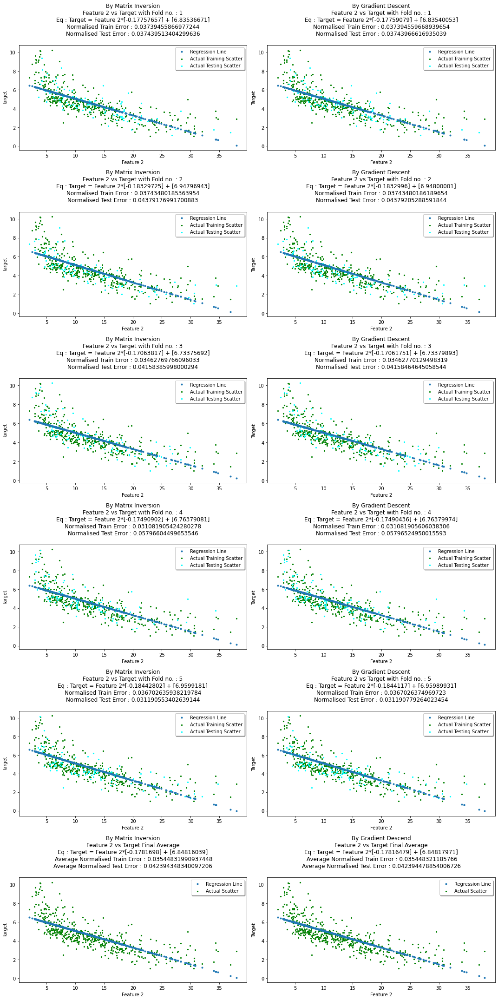



********************
Final Results :
Mean of Weights in k-Fold by Matrix Inversion Method : 
[[ 6.84816039]
 [-0.1781698 ]]
Standard Deviation of Weights in k-Fold by Matrix Inversion Method : 
[[0.09254371]
 [0.00516074]]
Mean of Weights in k-Fold by Gradient Descend Method : 
[[ 6.84817971]
 [-0.17816479]]
Standard Deviation of Weights in k-Fold by Gradient Descend Method : 
[[0.09253282]
 [0.00516355]]
Mean of Normalised Train Error in k-Fold by Matrix Inversion : 0.03544831990937448
Standard Deviation of Normalised Train Error in k-Fold by Matrix Inversion : 0.0024102390278898686
Mean of Normalised Test Error in k-Fold by Matrix Inversion : 0.042394348340097206
Standard Deviation of Normalised Test Error in k-Fold by Matrix Inversion : 0.008890026157972852
Mean of Normalised Train Error in k-Fold by Gradient Descent : 0.035448321185766
Standard Deviation of Normalised Train Error in k-Fold by Gradient Descent : 0.0024102390395403287
Mean of Normalised Test Error in k-Fold by Grad

In [9]:
w2 = k.kFCVEvaluate(dataset=data[[1,3]],extra=['Feature 2','g'],p=1,epoch=0,scope=0.0001,lr=0.001)



********************
Results of Parameters and Errors in K-Fold no. : 1
Weights by Matrix Inversion : 
[[12.30168259]
 [-0.41889546]]
Weights by Gradient Descent : 
[[12.30170013]
 [-0.41889748]]
Normalized Train Error by Matrix Inversion : 0.06193200190205409
Normalized Test Error by Matrix Inversion : 0.0658618986672079
Normalized Train Error by Gradient Descent : 0.06193200191504121
Normalized Test Error by Gradient Descent : 0.06586192460280747
********************


********************
Results of Parameters and Errors in K-Fold no. : 2
Weights by Matrix Inversion : 
[[11.65830889]
 [-0.38216029]]
Weights by Gradient Descent : 
[[11.65830149]
 [-0.38217216]]
Normalized Train Error by Matrix Inversion : 0.06252502879148085
Normalized Test Error by Matrix Inversion : 0.06003432483262622
Normalized Train Error by Gradient Descent : 0.06252503042059382
Normalized Test Error by Gradient Descent : 0.06003142595868727
********************


********************
Results of Parameters an

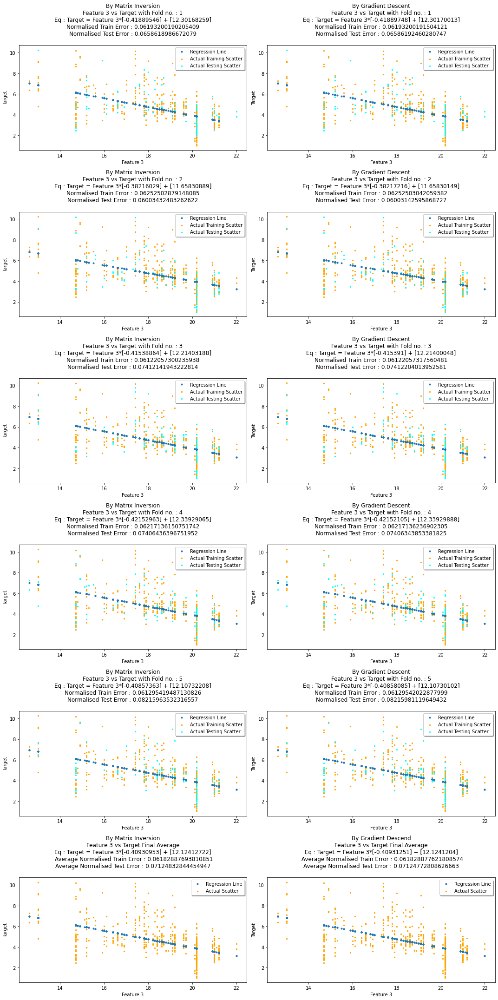



********************
Final Results :
Mean of Weights in k-Fold by Matrix Inversion Method : 
[[12.12412722]
 [-0.40930953]]
Standard Deviation of Weights in k-Fold by Matrix Inversion Method : 
[[0.24624102]
 [0.01425341]]
Mean of Weights in k-Fold by Gradient Descend Method : 
[[12.1241204 ]
 [-0.40931251]]
Standard Deviation of Weights in k-Fold by Gradient Descend Method : 
[[0.24624578]
 [0.01424782]]
Mean of Normalised Train Error in k-Fold by Matrix Inversion : 0.06182887693810851
Standard Deviation of Normalised Train Error in k-Fold by Matrix Inversion : 0.0005034219644944427
Mean of Normalised Test Error in k-Fold by Matrix Inversion : 0.07124832844454947
Standard Deviation of Normalised Test Error in k-Fold by Matrix Inversion : 0.00761588902812934
Mean of Normalised Train Error in k-Fold by Gradient Descent : 0.061828877621808574
Standard Deviation of Normalised Train Error in k-Fold by Gradient Descent : 0.0005034223337584348
Mean of Normalised Test Error in k-Fold by Gra

In [10]:
w3 = k.kFCVEvaluate(dataset=data[[2,3]],extra=['Feature 3','orange'],p=1,epoch=0,scope=0.0001,lr=0.001)

<h2><strong> A. Results of Linear Regression</strong></h2>

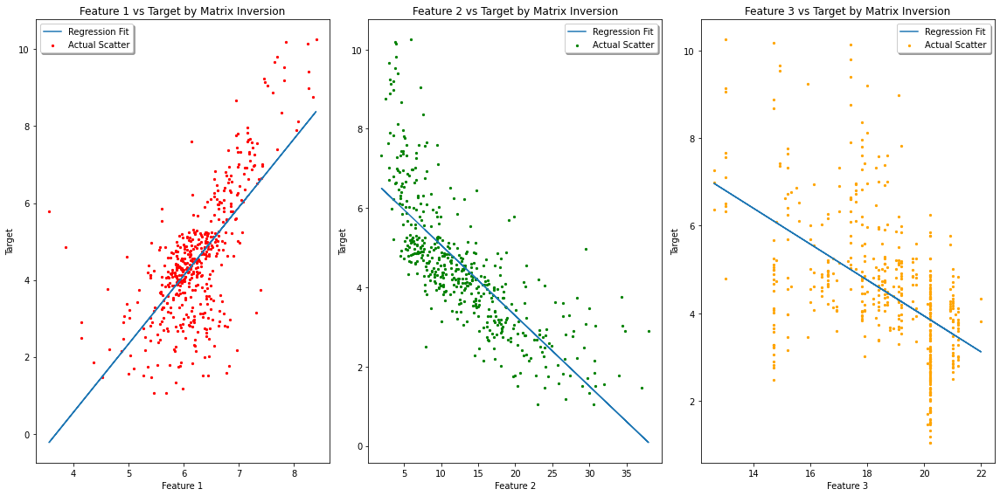

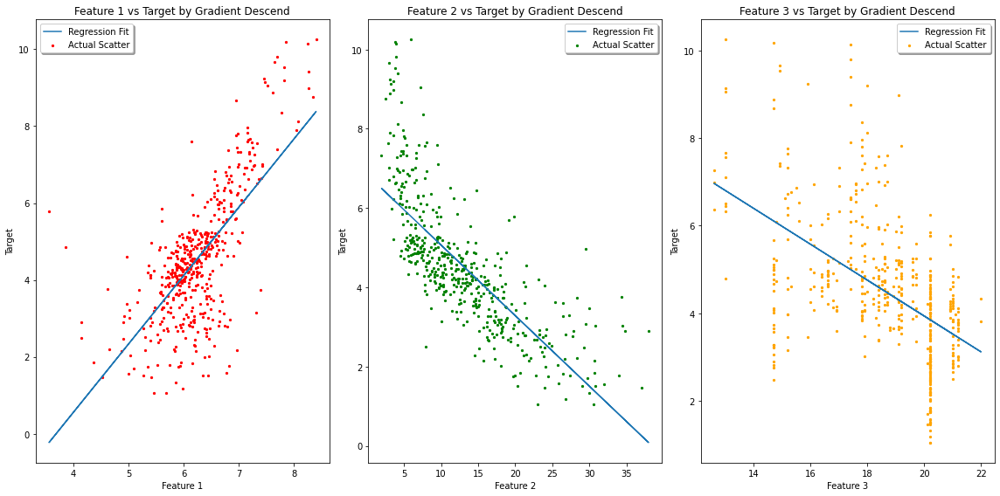

In [11]:
for i,val in enumerate(['Matrix Inversion','Gradient Descend']):    
    fig, (ax1, ax2, ax3) = plt.subplots(figsize=(16, 8),nrows = 1, ncols = 3)

    ax1.scatter(data[0], data[3],s=5,c='r',label="Actual Scatter")
    ax1.plot(data[0], data[0]*w1[i][1]+w1[i][0],label="Regression Fit")
    ax1.set_title('Feature 1 vs Target by '+str(val))
    ax1.set(xlabel='Feature 1', ylabel='Target')
    ax1.legend(shadow=True, fancybox=True)

    ax2.scatter(data[1], data[3],s=5,c='g',label="Actual Scatter")
    ax2.plot(data[1], data[1]*w2[i][1]+w2[i][0],label="Regression Fit")
    ax2.set_title('Feature 2 vs Target by '+str(val))
    ax2.set(xlabel='Feature 2', ylabel='Target')
    ax2.legend(shadow=True, fancybox=True)

    ax3.scatter(data[2], data[3],s=5,c='orange',label="Actual Scatter")
    ax3.plot(data[2], data[2]*w3[i][1]+w3[i][0],label="Regression Fit")
    ax3.set_title('Feature 3 vs Target by '+str(val))
    ax3.set(xlabel='Feature 3', ylabel='Target')
    ax3.legend(shadow=True, fancybox=True)

    fig.tight_layout()
    plt.show()

<h2><strong> A. Univariate Polynomial Regression</strong></h2>



PolyFit For Degree : 1


********************
Results of Parameters and Errors in K-Fold no. : 1
Weights by Matrix Inversion : 
[[-6.88721726]
 [ 1.82570704]]
Weights by Gradient Descent : 
[[-6.8872]
 [ 1.8257]]
Normalized Train Error by Matrix Inversion : 0.042522758318267
Normalized Test Error by Matrix Inversion : 0.06812686152653881
Normalized Train Error by Gradient Descent : 0.042522758340505326
Normalized Test Error by Gradient Descent : 0.0681272413257444
********************


********************
Results of Parameters and Errors in K-Fold no. : 2
Weights by Matrix Inversion : 
[[-7.5791732 ]
 [ 1.94181656]]
Weights by Gradient Descent : 
[[-7.5792]
 [ 1.9418]]
Normalized Train Error by Matrix Inversion : 0.04043236158360384
Normalized Test Error by Matrix Inversion : 0.08516773785078861
Normalized Train Error by Gradient Descent : 0.04043236210676063
Normalized Test Error by Gradient Descent : 0.08516735778031417
********************


********************
Results of Param

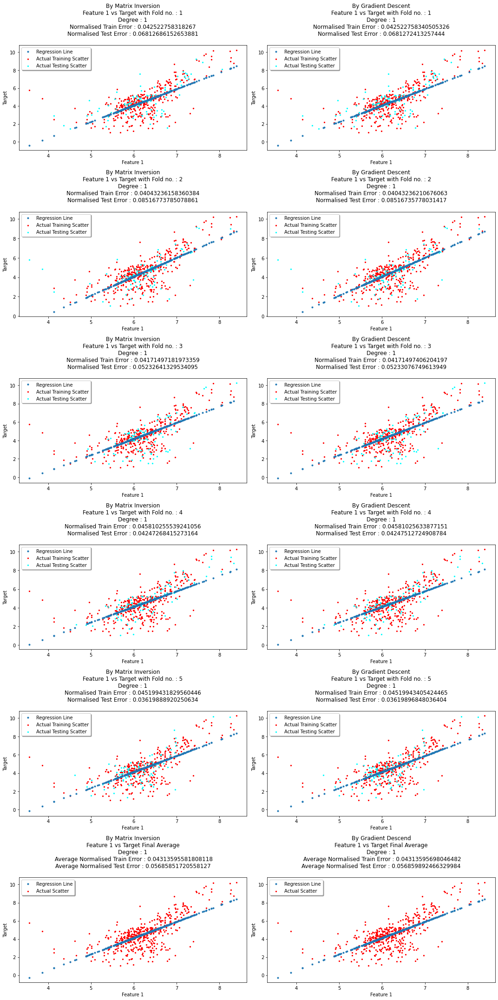



********************
Final Results :
Mean of Weights in k-Fold by Matrix Inversion Method : 
[[-6.61326564]
 [ 1.78721112]]
Standard Deviation of Weights in k-Fold by Matrix Inversion Method : 
[[0.58276362]
 [0.09314627]]
Mean of Weights in k-Fold by Gradient Descend Method : 
[[-6.61326]
 [ 1.7872 ]]
Standard Deviation of Weights in k-Fold by Gradient Descend Method : 
[[0.58277242]
 [0.09314745]]
Mean of Normalised Train Error in k-Fold by Matrix Inversion : 0.04313595581808118
Standard Deviation of Normalised Train Error in k-Fold by Matrix Inversion : 0.002054966701948407
Mean of Normalised Test Error in k-Fold by Matrix Inversion : 0.05685851720558127
Standard Deviation of Normalised Test Error in k-Fold by Matrix Inversion : 0.017791570728734458
Mean of Normalised Train Error in k-Fold by Gradient Descent : 0.04313595698046482
Standard Deviation of Normalised Train Error in k-Fold by Gradient Descent : 0.0020549669077370475
Mean of Normalised Test Error in k-Fold by Gradient D

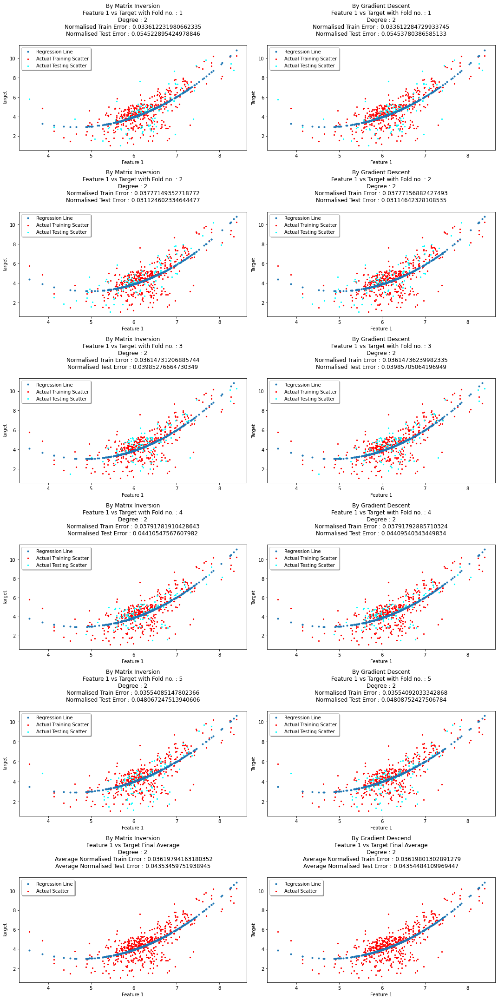



********************
Final Results :
Mean of Weights in k-Fold by Matrix Inversion Method : 
[[16.59841726]
 [-5.70205048]
 [ 0.59786993]]
Standard Deviation of Weights in k-Fold by Matrix Inversion Method : 
[[1.83733087]
 [0.58901727]
 [0.04633997]]
Mean of Weights in k-Fold by Gradient Descend Method : 
[[16.59844]
 [-5.70206]
 [ 0.59788]]
Standard Deviation of Weights in k-Fold by Gradient Descend Method : 
[[1.8373325 ]
 [0.58903344]
 [0.04631528]]
Mean of Normalised Train Error in k-Fold by Matrix Inversion : 0.03619794163180352
Standard Deviation of Normalised Train Error in k-Fold by Matrix Inversion : 0.0015845674053611373
Mean of Normalised Test Error in k-Fold by Matrix Inversion : 0.04353459751938945
Standard Deviation of Normalised Test Error in k-Fold by Matrix Inversion : 0.00786355349394801
Mean of Normalised Train Error in k-Fold by Gradient Descent : 0.03619801302891279
Standard Deviation of Normalised Train Error in k-Fold by Gradient Descent : 0.001584582937558310

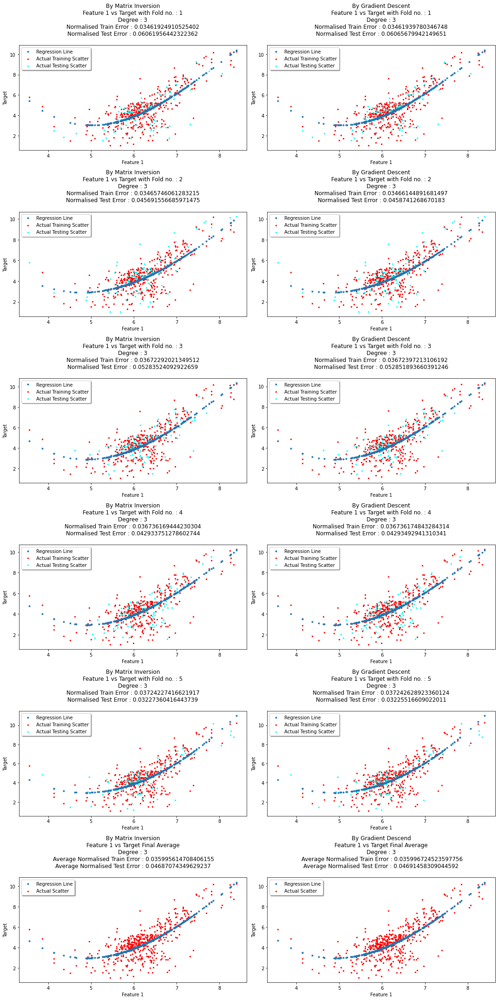



********************
Final Results :
Mean of Weights in k-Fold by Matrix Inversion Method : 
[[ 31.55525705]
 [-13.32527704]
 [  1.86656406]
 [ -0.06904349]]
Standard Deviation of Weights in k-Fold by Matrix Inversion Method : 
[[6.39317708]
 [3.13159508]
 [0.50663056]
 [0.0270585 ]]
Mean of Weights in k-Fold by Gradient Descend Method : 
[[ 31.55526]
 [-13.32526]
 [  1.86658]
 [ -0.06906]]
Standard Deviation of Weights in k-Fold by Gradient Descend Method : 
[[6.39318476]
 [3.13157777]
 [0.50662158]
 [0.02704682]]
Mean of Normalised Train Error in k-Fold by Matrix Inversion : 0.035995614708406155
Standard Deviation of Normalised Train Error in k-Fold by Matrix Inversion : 0.0011239744725998681
Mean of Normalised Test Error in k-Fold by Matrix Inversion : 0.04687074349629237
Standard Deviation of Normalised Test Error in k-Fold by Matrix Inversion : 0.009534906107955888
Mean of Normalised Train Error in k-Fold by Gradient Descent : 0.035996724523597756
Standard Deviation of Normalise

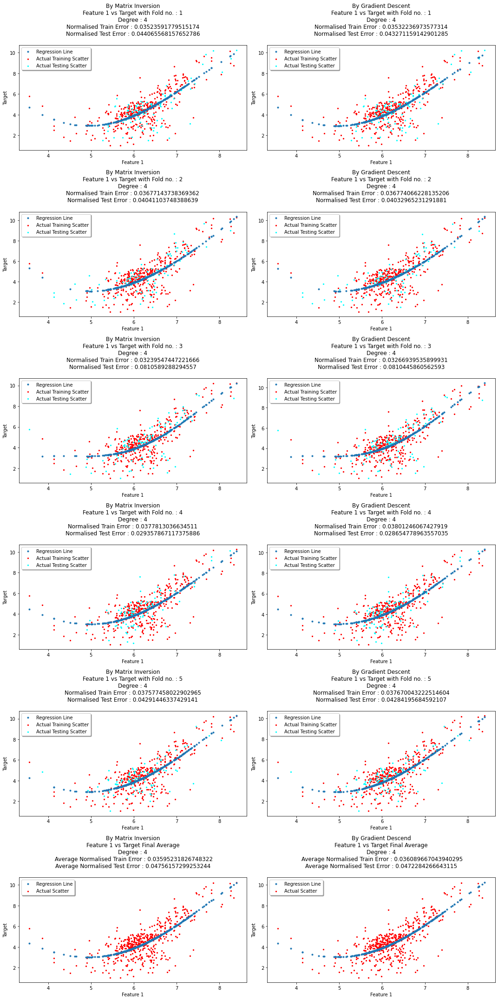



********************
Final Results :
Mean of Weights in k-Fold by Matrix Inversion Method : 
[[ 6.16332821]
 [ 4.34795186]
 [-2.65095692]
 [ 0.43472097]
 [-0.02071015]]
Standard Deviation of Weights in k-Fold by Matrix Inversion Method : 
[[3.14585883e+01]
 [2.04849309e+01]
 [4.91998635e+00]
 [5.17505967e-01]
 [2.01447691e-02]]
Mean of Weights in k-Fold by Gradient Descend Method : 
[[ 6.16332]
 [ 4.34794]
 [-2.65098]
 [ 0.43472]
 [-0.0207 ]]
Standard Deviation of Weights in k-Fold by Gradient Descend Method : 
[[3.14585835e+01]
 [2.04849450e+01]
 [4.91996362e+00]
 [5.17524003e-01]
 [2.01291828e-02]]
Mean of Normalised Train Error in k-Fold by Matrix Inversion : 0.03595231826748322
Standard Deviation of Normalised Train Error in k-Fold by Matrix Inversion : 0.001991059534546058
Mean of Normalised Test Error in k-Fold by Matrix Inversion : 0.04756157299253244
Standard Deviation of Normalised Test Error in k-Fold by Matrix Inversion : 0.017540784425586698
Mean of Normalised Train Error

In [12]:
def data_transform(X,degree,n=0): 
    X_new = np.ones(X.shape)
    for i in range(degree): X_new = np.concatenate((X_new,X**(i+1)))
    if(n==0) : X_new = np.delete(X_new, 0, 0)
    return X_new

wz1,wz2 = [],[]
feature1 = np.asarray(data[0]).reshape(1,487)

for degree in [1,2,3,4]:
    print("\n\nPolyFit For Degree : "+str(degree))
    feature1_t = data_transform(feature1,degree)
    feature1_t = np.column_stack((feature1_t.T, data[3]))
    feature1_t = pd.DataFrame(data = feature1_t)
    epoch = 1 if (degree>2) else 3
    w = k.kFCVEvaluate(dataset=feature1_t,extra=['Feature 1','r'],p=1,q=degree,epoch=epoch,scope=0.001,lr=0.00000000000001)
    y_pred1 = data_transform(feature1,degree,1).T @ w[0]
    y_pred2 = data_transform(feature1,degree,1).T @ w[1]
    if degree == 2 : 
        wz1.append(y_pred1)
        wz2.append(y_pred2)



PolyFit For Degree : 1


********************
Results of Parameters and Errors in K-Fold no. : 1
Weights by Matrix Inversion : 
[[ 6.7987651 ]
 [-0.17296877]]
Weights by Gradient Descent : 
[[ 6.7988]
 [-0.173 ]]
Normalized Train Error by Matrix Inversion : 0.03423743888668348
Normalized Test Error by Matrix Inversion : 0.04259593631237968
Normalized Train Error by Gradient Descent : 0.03423744472639641
Normalized Test Error by Gradient Descent : 0.04259083292445455
********************


********************
Results of Parameters and Errors in K-Fold no. : 2
Weights by Matrix Inversion : 
[[ 6.75181742]
 [-0.17103124]]
Weights by Gradient Descent : 
[[ 6.7518]
 [-0.171 ]]
Normalized Train Error by Matrix Inversion : 0.03771034699047936
Normalized Test Error by Matrix Inversion : 0.030490887376506293
Normalized Train Error by Gradient Descent : 0.03771035318290117
Normalized Test Error by Gradient Descent : 0.030494062240077682
********************


********************
Results of P

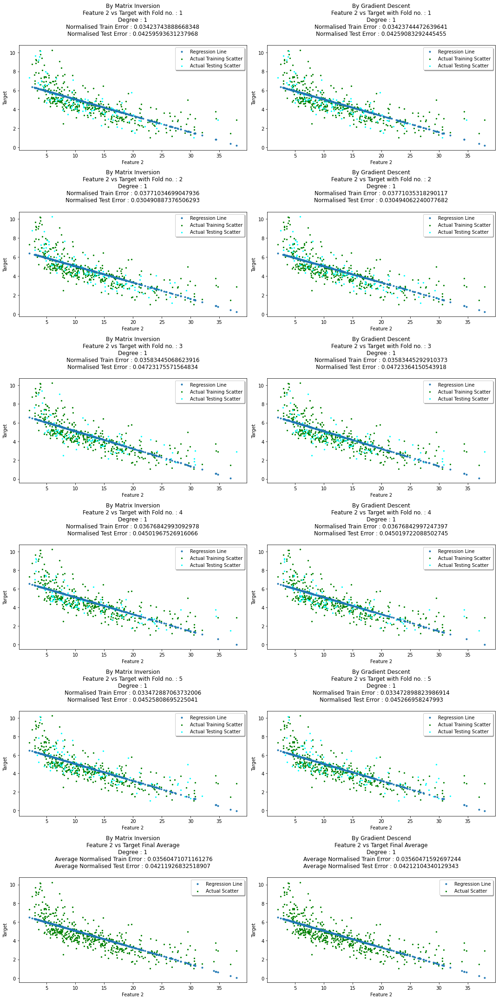



********************
Final Results :
Mean of Weights in k-Fold by Matrix Inversion Method : 
[[ 6.86049527]
 [-0.17910704]]
Standard Deviation of Weights in k-Fold by Matrix Inversion Method : 
[[0.0753997 ]
 [0.00594416]]
Mean of Weights in k-Fold by Gradient Descend Method : 
[[ 6.86052]
 [-0.17912]]
Standard Deviation of Weights in k-Fold by Gradient Descend Method : 
[[0.07541404]
 [0.00595698]]
Mean of Normalised Train Error in k-Fold by Matrix Inversion : 0.03560471071161276
Standard Deviation of Normalised Train Error in k-Fold by Matrix Inversion : 0.001565556215863064
Mean of Normalised Test Error in k-Fold by Matrix Inversion : 0.04211926832518907
Standard Deviation of Normalised Test Error in k-Fold by Matrix Inversion : 0.00599747490181546
Mean of Normalised Train Error in k-Fold by Gradient Descent : 0.03560471592697244
Standard Deviation of Normalised Train Error in k-Fold by Gradient Descent : 0.0015655537307871037
Mean of Normalised Test Error in k-Fold by Gradient De

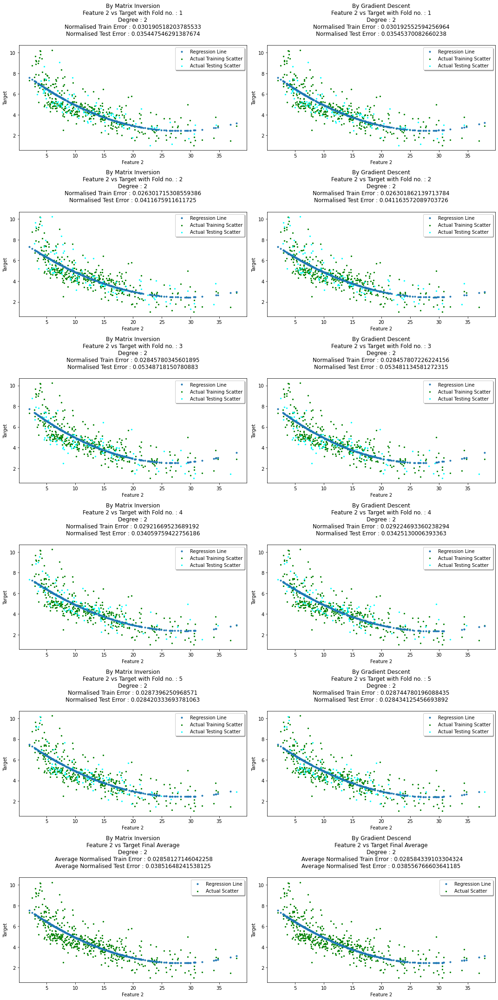



********************
Final Results :
Mean of Weights in k-Fold by Matrix Inversion Method : 
[[ 8.31559573e+00]
 [-4.14600741e-01]
 [ 7.33169497e-03]]
Standard Deviation of Weights in k-Fold by Matrix Inversion Method : 
[[0.17744267]
 [0.02067324]
 [0.00056302]]
Mean of Weights in k-Fold by Gradient Descend Method : 
[[ 8.31562e+00]
 [-4.14600e-01]
 [ 7.32000e-03]]
Standard Deviation of Weights in k-Fold by Gradient Descend Method : 
[[0.17743861]
 [0.02068961]
 [0.00057411]]
Mean of Normalised Train Error in k-Fold by Matrix Inversion : 0.02858127146042258
Standard Deviation of Normalised Train Error in k-Fold by Matrix Inversion : 0.00128297583208006
Mean of Normalised Test Error in k-Fold by Matrix Inversion : 0.03851648241538125
Standard Deviation of Normalised Test Error in k-Fold by Matrix Inversion : 0.008513086122821001
Mean of Normalised Train Error in k-Fold by Gradient Descent : 0.028584339103304324
Standard Deviation of Normalised Train Error in k-Fold by Gradient Descen

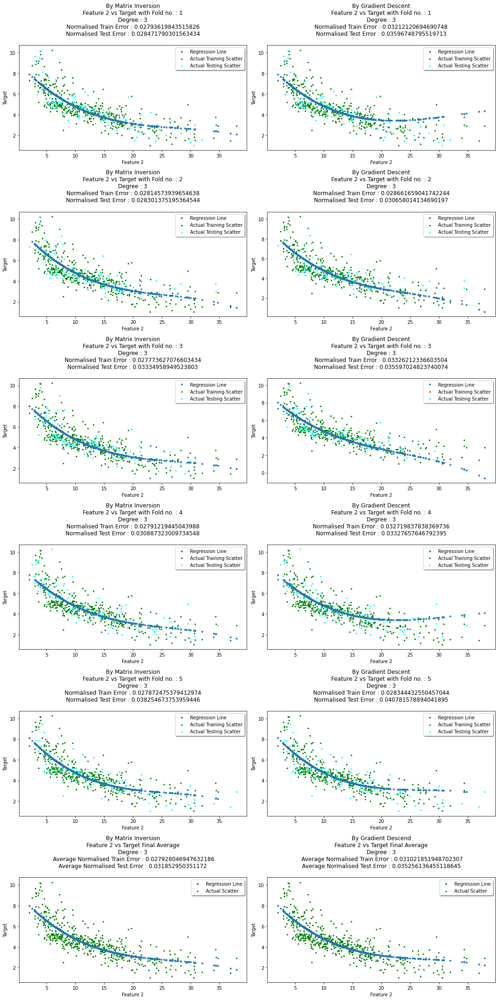



********************
Final Results :
Mean of Weights in k-Fold by Matrix Inversion Method : 
[[ 9.13884719e+00]
 [-6.24366071e-01]
 [ 2.14828026e-02]
 [-2.66995821e-04]]
Standard Deviation of Weights in k-Fold by Matrix Inversion Method : 
[[1.78448008e-01]
 [3.24933383e-02]
 [1.74107985e-03]
 [2.81456716e-05]]
Mean of Weights in k-Fold by Gradient Descend Method : 
[[ 9.1388400e+00]
 [-6.2434000e-01]
 [ 2.1520000e-02]
 [-2.6000001e-04]]
Standard Deviation of Weights in k-Fold by Gradient Descend Method : 
[[1.78444116e-01]
 [3.24959444e-02]
 [1.74287119e-03]
 [4.89897490e-05]]
Mean of Normalised Train Error in k-Fold by Matrix Inversion : 0.027928046947632186
Standard Deviation of Normalised Train Error in k-Fold by Matrix Inversion : 0.0001221813786902546
Mean of Normalised Test Error in k-Fold by Matrix Inversion : 0.031852950351172
Standard Deviation of Normalised Test Error in k-Fold by Matrix Inversion : 0.0036932467229876887
Mean of Normalised Train Error in k-Fold by Gradient

In [13]:
feature1 = np.asarray(data[1]).reshape(1,487)

for degree in [1,2,3]:
    print("\n\nPolyFit For Degree : "+str(degree))
    feature1_t = data_transform(feature1,degree)
    feature1_t = np.column_stack((feature1_t.T, data[3]))
    feature1_t = pd.DataFrame(data = feature1_t)
    epoch = 1 if (degree>2) else 3
    w = k.kFCVEvaluate(dataset=feature1_t,extra=['Feature 2','g'],p=1,q=degree,epoch=epoch,scope=0.001,lr=0.00000000000001)
    y_pred1 = data_transform(feature1,degree,1).T @ w[0]
    y_pred2 = data_transform(feature1,degree,1).T @ w[1]
    if degree == 2 : 
        wz1.append(y_pred1)
        wz2.append(y_pred2)



PolyFit For Degree : 1


********************
Results of Parameters and Errors in K-Fold no. : 1
Weights by Matrix Inversion : 
[[11.68434306]
 [-0.38446125]]
Weights by Gradient Descent : 
[[11.6843]
 [-0.3845]]
Normalized Train Error by Matrix Inversion : 0.06357165820480566
Normalized Test Error by Matrix Inversion : 0.07118000826126807
Normalized Train Error by Gradient Descent : 0.06357167630751956
Normalized Test Error by Gradient Descent : 0.07117261465188429
********************


********************
Results of Parameters and Errors in K-Fold no. : 2
Weights by Matrix Inversion : 
[[12.89196621]
 [-0.44907972]]
Weights by Gradient Descent : 
[[12.892 ]
 [-0.4491]]
Normalized Train Error by Matrix Inversion : 0.061384947842501224
Normalized Test Error by Matrix Inversion : 0.09455992519536394
Normalized Train Error by Gradient Descent : 0.06138495151820563
Normalized Test Error by Gradient Descent : 0.09455693416982598
********************


********************
Results of Pa

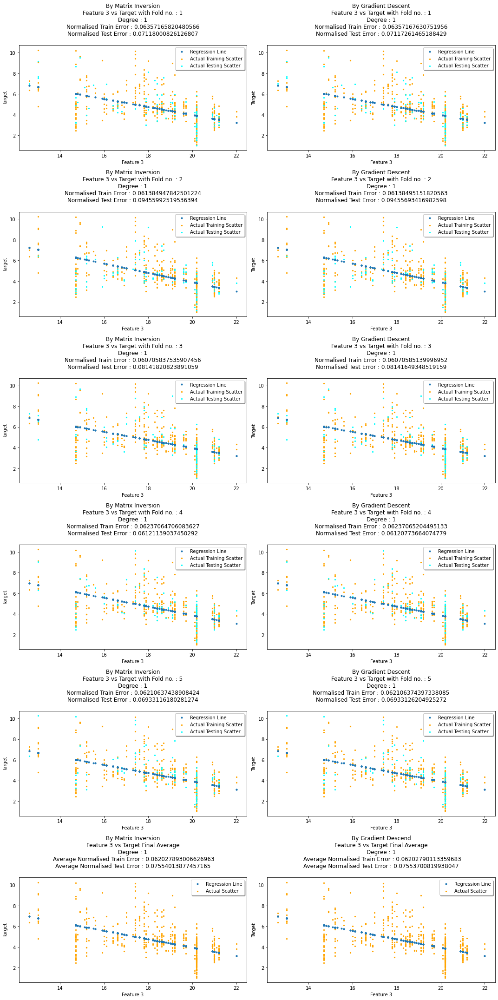



********************
Final Results :
Mean of Weights in k-Fold by Matrix Inversion Method : 
[[12.08834203]
 [-0.40730517]]
Standard Deviation of Weights in k-Fold by Matrix Inversion Method : 
[[0.44660495]
 [0.02370316]]
Mean of Weights in k-Fold by Gradient Descend Method : 
[[12.08834]
 [-0.40732]]
Standard Deviation of Weights in k-Fold by Gradient Descend Method : 
[[0.44663246]
 [0.02369645]]
Mean of Normalised Train Error in k-Fold by Matrix Inversion : 0.062027893006626963
Standard Deviation of Normalised Train Error in k-Fold by Matrix Inversion : 0.0009662359761372051
Mean of Normalised Test Error in k-Fold by Matrix Inversion : 0.07554013877457165
Standard Deviation of Normalised Test Error in k-Fold by Matrix Inversion : 0.011481978400619767
Mean of Normalised Train Error in k-Fold by Gradient Descent : 0.06202790113359683
Standard Deviation of Normalised Train Error in k-Fold by Gradient Descent : 0.0009662378313947792
Mean of Normalised Test Error in k-Fold by Gradient

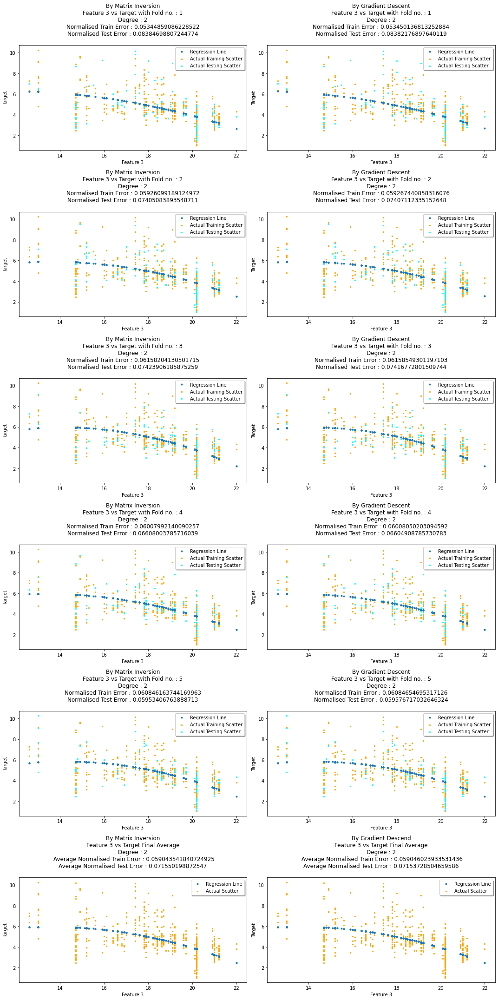



********************
Final Results :
Mean of Weights in k-Fold by Matrix Inversion Method : 
[[-2.97490151]
 [ 1.31843443]
 [-0.04866336]]
Standard Deviation of Weights in k-Fold by Matrix Inversion Method : 
[[2.89358677]
 [0.3358034 ]
 [0.0095623 ]]
Mean of Weights in k-Fold by Gradient Descend Method : 
[[-2.97492]
 [ 1.31842]
 [-0.04864]]
Standard Deviation of Weights in k-Fold by Gradient Descend Method : 
[[2.89359934]
 [0.33580517]
 [0.00956151]]
Mean of Normalised Train Error in k-Fold by Matrix Inversion : 0.059043541840724925
Standard Deviation of Normalised Train Error in k-Fold by Matrix Inversion : 0.0029023531427227246
Mean of Normalised Test Error in k-Fold by Matrix Inversion : 0.071550198872547
Standard Deviation of Normalised Test Error in k-Fold by Matrix Inversion : 0.008234127529599658
Mean of Normalised Train Error in k-Fold by Gradient Descent : 0.059046023933531436
Standard Deviation of Normalised Train Error in k-Fold by Gradient Descent : 0.00290254748095925

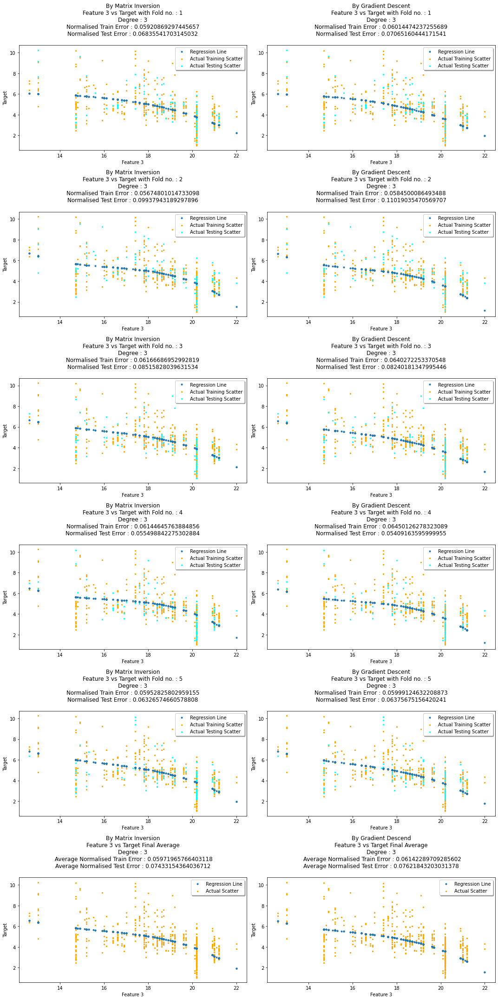



********************
Final Results :
Mean of Weights in k-Fold by Matrix Inversion Method : 
[[ 4.91730915e+01]
 [-7.88396610e+00]
 [ 4.86599684e-01]
 [-1.02674117e-02]]
Standard Deviation of Weights in k-Fold by Matrix Inversion Method : 
[[2.16186447e+01]
 [3.86430617e+00]
 [2.26872409e-01]
 [4.38040211e-03]]
Mean of Weights in k-Fold by Gradient Descend Method : 
[[ 4.91731e+01]
 [-7.88396e+00]
 [ 4.86600e-01]
 [-1.03000e-02]]
Standard Deviation of Weights in k-Fold by Gradient Descend Method : 
[[2.16186404e+01]
 [3.86429139e+00]
 [2.26845912e-01]
 [4.38497434e-03]]
Mean of Normalised Train Error in k-Fold by Matrix Inversion : 0.05971965766403118
Standard Deviation of Normalised Train Error in k-Fold by Matrix Inversion : 0.0017833608665262103
Mean of Normalised Test Error in k-Fold by Matrix Inversion : 0.07433154364036712
Standard Deviation of Normalised Test Error in k-Fold by Matrix Inversion : 0.015858445880097608
Mean of Normalised Train Error in k-Fold by Gradient Descent

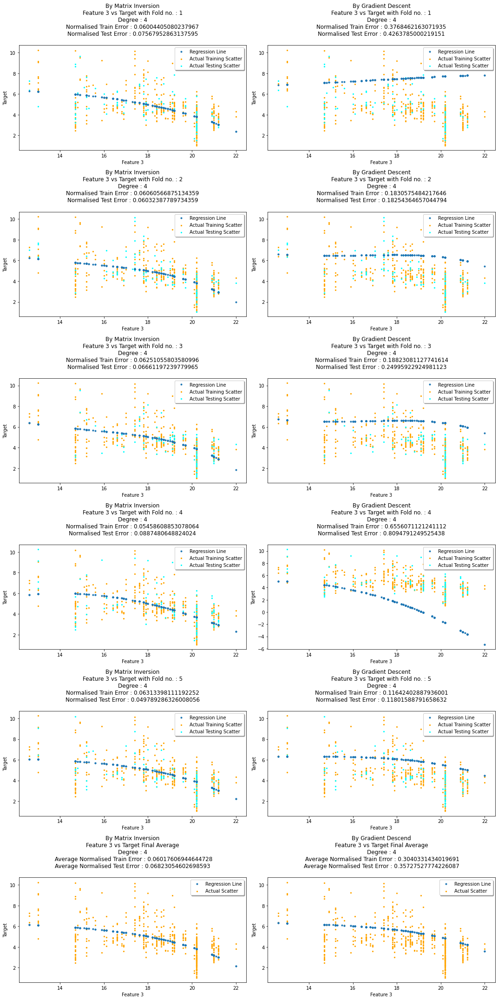



********************
Final Results :
Mean of Weights in k-Fold by Matrix Inversion Method : 
[[ 4.50012187e-01]
 [ 1.87180799e+00]
 [-2.16786881e-01]
 [ 1.11186137e-02]
 [-2.26026472e-04]]
Standard Deviation of Weights in k-Fold by Matrix Inversion Method : 
[[2.74389126e-01]
 [1.13125854e+00]
 [2.04802534e-01]
 [1.19392825e-02]
 [2.27731286e-04]]
Mean of Weights in k-Fold by Gradient Descend Method : 
[[ 4.50020000e-01]
 [ 1.87184000e+00]
 [-2.16800000e-01]
 [ 1.11199999e-02]
 [-2.20002299e-04]]
Standard Deviation of Weights in k-Fold by Gradient Descend Method : 
[[2.74393137e-01]
 [1.13125433e+00]
 [2.04800322e-01]
 [1.19333815e-02]
 [2.13546330e-04]]
Mean of Normalised Train Error in k-Fold by Matrix Inversion : 0.06017606944644728
Standard Deviation of Normalised Train Error in k-Fold by Matrix Inversion : 0.003021554219843991
Mean of Normalised Test Error in k-Fold by Matrix Inversion : 0.06823054602698593
Standard Deviation of Normalised Test Error in k-Fold by Matrix Inversio

In [14]:
feature1 = np.asarray(data[2]).reshape(1,487)

for degree in [1,2,3,4]:
    print("\n\nPolyFit For Degree : "+str(degree))
    feature1_t = data_transform(feature1,degree)
    feature1_t = np.column_stack((feature1_t.T, data[3]))
    feature1_t = pd.DataFrame(data = feature1_t)
    epoch = 1 if (degree>2) else 3
    w = k.kFCVEvaluate(dataset=feature1_t,extra=['Feature 3','orange'],p=1,q=degree,epoch=epoch,scope=0.001,lr=0.00000000000001)
    y_pred1 = data_transform(feature1,degree,1).T @ w[0]
    y_pred2 = data_transform(feature1,degree,1).T @ w[1]
    if degree == 1 : 
        wz1.append(y_pred1)
        wz2.append(y_pred2)

<h2><strong> A. Best results of Regression</strong></h2>

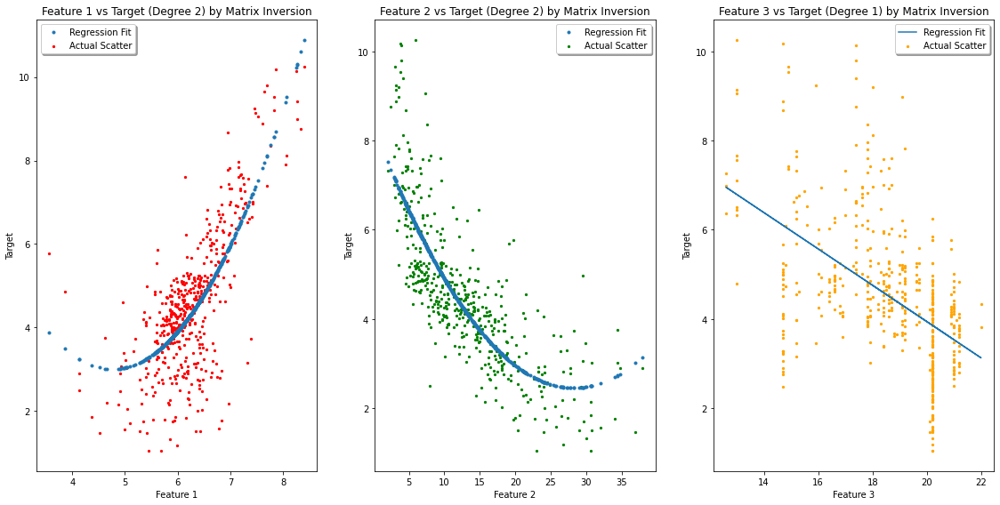

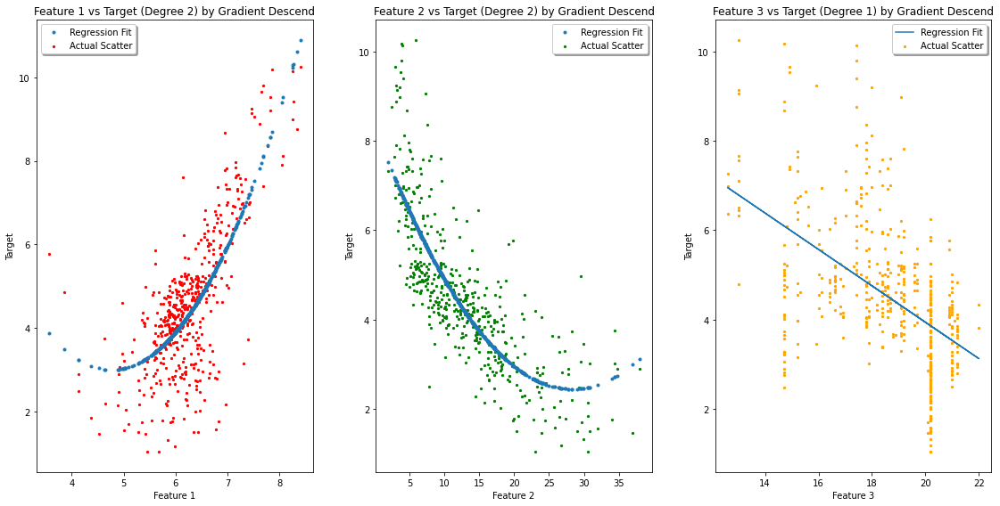

In [15]:
for i,val in enumerate(['Matrix Inversion','Gradient Descend']): 
    w = wz1 if (i==0) else wz2

    fig, (ax1, ax2, ax3) = plt.subplots(figsize=(16, 8),nrows = 1, ncols = 3)

    ax1.scatter(data[0], data[3],s=5,c='r',label="Actual Scatter")
    ax1.plot(data[0], w[0],'.',label="Regression Fit")
    ax1.set_title('Feature 1 vs Target (Degree 2) by '+str(val))
    ax1.set(xlabel='Feature 1', ylabel='Target')
    ax1.legend(shadow=True, fancybox=True)

    ax2.scatter(data[1], data[3],s=5,c='g',label="Actual Scatter")
    ax2.plot(data[1], w[1],'.',label="Regression Fit")
    ax2.set_title('Feature 2 vs Target (Degree 2) by '+str(val))
    ax2.set(xlabel='Feature 2', ylabel='Target')
    ax2.legend(shadow=True, fancybox=True)

    ax3.scatter(data[2], data[3],s=5,c='orange',label="Actual Scatter")
    ax3.plot(data[2], w[2],label="Regression Fit")
    ax3.set_title('Feature 3 vs Target (Degree 1) by '+str(val))
    ax3.set(xlabel='Feature 3', ylabel='Target')
    ax3.legend(shadow=True, fancybox=True)

    fig.tight_layout()
    plt.show()

<h3><strong> A. Handwritten Notes</strong></h3>

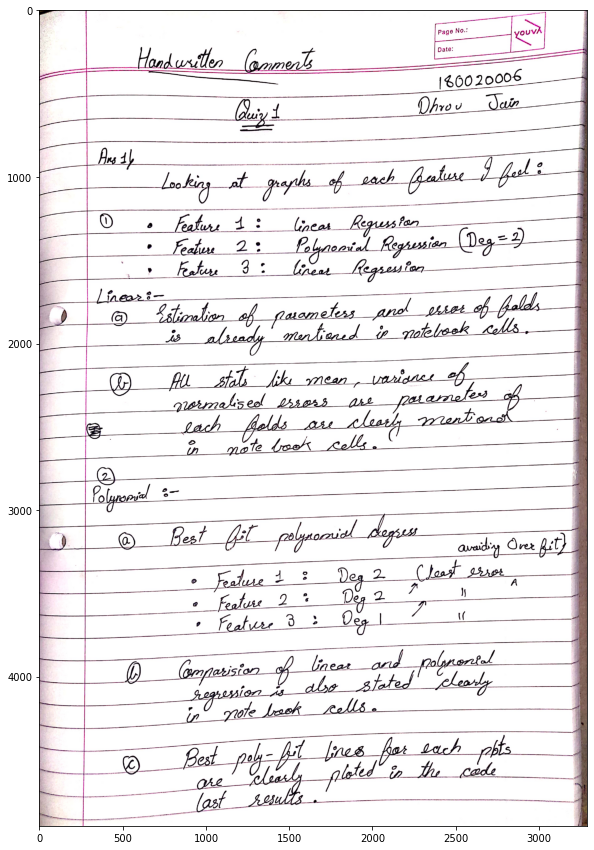

In [16]:
im = cv2.imread('Page1.jpg')
plt.figure(figsize=(30,15))
plt.imshow(cv2.cvtColor(im, cv2.COLOR_BGR2RGB))
plt.show()

<h1><strong> Question 2</strong></h1>
<h2><strong> B. Bivariate Linear Regression</strong></h2>

<h3><strong> B. Handwritten Notes</strong></h3>

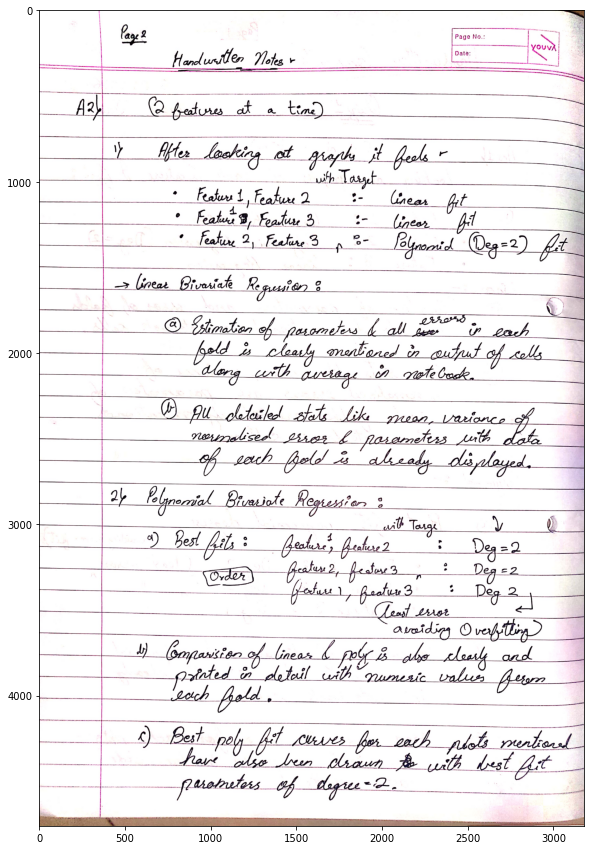

In [17]:
im = cv2.imread('Page2.jpg')
plt.figure(figsize=(30,15))
plt.imshow(cv2.cvtColor(im, cv2.COLOR_BGR2RGB))
plt.show()



********************
Results of Parameters and Errors in K-Fold no. : 1
Weights by Matrix Inversion : 
[[ 0.86390099]
 [ 0.85026741]
 [-0.12907691]]
Weights by Gradient Descent : 
[[ 0.8639002 ]
 [ 0.85030112]
 [-0.1290949 ]]
Normalized Train Error by Matrix Inversion : 0.027253404685738634
Normalized Test Error by Matrix Inversion : 0.04617235585072024
Normalized Train Error by Gradient Descent : 0.027253405289489455
Normalized Test Error by Gradient Descent : 0.046171843037337595
********************


********************
Results of Parameters and Errors in K-Fold no. : 2
Weights by Matrix Inversion : 
[[ 0.89544858]
 [ 0.85812557]
 [-0.13191754]]
Weights by Gradient Descent : 
[[ 0.89539995]
 [ 0.85809984]
 [-0.13190256]]
Normalized Train Error by Matrix Inversion : 0.028299836019498453
Normalized Test Error by Matrix Inversion : 0.030502246390873625
Normalized Train Error by Gradient Descent : 0.028299836459464316
Normalized Test Error by Gradient Descent : 0.030501914068005526


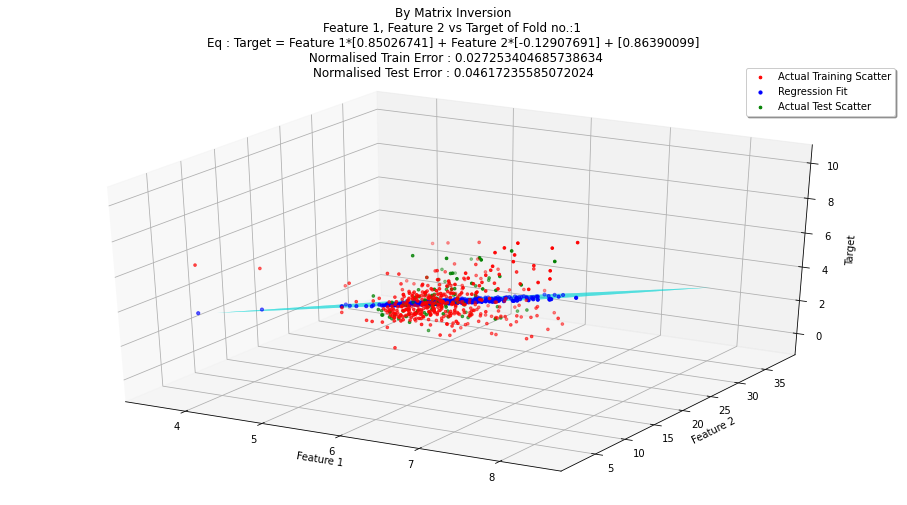

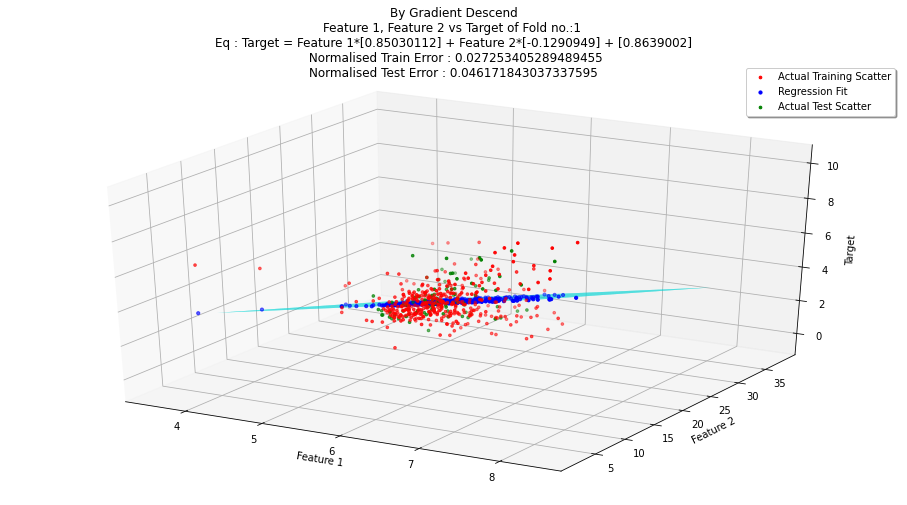

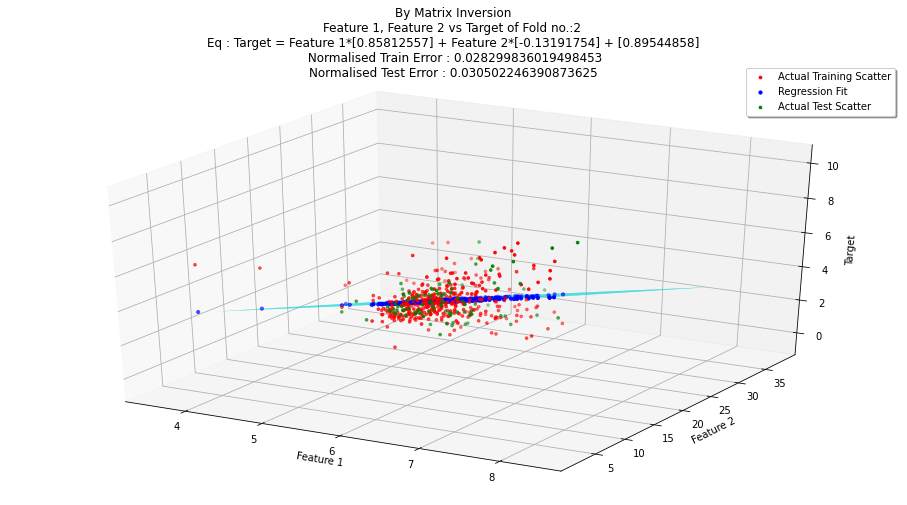

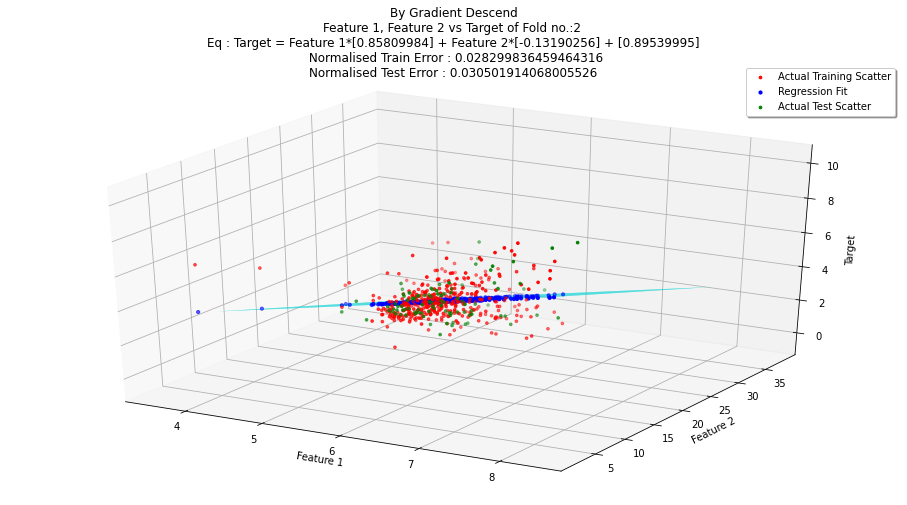

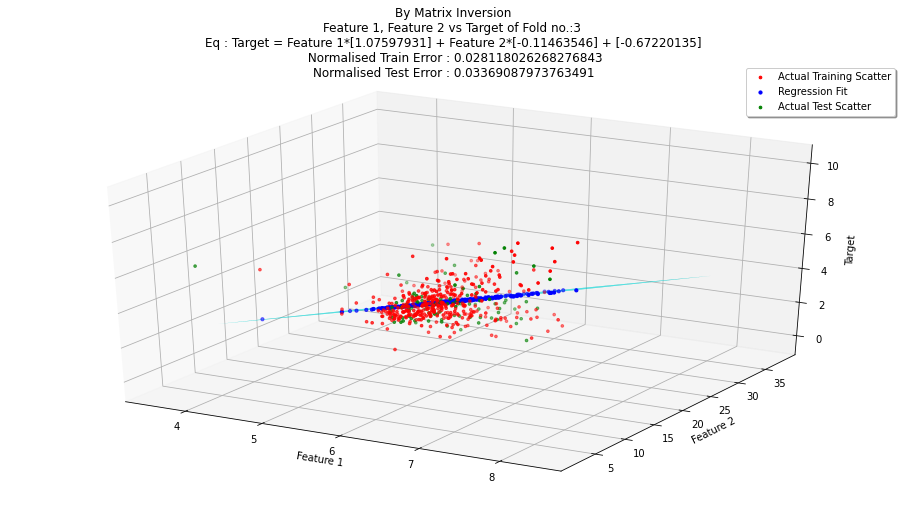

...

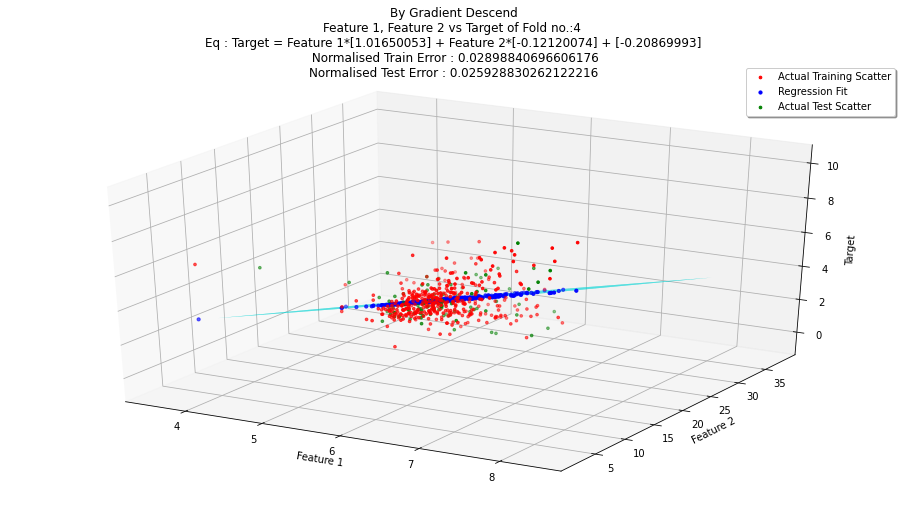

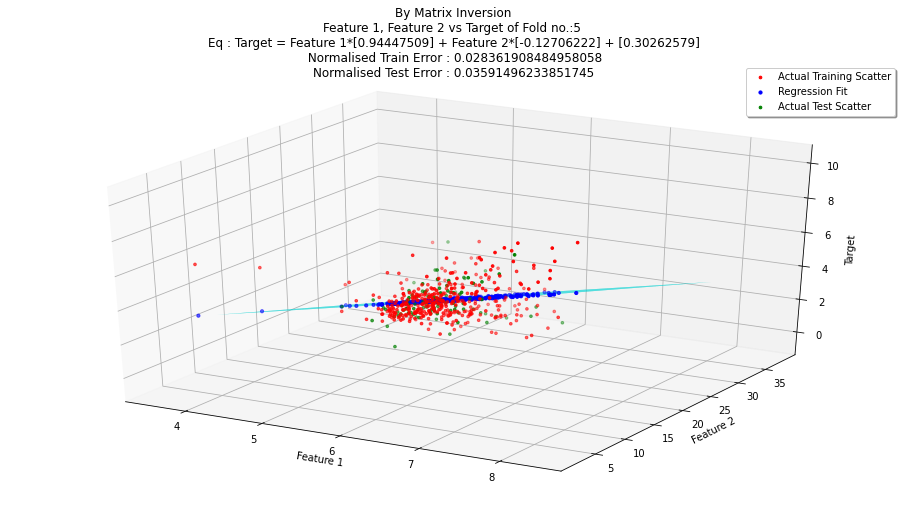

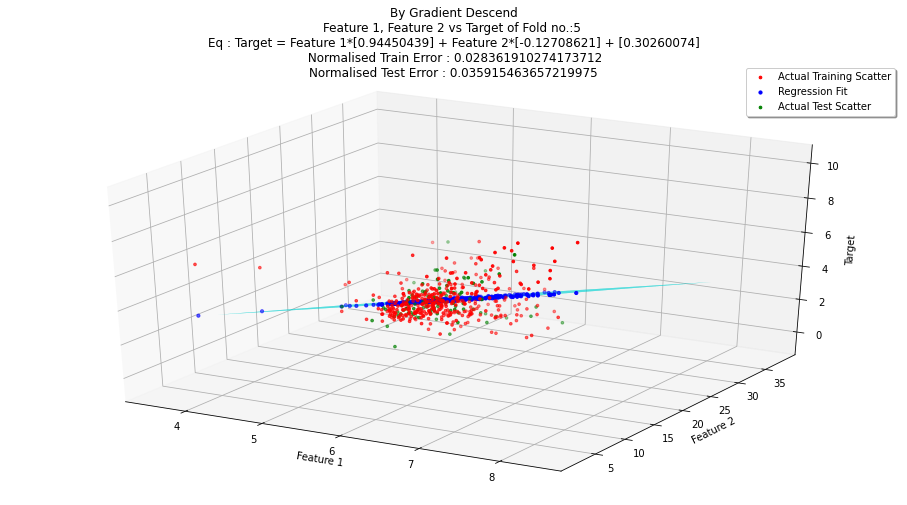

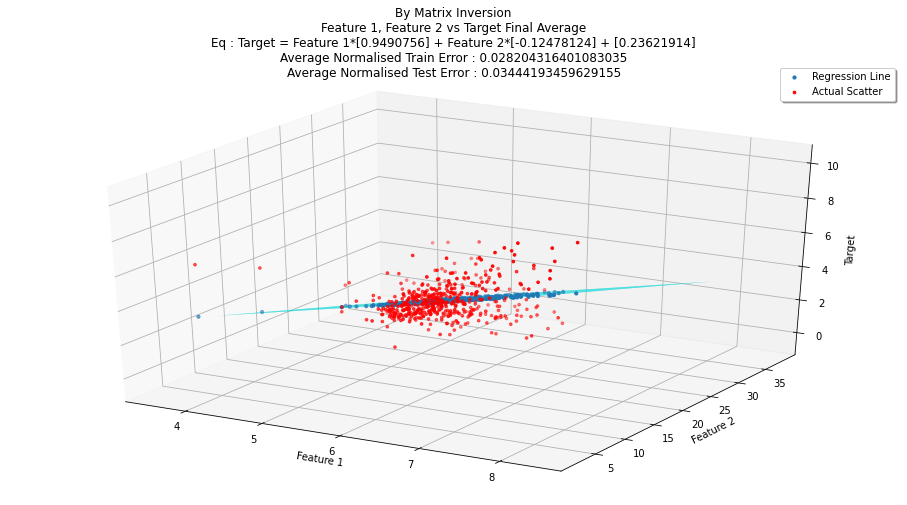

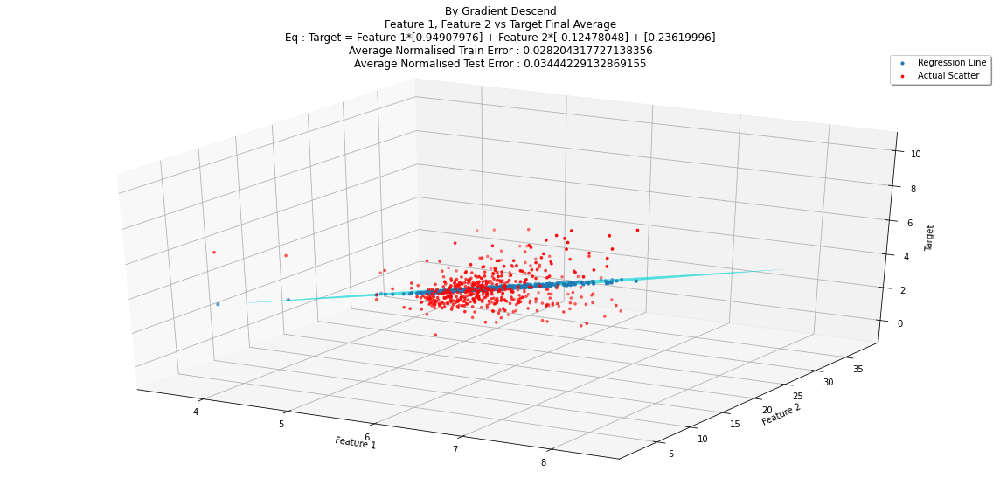



********************
Final Results :
Mean of Weights in k-Fold by Matrix Inversion Method : 
[[ 0.23621914]
 [ 0.9490756 ]
 [-0.12478124]]
Standard Deviation of Weights in k-Fold by Matrix Inversion Method : 
[[0.60928471]
 [0.08798961]
 [0.00616837]]
Mean of Weights in k-Fold by Gradient Descend Method : 
[[ 0.23619996]
 [ 0.94907976]
 [-0.12478048]]
Standard Deviation of Weights in k-Fold by Gradient Descend Method : 
[[0.60927659]
 [0.08798638]
 [0.00617649]]
Mean of Normalised Train Error in k-Fold by Matrix Inversion : 0.028204316401083035
Standard Deviation of Normalised Train Error in k-Fold by Matrix Inversion : 0.0005586475985156026
Mean of Normalised Test Error in k-Fold by Matrix Inversion : 0.03444193459629155
Standard Deviation of Normalised Test Error in k-Fold by Matrix Inversion : 0.006757573268369696
Mean of Normalised Train Error in k-Fold by Gradient Descent : 0.028204317727138356
Standard Deviation of Normalised Train Error in k-Fold by Gradient Descent : 0.000558

In [18]:
dataset1 = data[[0,1,3]]
average_weights1 = k.kFCVEvaluate(dataset=dataset1,extra=['Feature 1','Feature 2'],p=2)



********************
Results of Parameters and Errors in K-Fold no. : 1
Weights by Matrix Inversion : 
[[-0.74684348]
 [ 1.63210924]
 [-0.26678853]]
Weights by Gradient Descent : 
[[-0.74679955]
 [ 1.63210284]
 [-0.26679146]]
Normalized Train Error by Matrix Inversion : 0.03243121188509176
Normalized Test Error by Matrix Inversion : 0.05651923890720775
Normalized Train Error by Gradient Descent : 0.03243121196313698
Normalized Test Error by Gradient Descent : 0.056520201251606554
********************


********************
Results of Parameters and Errors in K-Fold no. : 2
Weights by Matrix Inversion : 
[[ 0.8031523 ]
 [ 1.44604844]
 [-0.28623167]]
Weights by Gradient Descent : 
[[ 0.80319933]
 [ 1.4459959 ]
 [-0.28621275]]
Normalized Train Error by Matrix Inversion : 0.035237882919112166
Normalized Test Error by Matrix Inversion : 0.03346611741767919
Normalized Train Error by Gradient Descent : 0.035237883184302723
Normalized Test Error by Gradient Descent : 0.03346575644829383
****

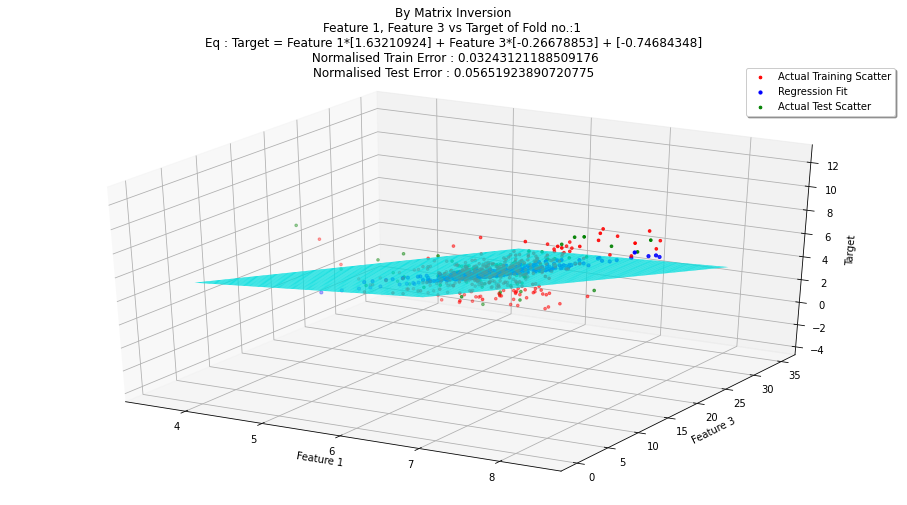

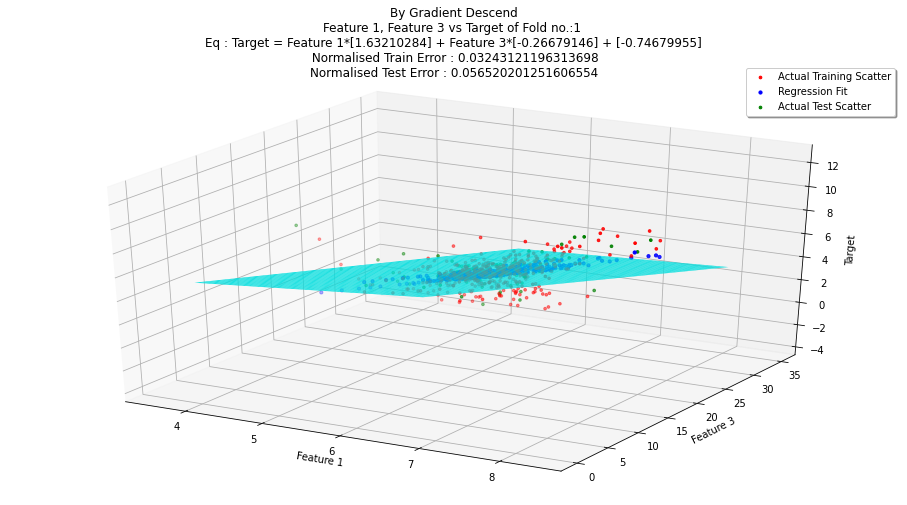

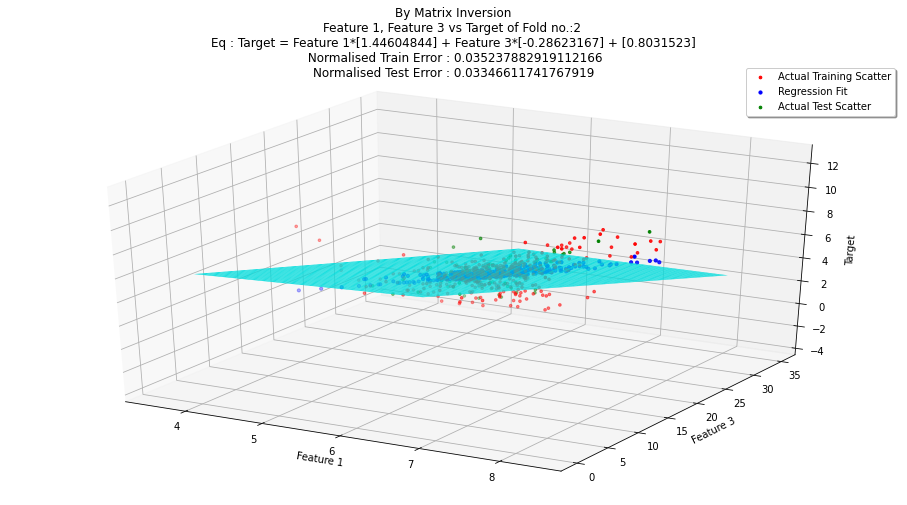

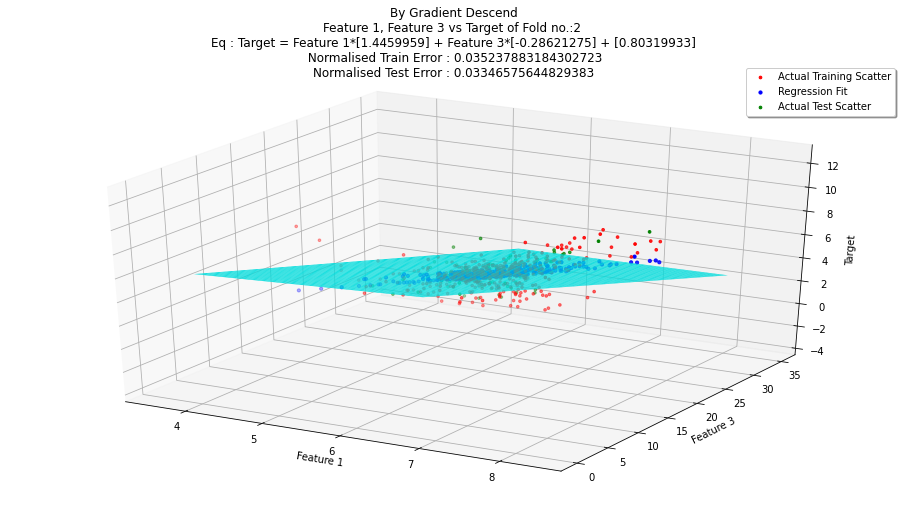

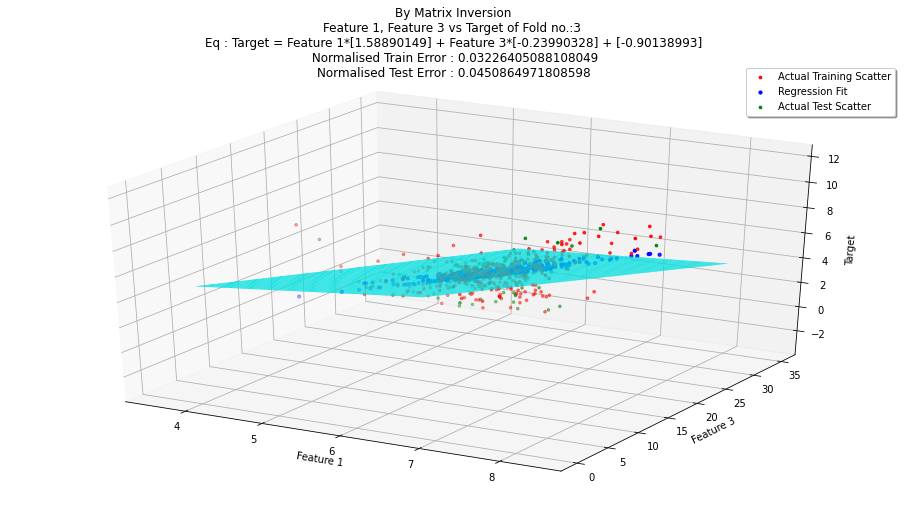

...

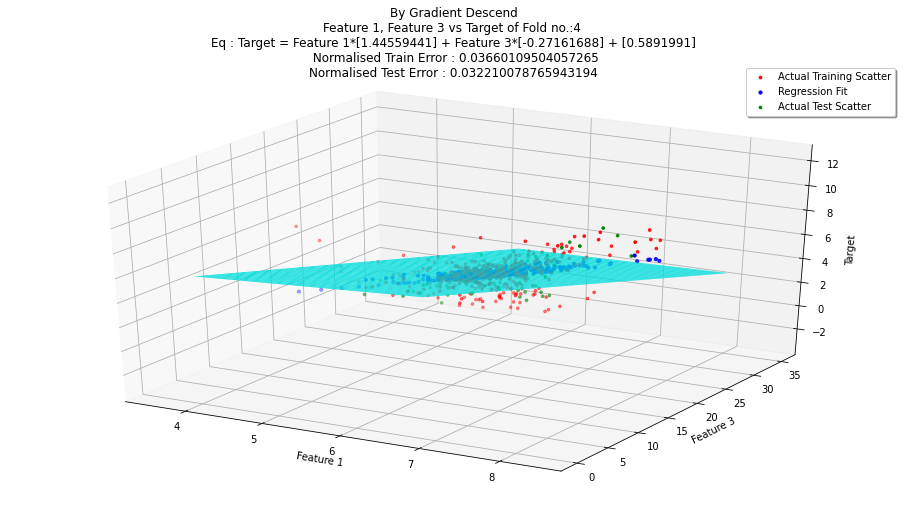

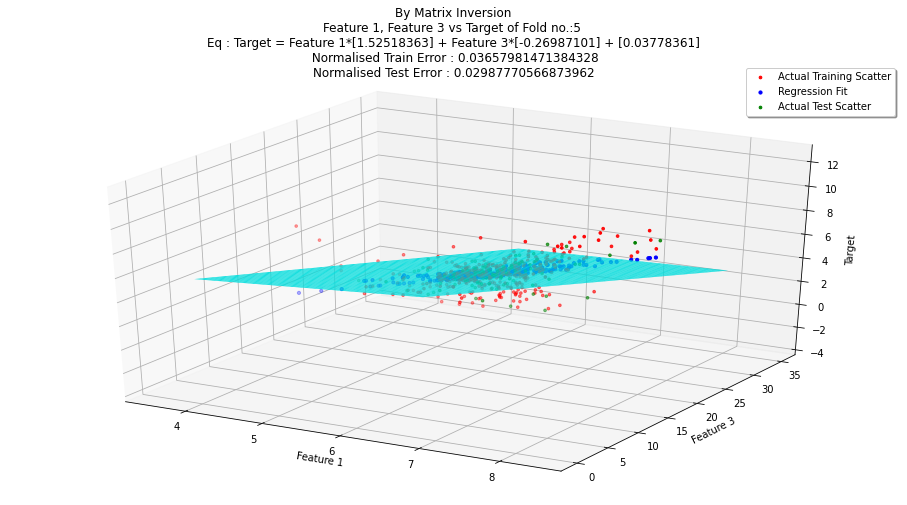

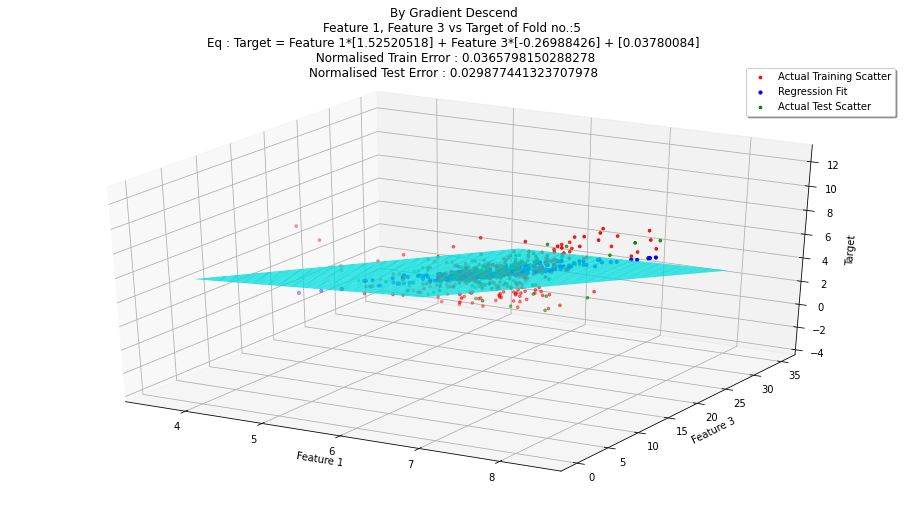

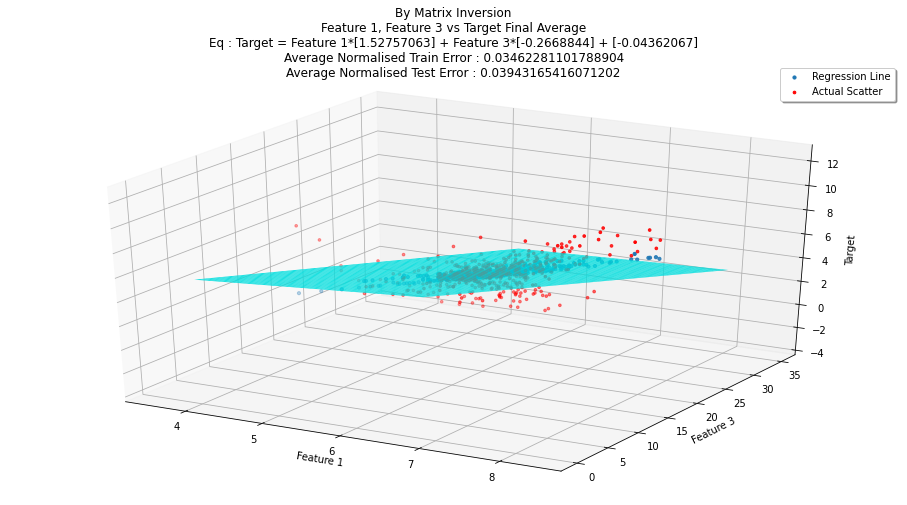

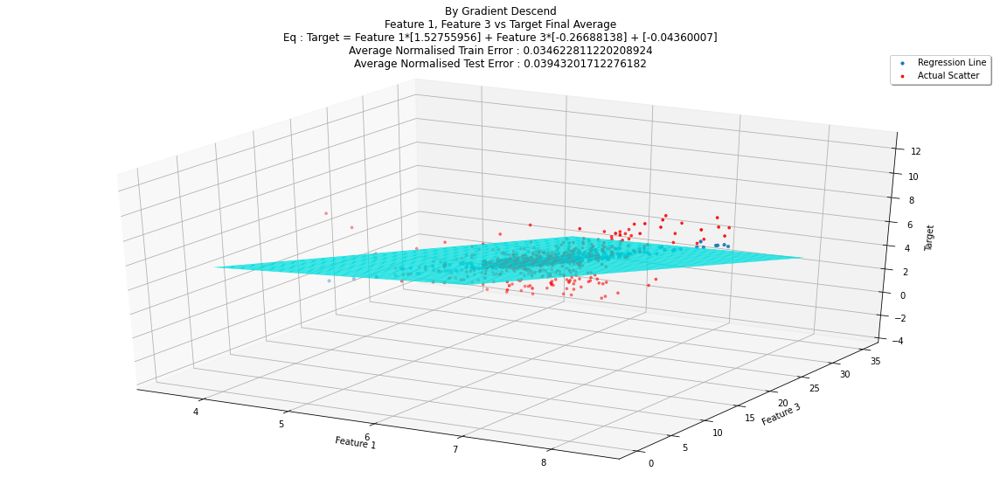



********************
Final Results :
Mean of Weights in k-Fold by Matrix Inversion Method : 
[[-0.04362067]
 [ 1.52757063]
 [-0.2668844 ]]
Standard Deviation of Weights in k-Fold by Matrix Inversion Method : 
[[0.6862064 ]
 [0.07491175]
 [0.01505805]]
Mean of Weights in k-Fold by Gradient Descend Method : 
[[-0.04360007]
 [ 1.52755956]
 [-0.26688138]]
Standard Deviation of Weights in k-Fold by Gradient Descend Method : 
[[0.68621287]
 [0.07492442]
 [0.01505365]]
Mean of Normalised Train Error in k-Fold by Matrix Inversion : 0.03462281101788904
Standard Deviation of Normalised Train Error in k-Fold by Matrix Inversion : 0.0019229477028835042
Mean of Normalised Test Error in k-Fold by Matrix Inversion : 0.03943165416071202
Standard Deviation of Normalised Test Error in k-Fold by Matrix Inversion : 0.010029947769418082
Mean of Normalised Train Error in k-Fold by Gradient Descent : 0.034622811220208924
Standard Deviation of Normalised Train Error in k-Fold by Gradient Descent : 0.0019229

In [19]:
dataset2 = data[[0,2,3]]
average_weights2 = k.kFCVEvaluate(dataset=dataset2,extra=['Feature 1','Feature 3'],p=2)



********************
Results of Parameters and Errors in K-Fold no. : 1
Weights by Matrix Inversion : 
[[11.18290262]
 [-0.15171699]
 [-0.25113459]]
Weights by Gradient Descent : 
[[11.18289826]
 [-0.15172522]
 [-0.25113275]]
Normalized Train Error by Matrix Inversion : 0.02720015152504357
Normalized Test Error by Matrix Inversion : 0.043652532110362276
Normalized Train Error by Gradient Descent : 0.027200151822825466
Normalized Test Error by Gradient Descent : 0.04365200112396015
********************


********************
Results of Parameters and Errors in K-Fold no. : 2
Weights by Matrix Inversion : 
[[10.48064284]
 [-0.15419664]
 [-0.21216704]]
Weights by Gradient Descent : 
[[10.48060139]
 [-0.15418117]
 [-0.21217395]]
Normalized Train Error by Matrix Inversion : 0.028717243560148497
Normalized Test Error by Matrix Inversion : 0.039167784770167795
Normalized Train Error by Gradient Descent : 0.028717243949949147
Normalized Test Error by Gradient Descent : 0.039168060210960434
*

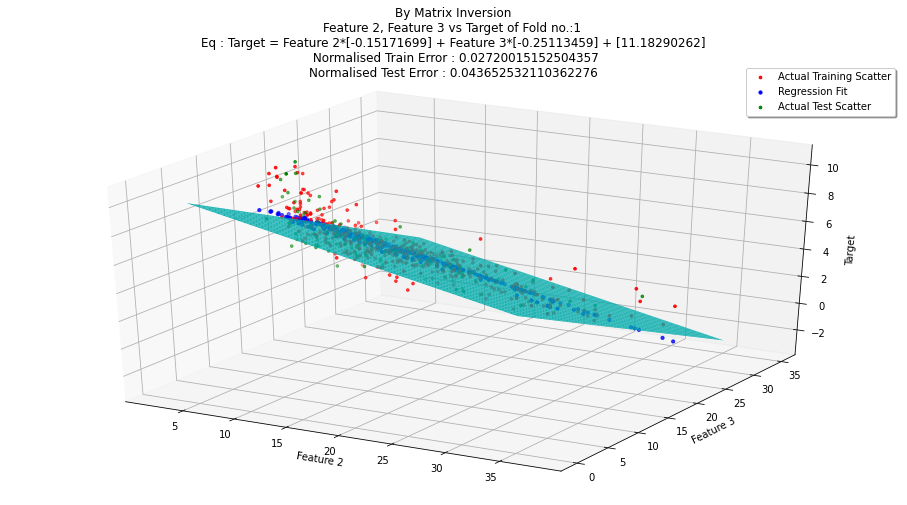

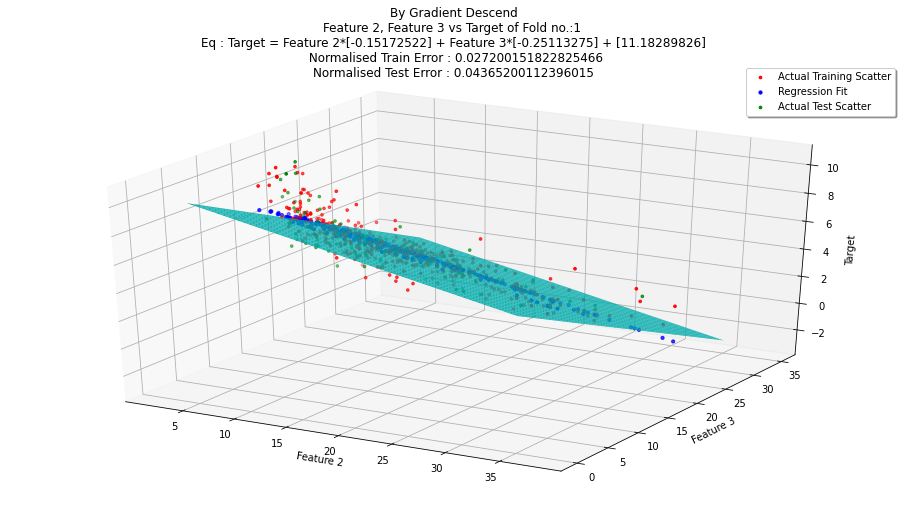

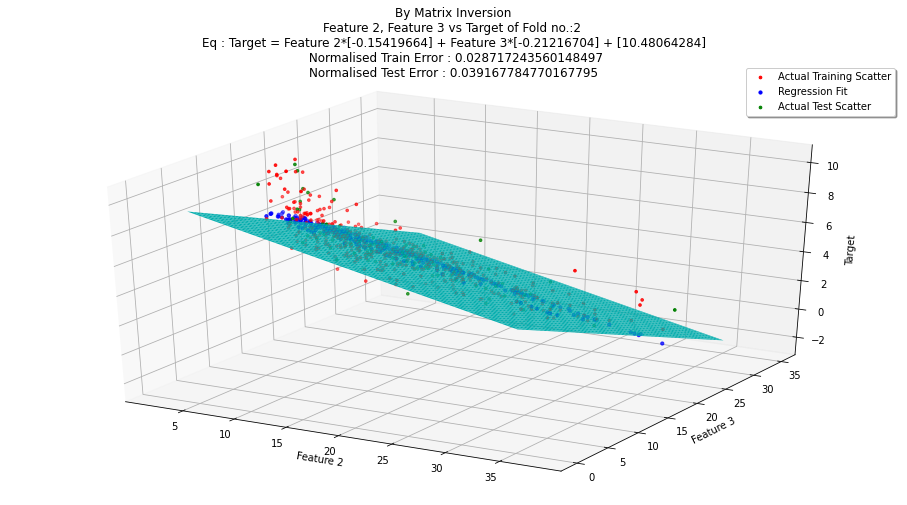

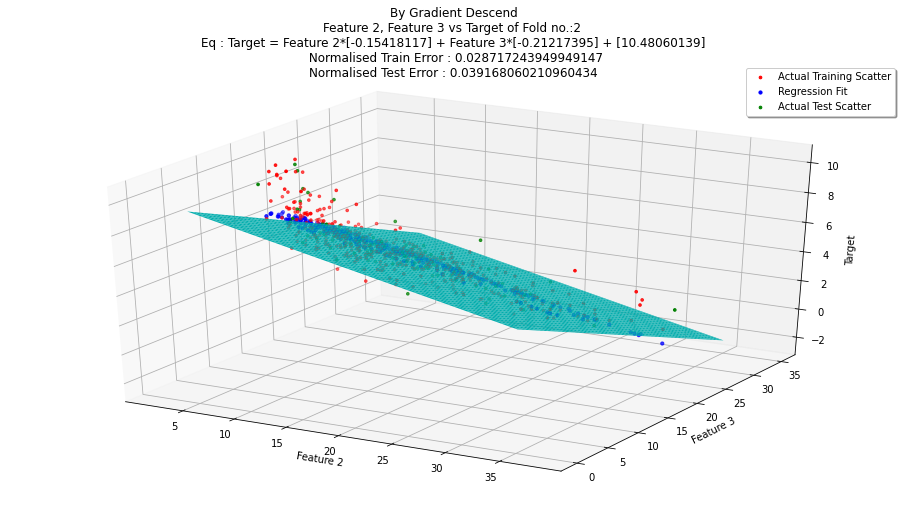

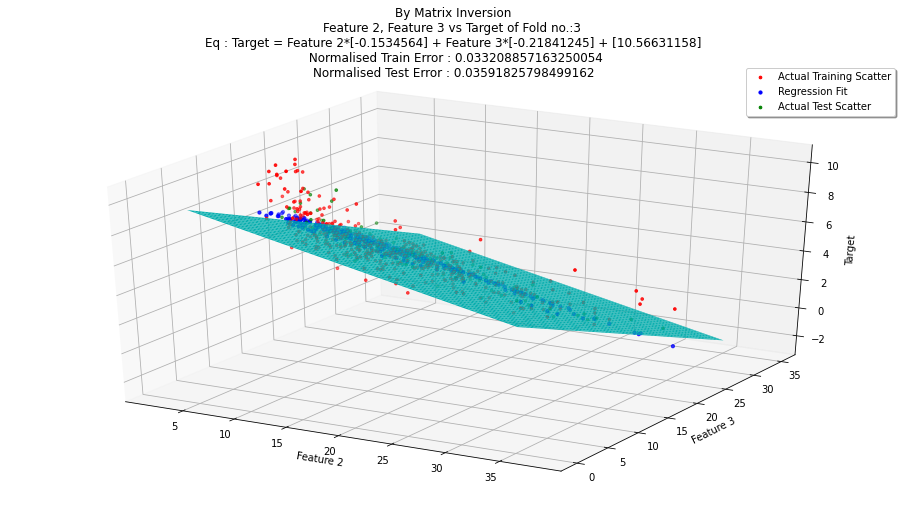

...

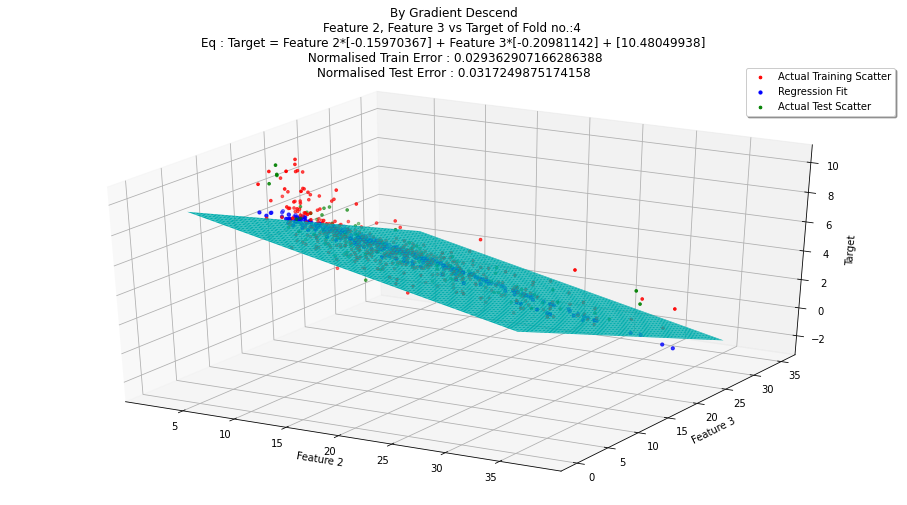

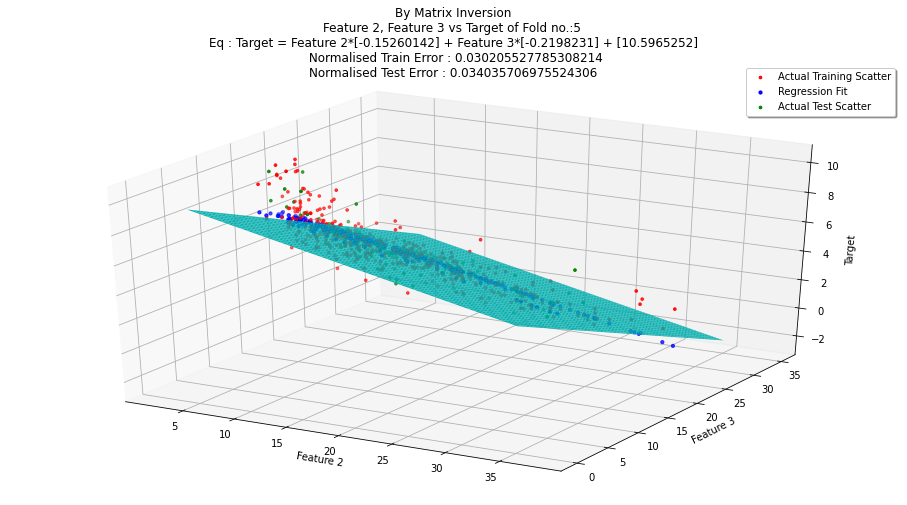

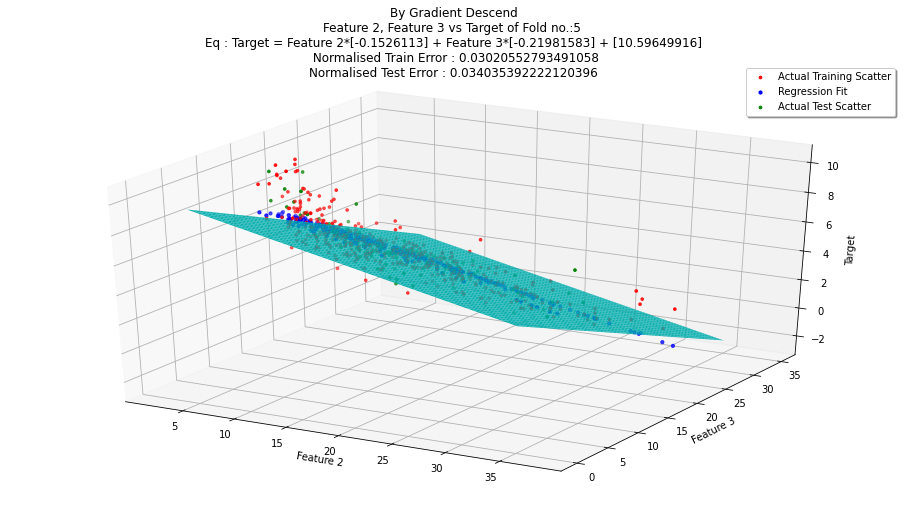

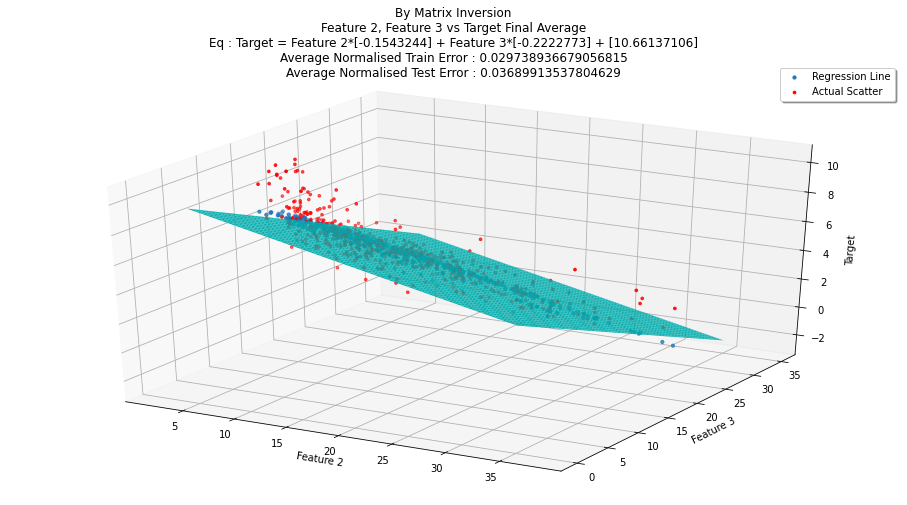

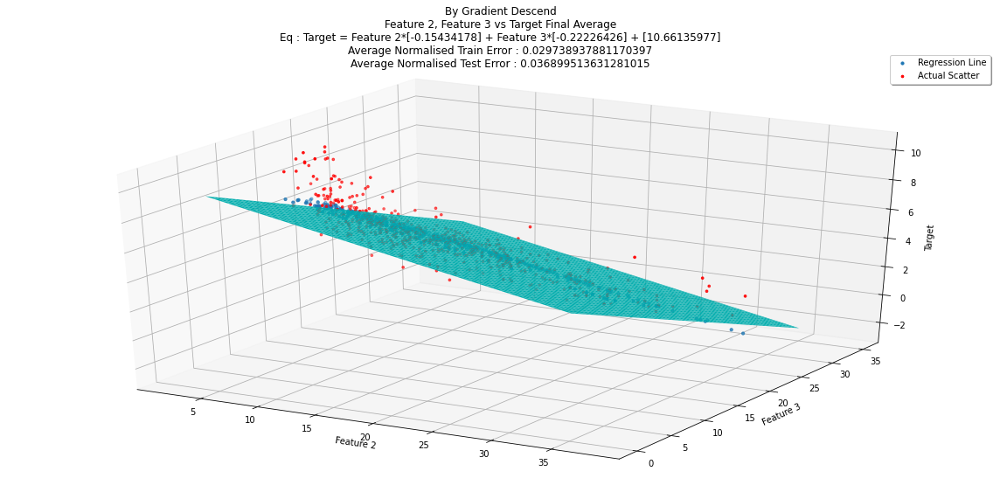



********************
Final Results :
Mean of Weights in k-Fold by Matrix Inversion Method : 
[[10.66137106]
 [-0.1543244 ]
 [-0.2222773 ]]
Standard Deviation of Weights in k-Fold by Matrix Inversion Method : 
[[0.26481059]
 [0.00278944]
 [0.01490219]]
Mean of Weights in k-Fold by Gradient Descend Method : 
[[10.66135977]
 [-0.15434178]
 [-0.22226426]]
Standard Deviation of Weights in k-Fold by Gradient Descend Method : 
[[0.26481299]
 [0.00280522]
 [0.0149084 ]]
Mean of Normalised Train Error in k-Fold by Matrix Inversion : 0.029738936679056815
Standard Deviation of Normalised Train Error in k-Fold by Matrix Inversion : 0.001994429410653925
Mean of Normalised Test Error in k-Fold by Matrix Inversion : 0.03689913537804629
Standard Deviation of Normalised Test Error in k-Fold by Matrix Inversion : 0.004164744291745097
Mean of Normalised Train Error in k-Fold by Gradient Descent : 0.029738937881170397
Standard Deviation of Normalised Train Error in k-Fold by Gradient Descent : 0.0019944

In [20]:
dataset3 = data[[1,2,3]]
average_weights3 = k.kFCVEvaluate(dataset=dataset3,extra=['Feature 2','Feature 3'],p=2)

<h2><strong> B. Best results of Regression</strong></h2>

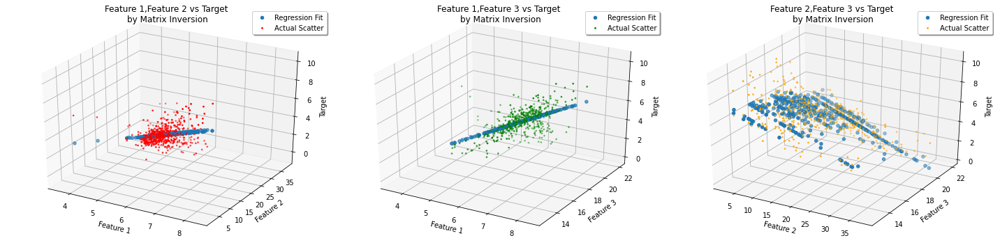

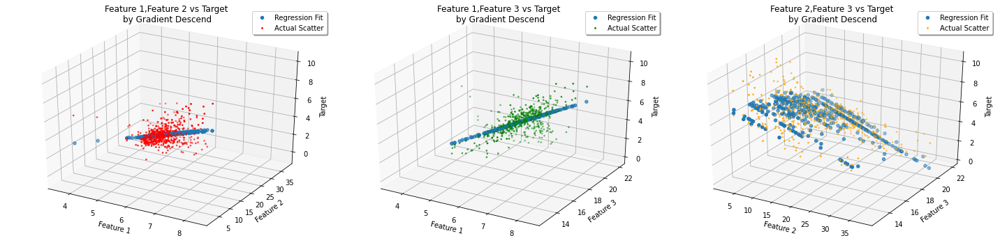

In [21]:
for i,val in enumerate(['Matrix Inversion','Gradient Descend']):     
    fig = plt.figure(figsize=(20,5))

    ax1 = fig.add_subplot(1, 3, 1, projection='3d')
    ax1.scatter(dataset1[dataset1.columns[0]],dataset1[dataset1.columns[1]],dataset1[dataset1.columns[1]]*average_weights1[i][2]+dataset1[dataset1.columns[0]]*average_weights1[i][1]+average_weights1[i][0],label="Regression Fit")
    ax1.scatter(dataset1[dataset1.columns[0]],dataset1[dataset1.columns[1]], dataset1[dataset1.columns[-1]],c='r',s=3,label="Actual Scatter")
    ax1.set_title('Feature 1,Feature 2 vs Target \nby '+str(val))
    ax1.set(xlabel='Feature 1', ylabel='Feature 2', zlabel="Target")
    ax1.legend(shadow=True, fancybox=True)

    ax2 = fig.add_subplot(1, 3, 2, projection='3d')
    ax2.scatter(dataset2[dataset2.columns[0]],dataset2[dataset2.columns[1]],dataset2[dataset2.columns[1]]*average_weights2[i][2]+dataset2[dataset2.columns[0]]*average_weights2[i][1]+average_weights2[i][0],label="Regression Fit")
    ax2.scatter(dataset2[dataset2.columns[0]],dataset2[dataset2.columns[1]], dataset2[dataset2.columns[-1]],c='g',s=3,label="Actual Scatter")
    ax2.set_title('Feature 1,Feature 3 vs Target \nby '+str(val))
    ax2.set(xlabel='Feature 1', ylabel='Feature 3', zlabel="Target")
    ax2.legend(shadow=True, fancybox=True)

    ax3 = fig.add_subplot(1, 3, 3, projection='3d')
    ax3.scatter(dataset3[dataset3.columns[0]],dataset3[dataset3.columns[1]],dataset3[dataset3.columns[1]]*average_weights3[i][2]+dataset3[dataset3.columns[0]]*average_weights3[i][1]+average_weights3[i][0],label="Regression Fit")
    ax3.scatter(dataset3[dataset3.columns[0]],dataset3[dataset3.columns[1]], dataset3[dataset3.columns[-1]],c='orange',s=3,label="Actual Scatter")
    ax3.set_title('Feature 2,Feature 3 vs Target \nby '+str(val))
    ax3.set(xlabel='Feature 2', ylabel='Feature 3', zlabel="Target")
    ax3.legend(shadow=True, fancybox=True)

    fig.tight_layout()
    plt.tight_layout()
    plt.show()

<h2><strong> B. Bivariate Polynomial Regression</strong></h2>



PolyFit For Degree : 1


********************
Results of Parameters and Errors in K-Fold no. : 1
Weights by Matrix Inversion : 
[[-0.57809665]
 [ 1.07523611]
 [-0.12700724]]
Weights by Gradient Descent : 
[[-0.5781]
 [ 1.0752]
 [-0.127 ]]
Normalized Train Error by Matrix Inversion : 0.025577174408192113
Normalized Test Error by Matrix Inversion : 0.04842614904733035
Normalized Train Error by Gradient Descent : 0.025577175099359747
Normalized Test Error by Gradient Descent : 0.04842686326562512
********************


********************
Results of Parameters and Errors in K-Fold no. : 2
Weights by Matrix Inversion : 
[[-0.44661829]
 [ 1.0349641 ]
 [-0.11458892]]
Weights by Gradient Descent : 
[[-0.4466]
 [ 1.035 ]
 [-0.1146]]
Normalized Train Error by Matrix Inversion : 0.02637607051182939
Normalized Test Error by Matrix Inversion : 0.04054293369315905
Normalized Train Error by Gradient Descent : 0.0263760710717013
Normalized Test Error by Gradient Descent : 0.04054141321107138
*****

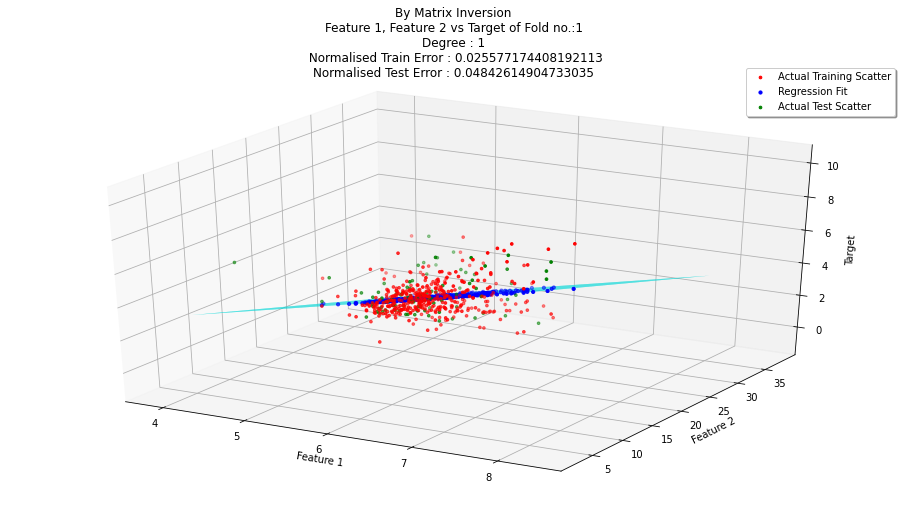

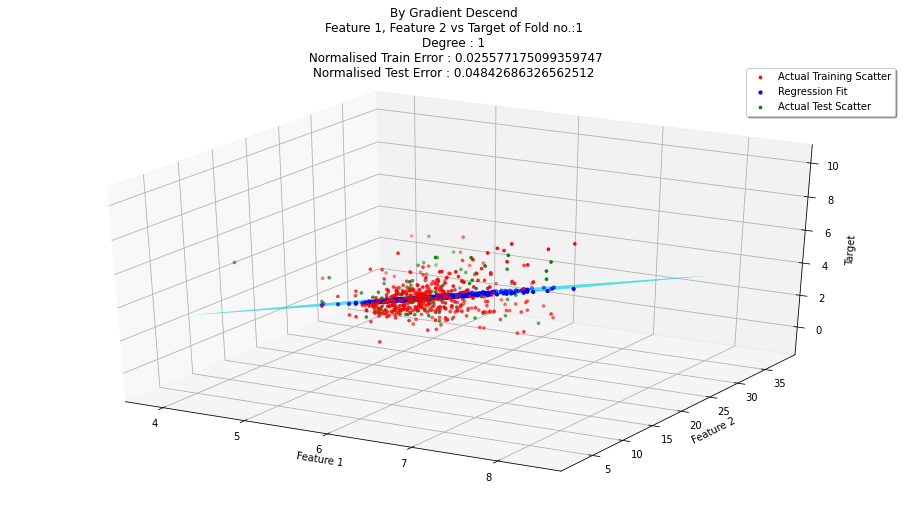

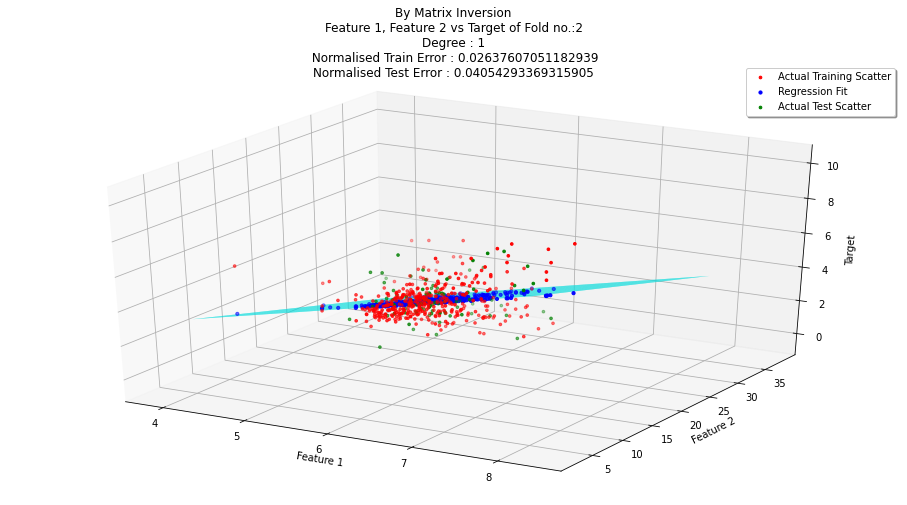

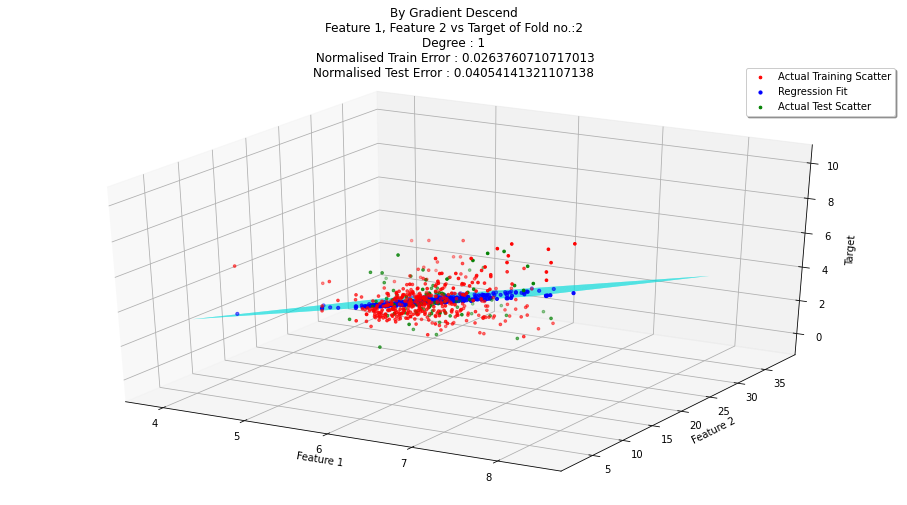

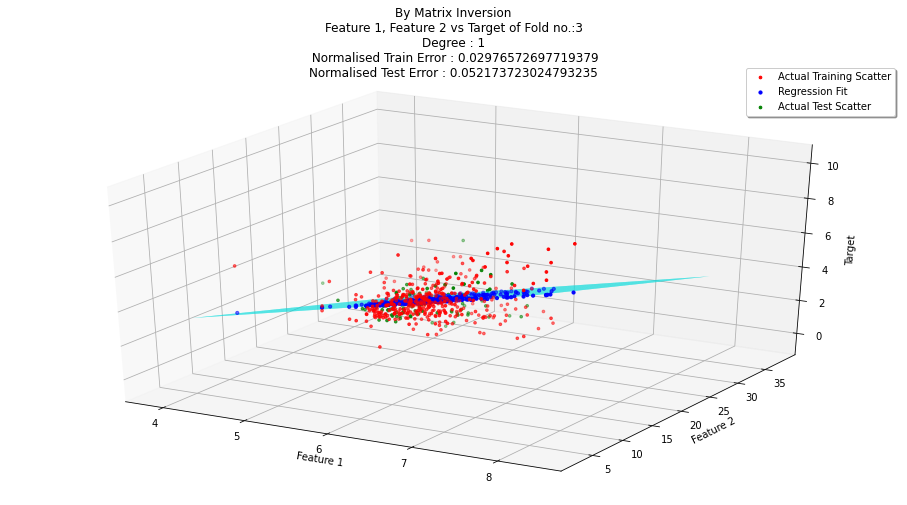

...

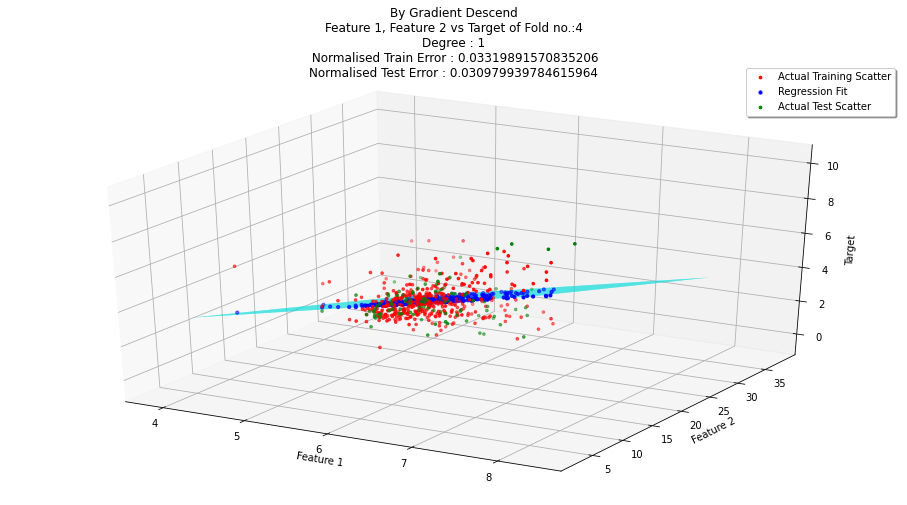

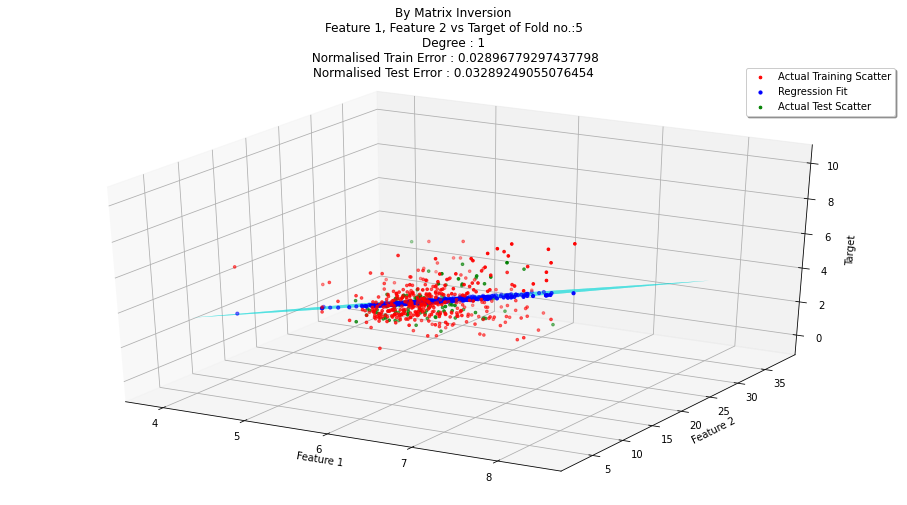

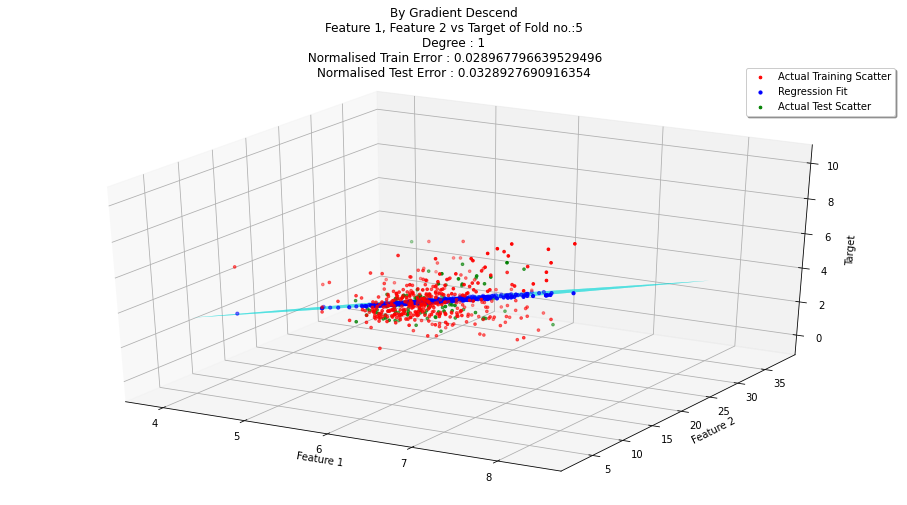

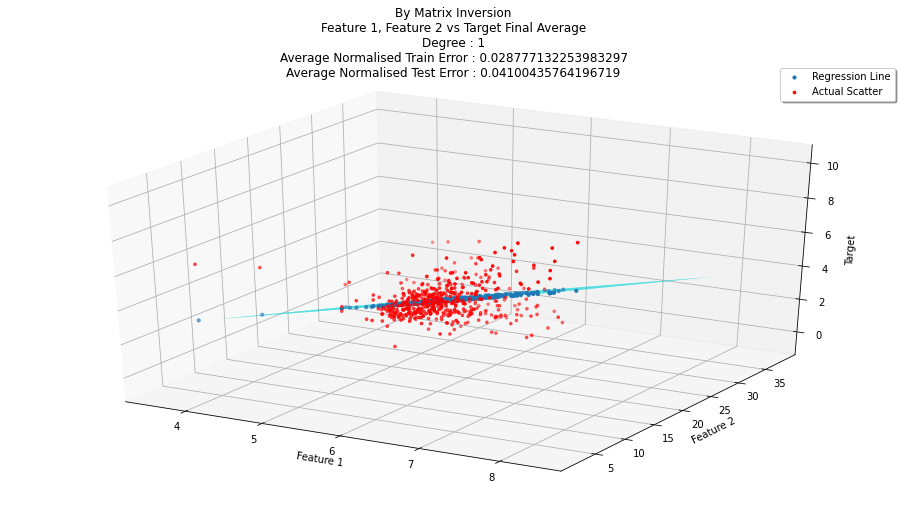

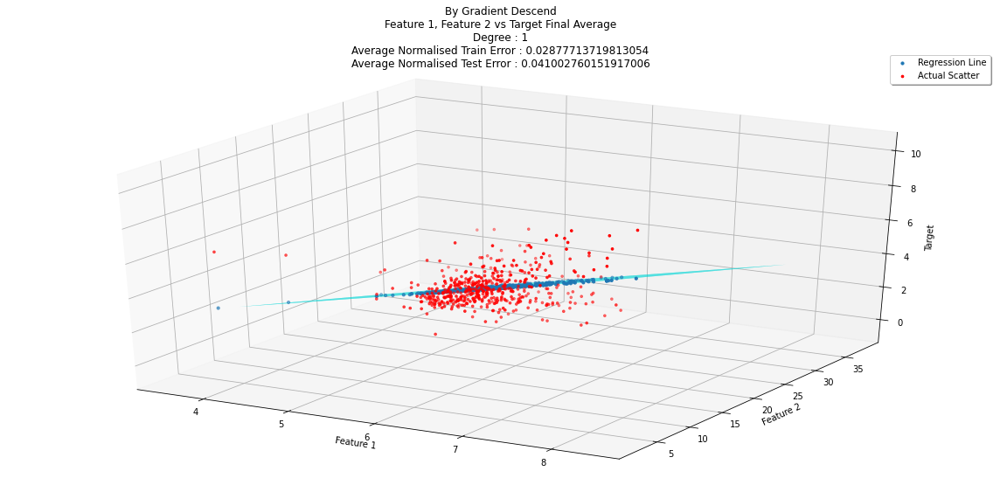



********************
Final Results :
Mean of Weights in k-Fold by Matrix Inversion Method : 
[[-0.34053131]
 [ 1.03007246]
 [-0.1197385 ]]
Standard Deviation of Weights in k-Fold by Matrix Inversion Method : 
[[0.1613935 ]
 [0.0253653 ]
 [0.00460489]]
Mean of Weights in k-Fold by Gradient Descend Method : 
[[-0.34054]
 [ 1.03006]
 [-0.11974]]
Standard Deviation of Weights in k-Fold by Gradient Descend Method : 
[[0.16138472]
 [0.02536073]
 [0.00459243]]
Mean of Normalised Train Error in k-Fold by Matrix Inversion : 0.028777132253983297
Standard Deviation of Normalised Train Error in k-Fold by Matrix Inversion : 0.002704459165515605
Mean of Normalised Test Error in k-Fold by Matrix Inversion : 0.04100435764196719
Standard Deviation of Normalised Test Error in k-Fold by Matrix Inversion : 0.008321185548155877
Mean of Normalised Train Error in k-Fold by Gradient Descent : 0.02877713719813054
Standard Deviation of Normalised Train Error in k-Fold by Gradient Descent : 0.00270446530471821

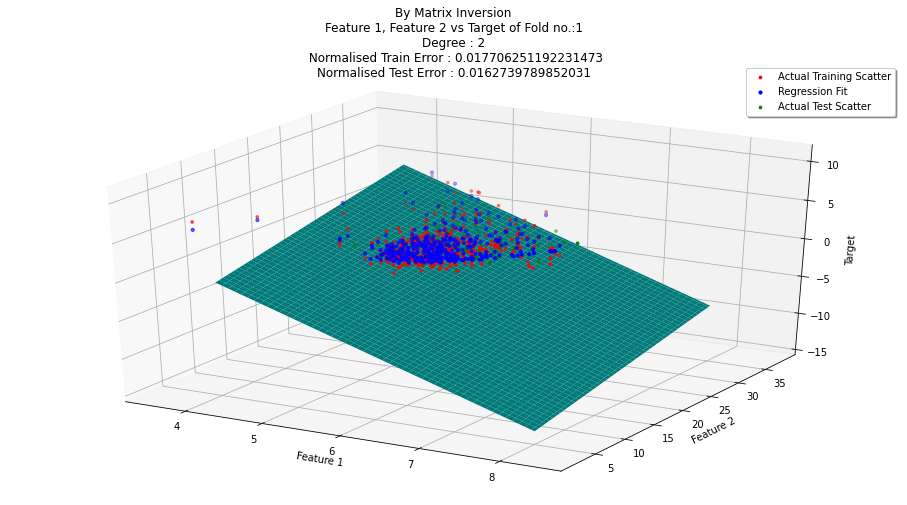

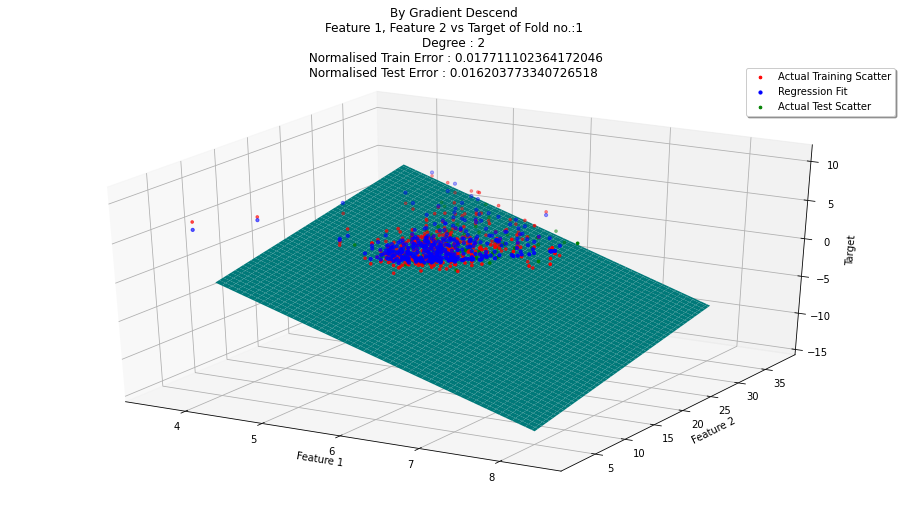

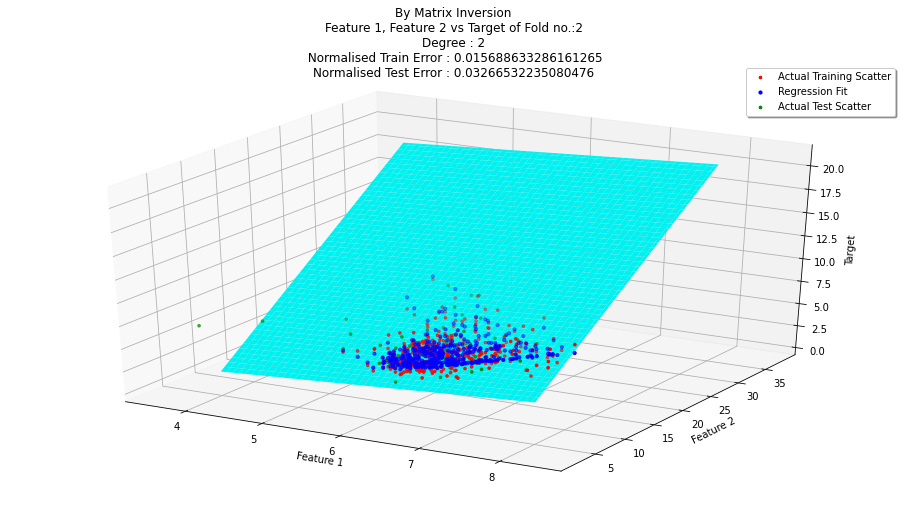

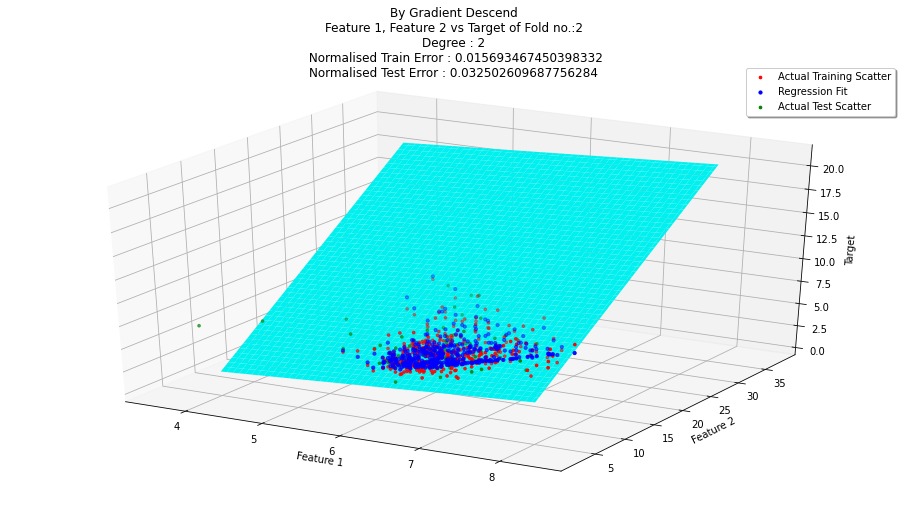

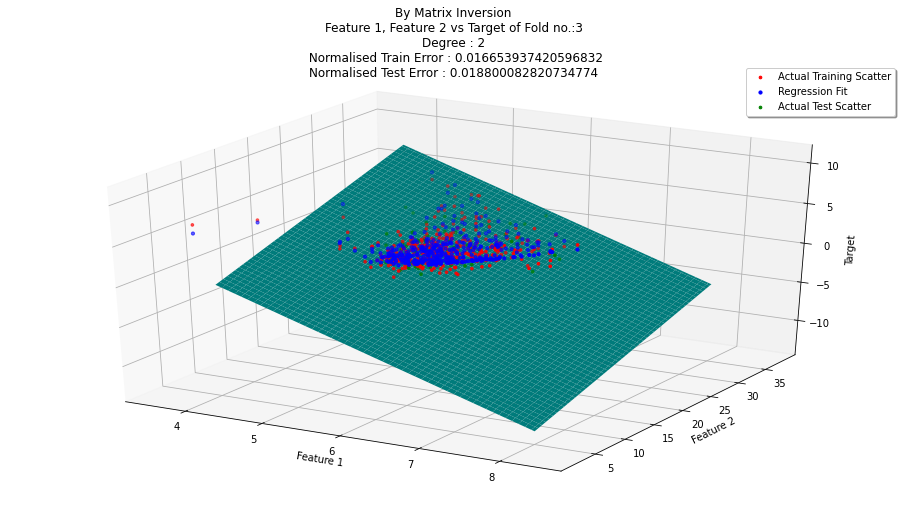

...

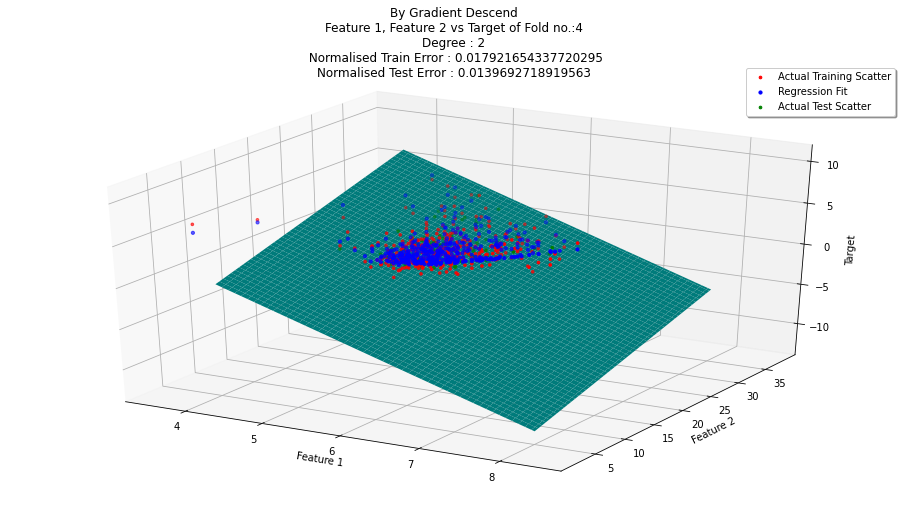

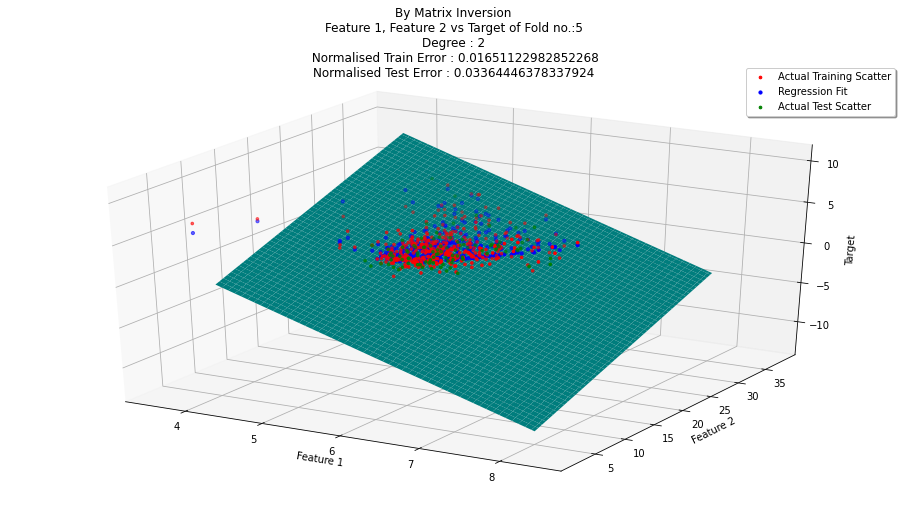

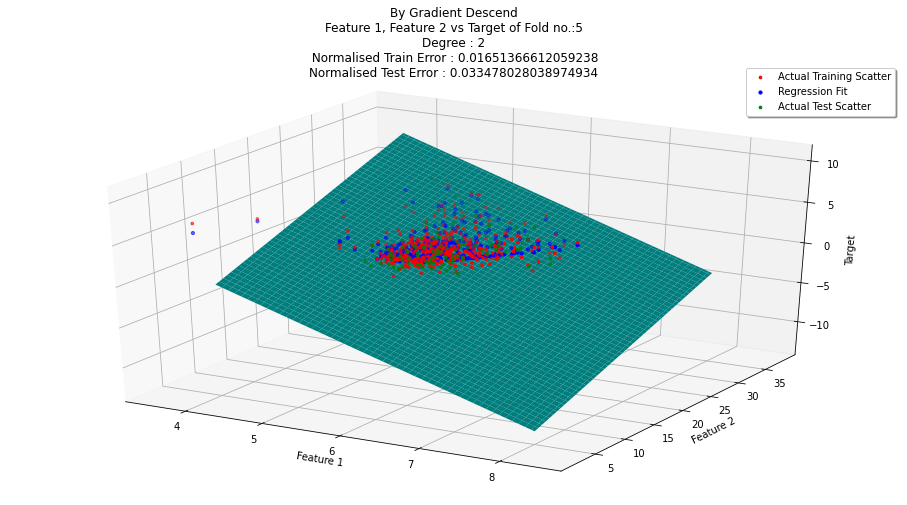

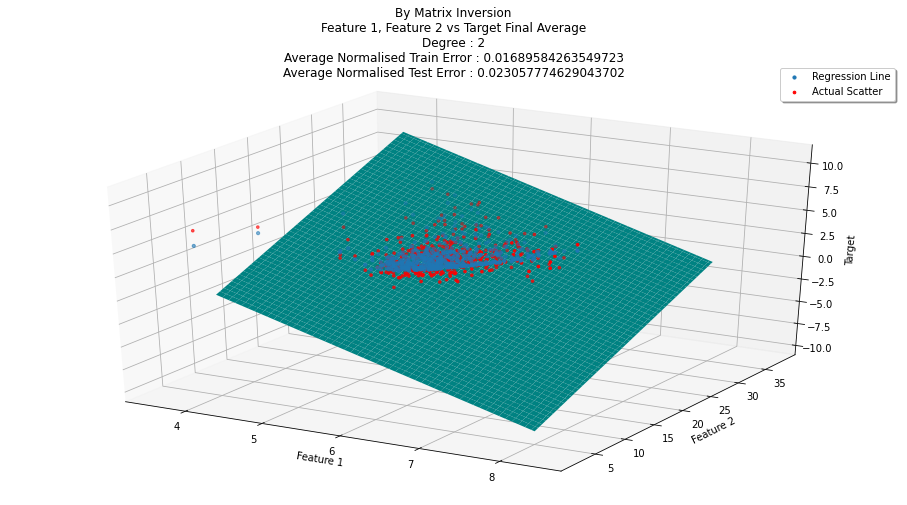

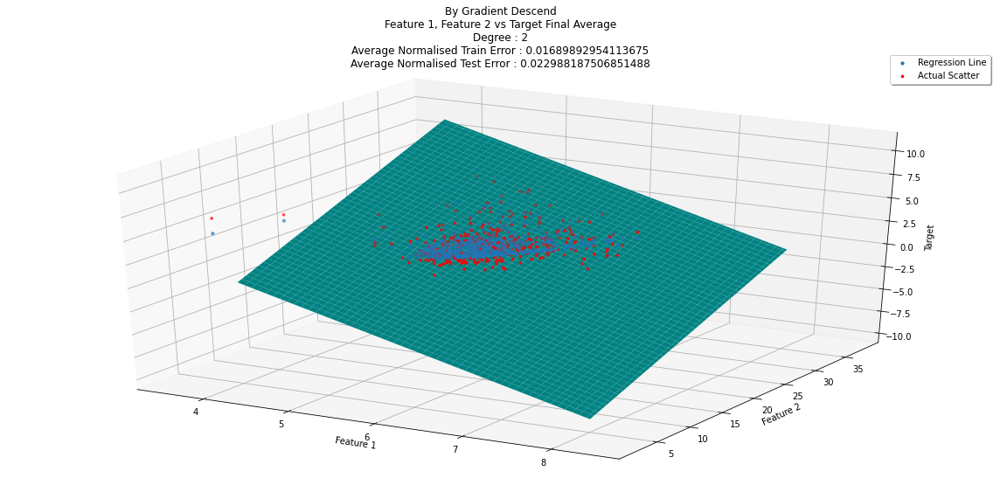



********************
Final Results :
Mean of Weights in k-Fold by Matrix Inversion Method : 
[[ 8.11896074e+00]
 [-2.41587248e+00]
 [ 3.21183988e-01]
 [-7.25868998e-04]
 [-7.20182112e-02]
 [ 3.33373044e-01]]
Standard Deviation of Weights in k-Fold by Matrix Inversion Method : 
[[5.51273458e+00]
 [1.45197355e+00]
 [1.28394359e-01]
 [9.72776400e-04]
 [1.65798834e-02]
 [9.62559164e-02]]
Mean of Weights in k-Fold by Gradient Descend Method : 
[[ 8.11894e+00]
 [-2.41588e+00]
 [ 3.21200e-01]
 [-7.40000e-04]
 [-7.20200e-02]
 [ 3.33380e-01]]
Standard Deviation of Weights in k-Fold by Gradient Descend Method : 
[[5.51273628e+00]
 [1.45197177e+00]
 [1.28410794e-01]
 [9.45727233e-04]
 [1.65731590e-02]
 [9.62501823e-02]]
Mean of Normalised Train Error in k-Fold by Matrix Inversion : 0.01689584263549723
Standard Deviation of Normalised Train Error in k-Fold by Matrix Inversion : 0.0008207000648591434
Mean of Normalised Test Error in k-Fold by Matrix Inversion : 0.023057774629043702
Standard Devia

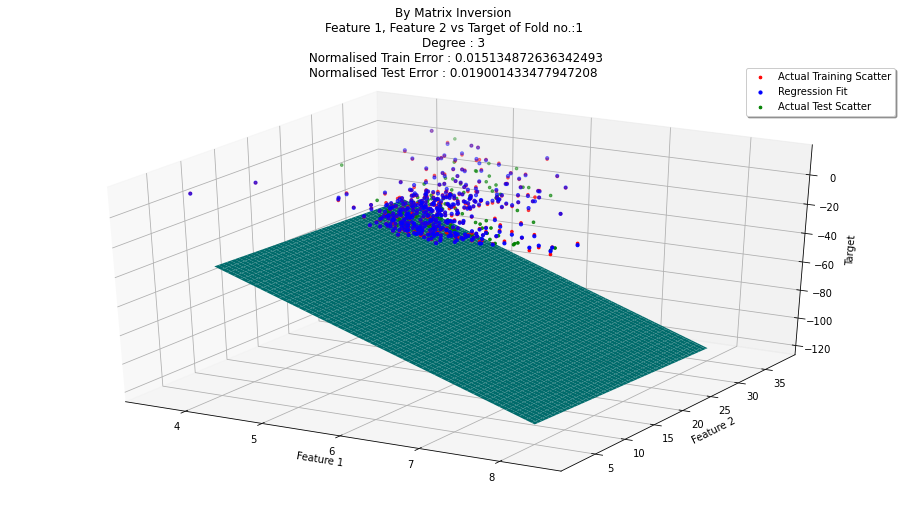

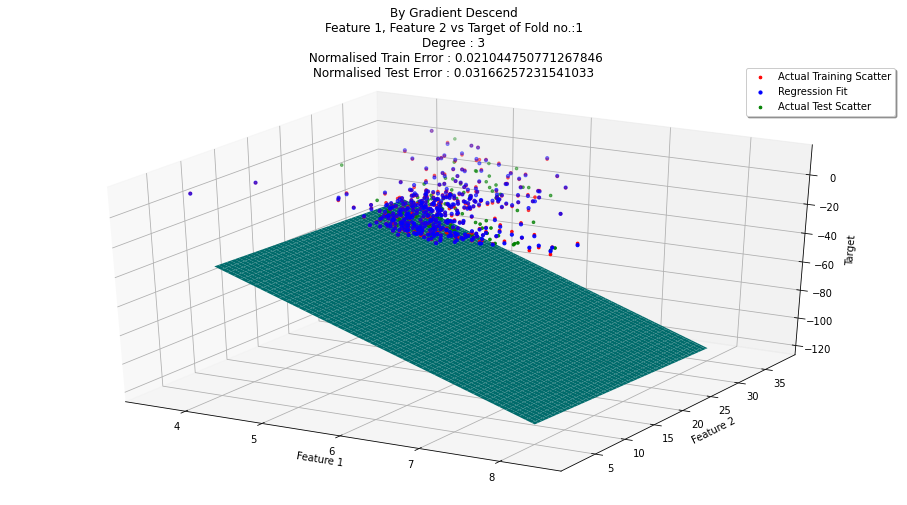

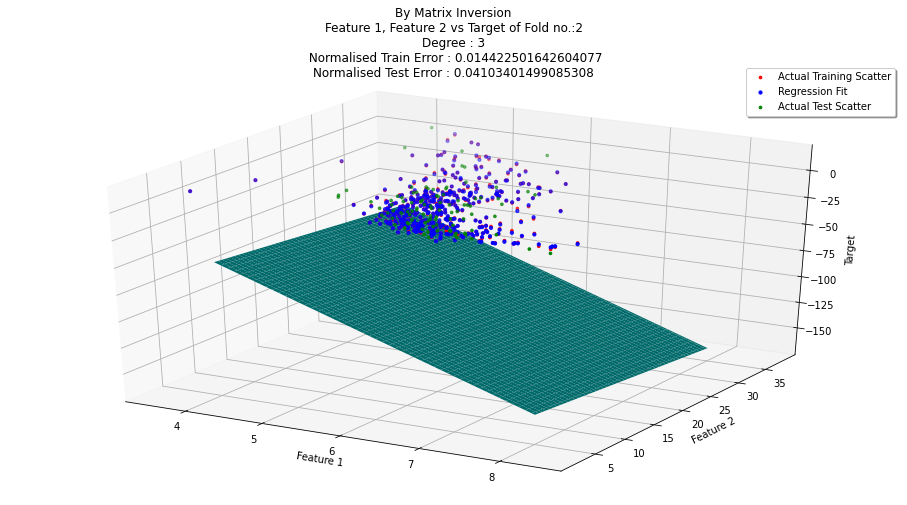

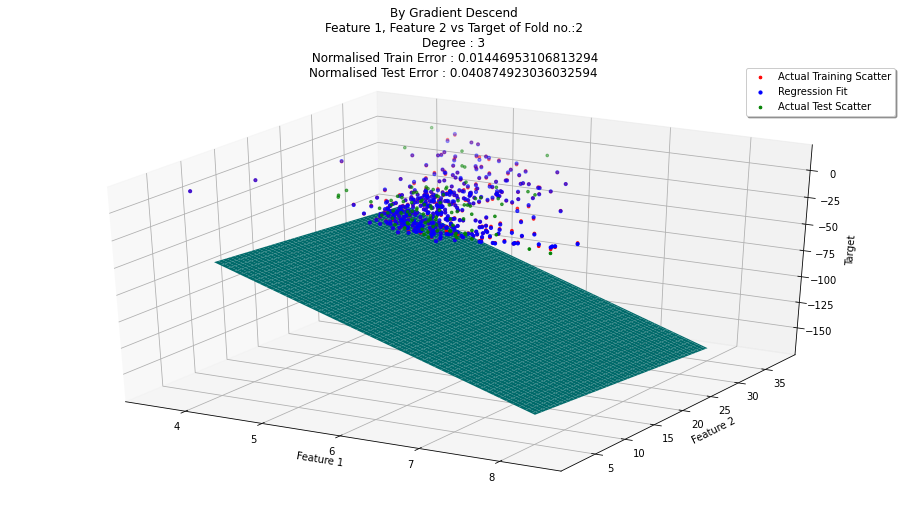

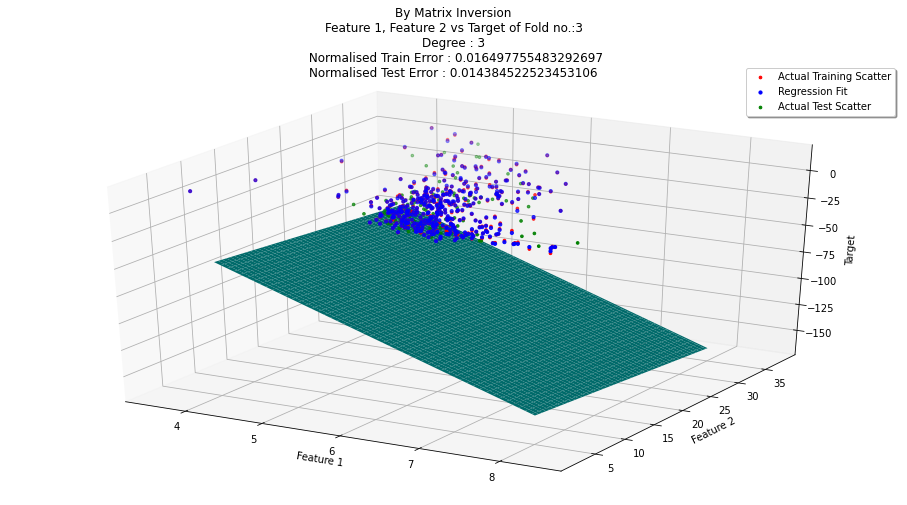

...

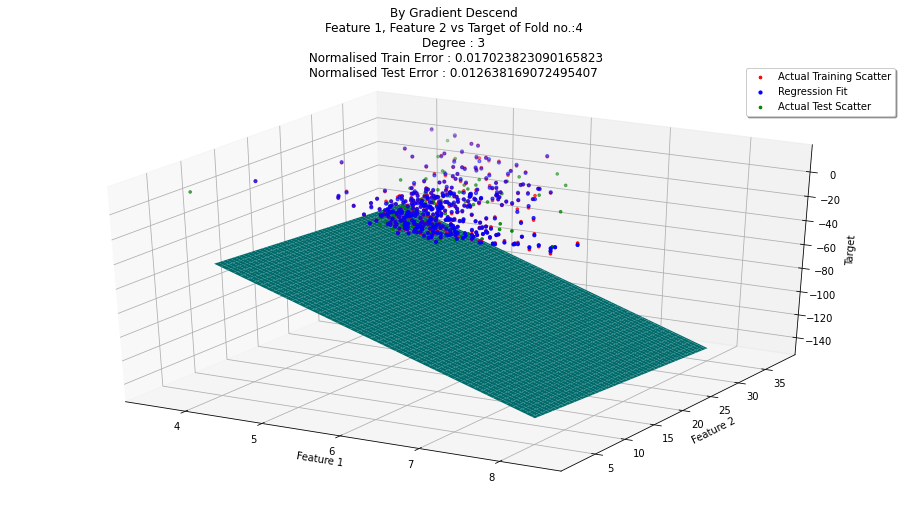

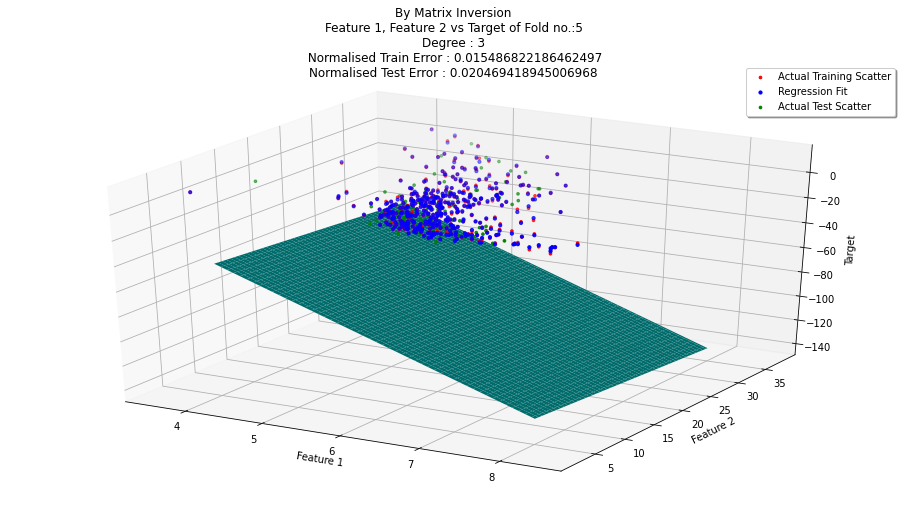

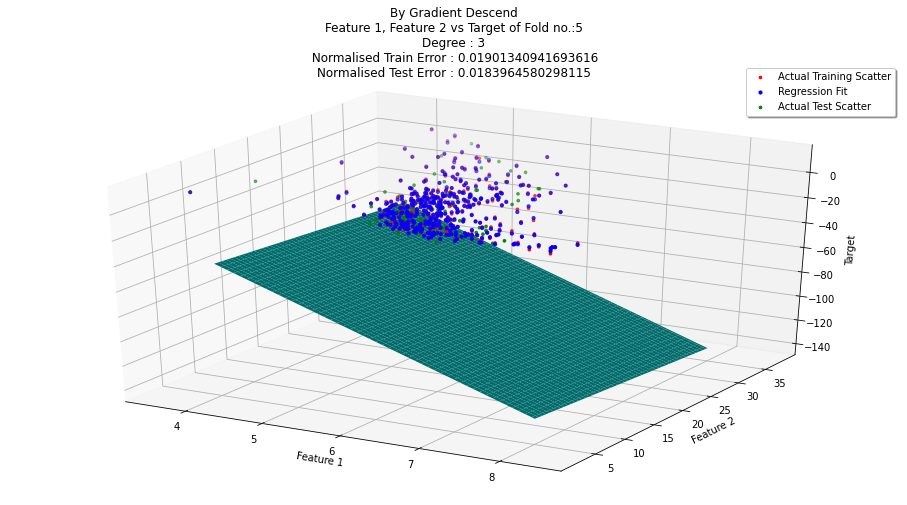

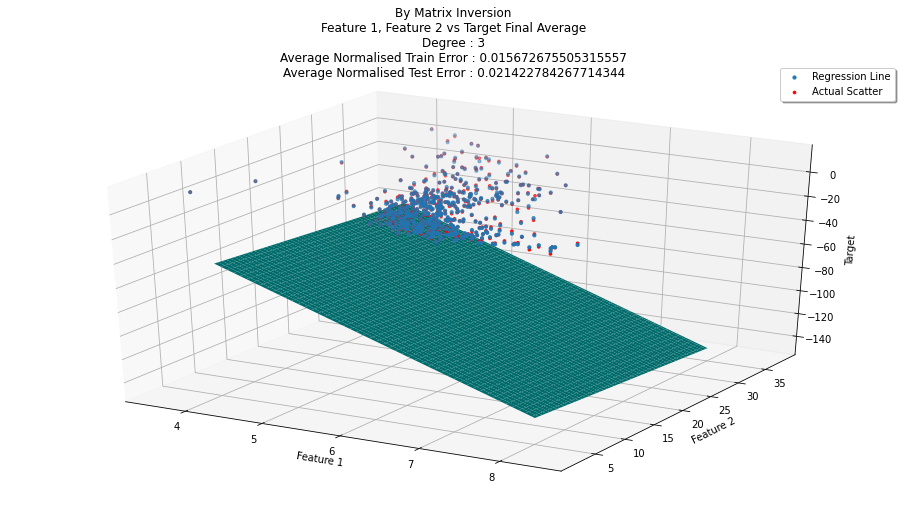

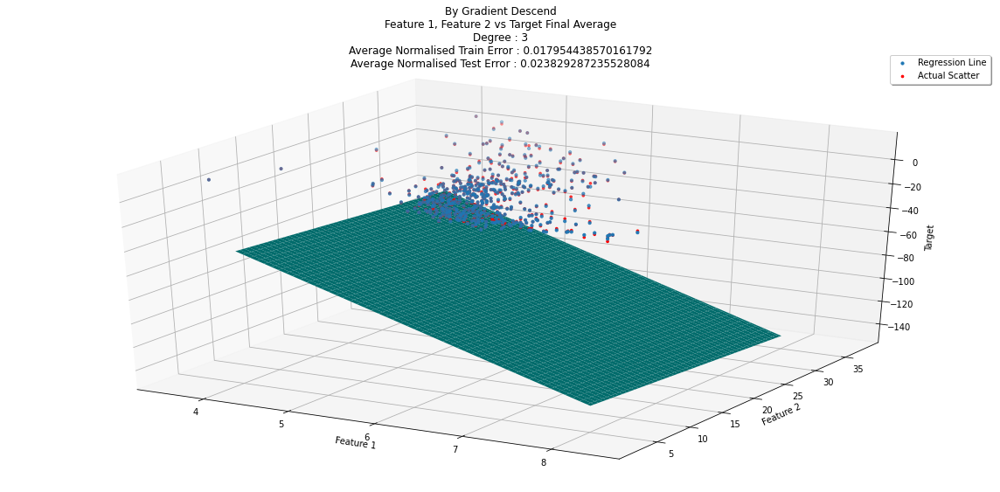



********************
Final Results :
Mean of Weights in k-Fold by Matrix Inversion Method : 
[[ 4.73569793e+01]
 [-2.23909229e+01]
 [-3.78194976e-01]
 [-2.91159295e-02]
 [ 3.10761321e-04]
 [ 3.51990285e-01]
 [ 1.97312224e-03]
 [ 3.43986594e+00]
 [-4.33632116e-02]
 [-1.51463412e-01]]
Standard Deviation of Weights in k-Fold by Matrix Inversion Method : 
[[4.04527431e+00]
 [2.05766045e+00]
 [1.29234783e-01]
 [6.11413448e-03]
 [6.19414824e-05]
 [6.24368611e-02]
 [5.09472712e-04]
 [3.26857517e-01]
 [6.68916240e-03]
 [1.66590440e-02]]
Mean of Weights in k-Fold by Gradient Descend Method : 
[[ 4.73569600e+01]
 [-2.23909000e+01]
 [-3.78180000e-01]
 [-2.91200000e-02]
 [ 3.19999985e-04]
 [ 3.52000000e-01]
 [ 1.98000000e-03]
 [ 3.43988000e+00]
 [-4.33600000e-02]
 [-1.51480000e-01]]
Standard Deviation of Weights in k-Fold by Gradient Descend Method : 
[[4.04527518e+00]
 [2.05767198e+00]
 [1.29222713e-01]
 [6.11110465e-03]
 [7.48331223e-05]
 [6.24103517e-02]
 [5.07543102e-04]
 [3.26852850e-01]
 [

In [22]:
def data_transform(X,Y,degree,n=0): 
    X_new = np.ones(X.shape)
    X_new = np.concatenate((X_new,X))
    X_new = np.concatenate((X_new,Y))
    for i in range(degree+1): 
        for j in range(degree-i+1):
            if ((i+j > 1) and (i+j <= degree)) : X_new = np.concatenate((X_new,((X**i)*(Y**j))))
    if(n==0) : X_new = np.delete(X_new, 0, 0)
    return X_new

wz1,wz2 = [],[]

feature1 = np.asarray(data[0]).reshape(1,487)
feature2 = np.asarray(data[1]).reshape(1,487)

for degree in [1,2,3]:
    print("\n\nPolyFit For Degree : "+str(degree))
    feature1_t = data_transform(feature1,feature2,degree)
    feature1_t = np.column_stack((feature1_t.T, data[3]))
    feature1_t = pd.DataFrame(data = feature1_t)
    epoch = 1 if (degree>2) else 3
    w = k.kFCVEvaluate(dataset=feature1_t,extra=['Feature 1','Feature 2'],p=2,q=degree,epoch=epoch,scope=0.001,lr=0.00000000000001)
    y_pred1 = data_transform(feature1,feature2,degree,1).T @ w[0]
    y_pred2 = data_transform(feature1,feature2,degree,1).T @ w[1]
    if degree == 2 : 
        wz1.append(y_pred1)
        wz2.append(y_pred2)



PolyFit For Degree : 1


********************
Results of Parameters and Errors in K-Fold no. : 1
Weights by Matrix Inversion : 
[[-0.65802238]
 [ 1.59793392]
 [-0.25787606]]
Weights by Gradient Descent : 
[[-0.658 ]
 [ 1.5979]
 [-0.2579]]
Normalized Train Error by Matrix Inversion : 0.03420696748228729
Normalized Test Error by Matrix Inversion : 0.0508606545647626
Normalized Train Error by Gradient Descent : 0.03420698006142051
Normalized Test Error by Gradient Descent : 0.05086118047618337
********************


********************
Results of Parameters and Errors in K-Fold no. : 2
Weights by Matrix Inversion : 
[[-0.29249122]
 [ 1.51067725]
 [-0.24730235]]
Weights by Gradient Descent : 
[[-0.2925]
 [ 1.5107]
 [-0.2473]]
Normalized Train Error by Matrix Inversion : 0.03453900698386141
Normalized Test Error by Matrix Inversion : 0.03963476681776629
Normalized Train Error by Gradient Descent : 0.03453900793425511
Normalized Test Error by Gradient Descent : 0.039635635336110565
******

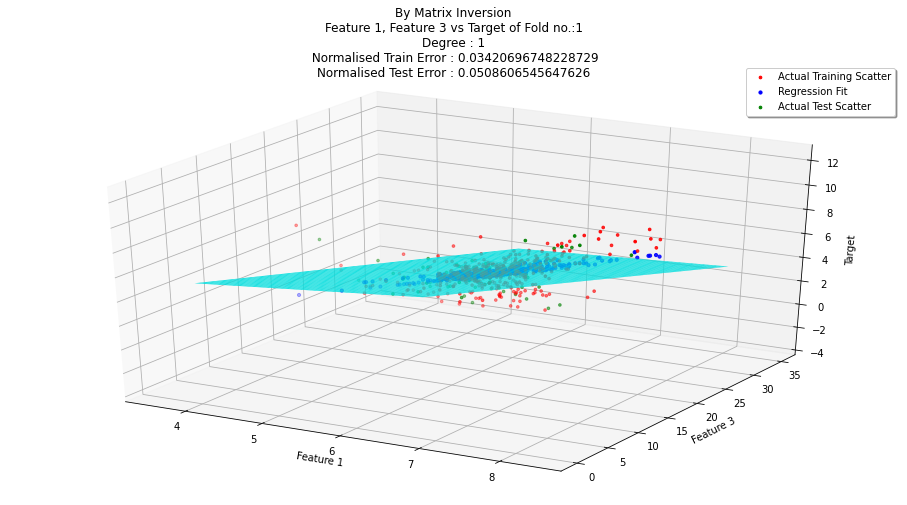

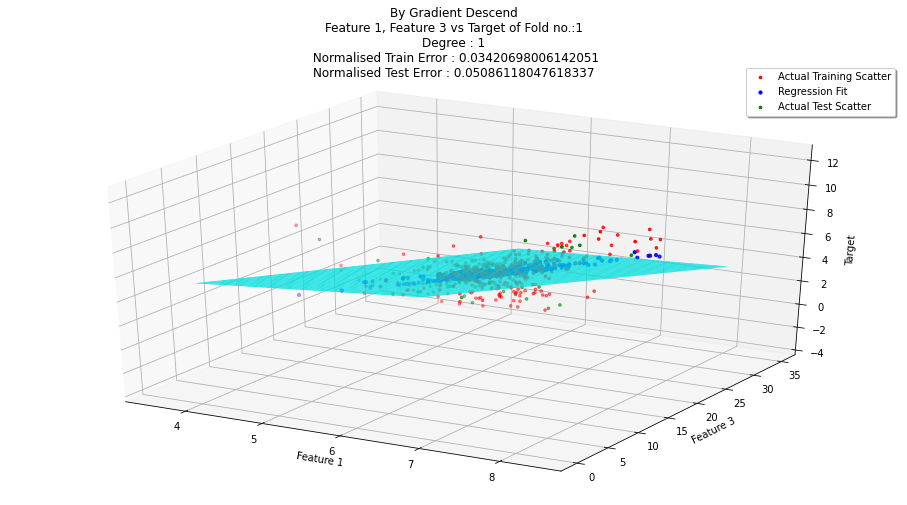

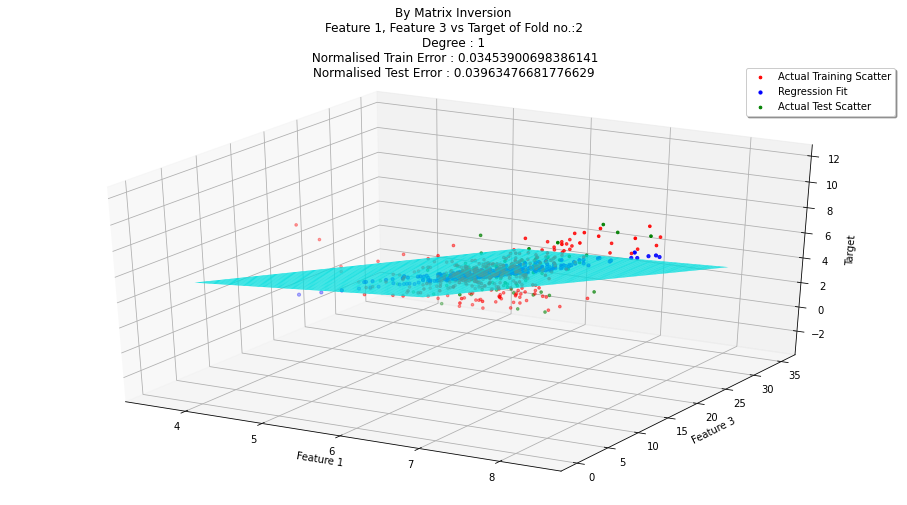

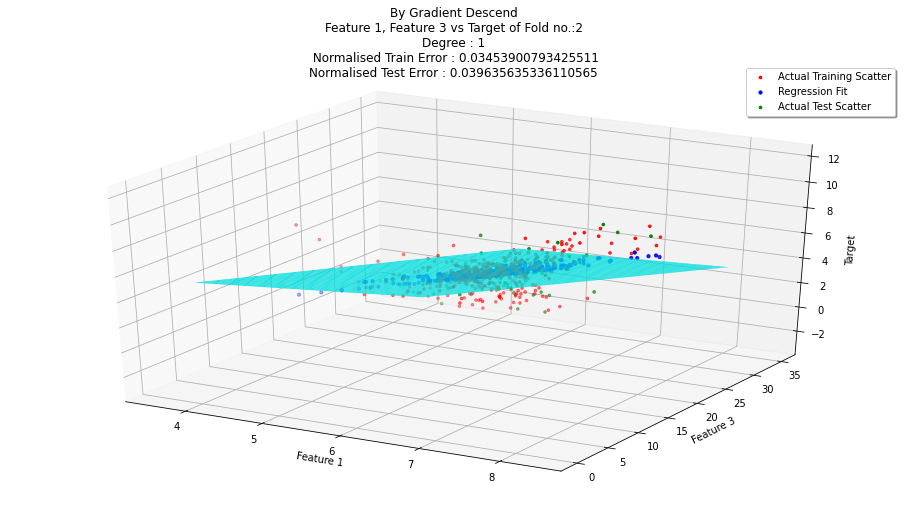

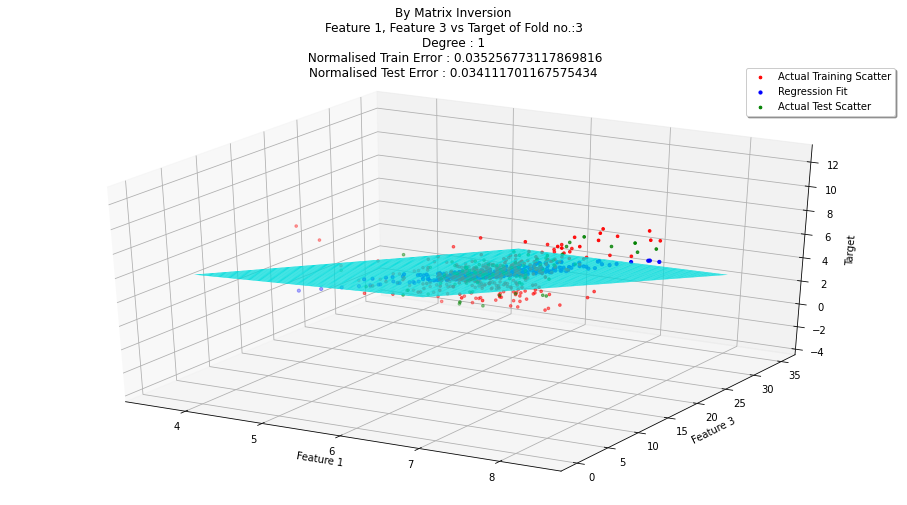

...

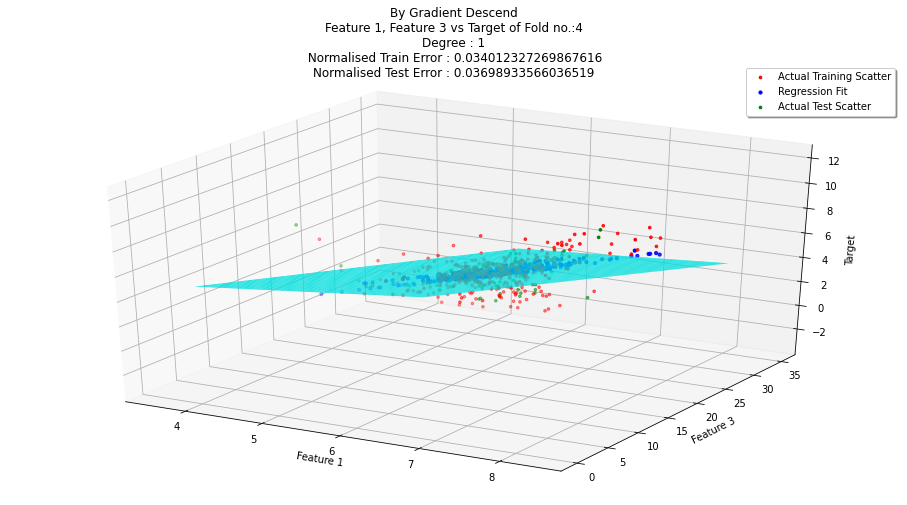

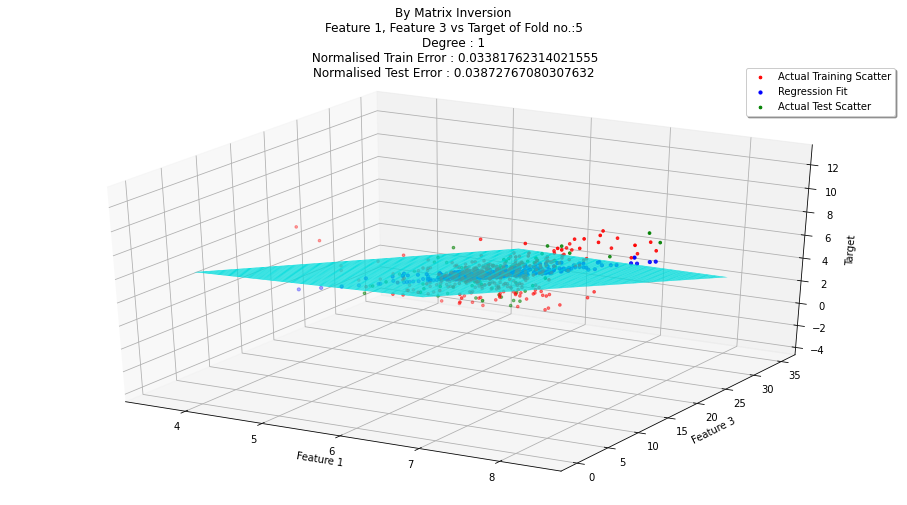

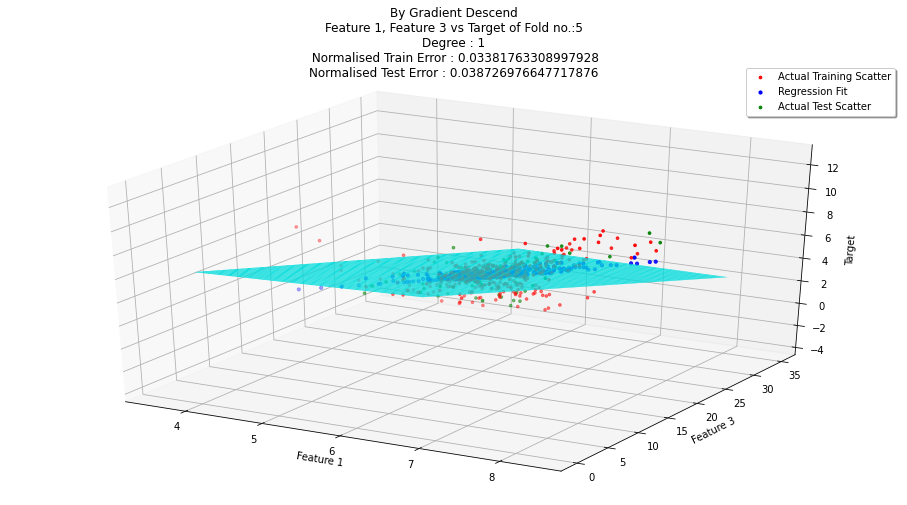

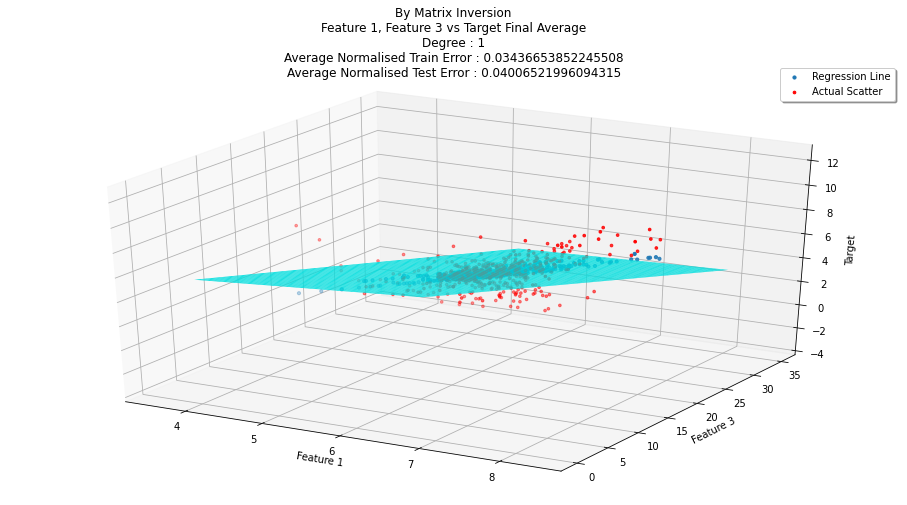

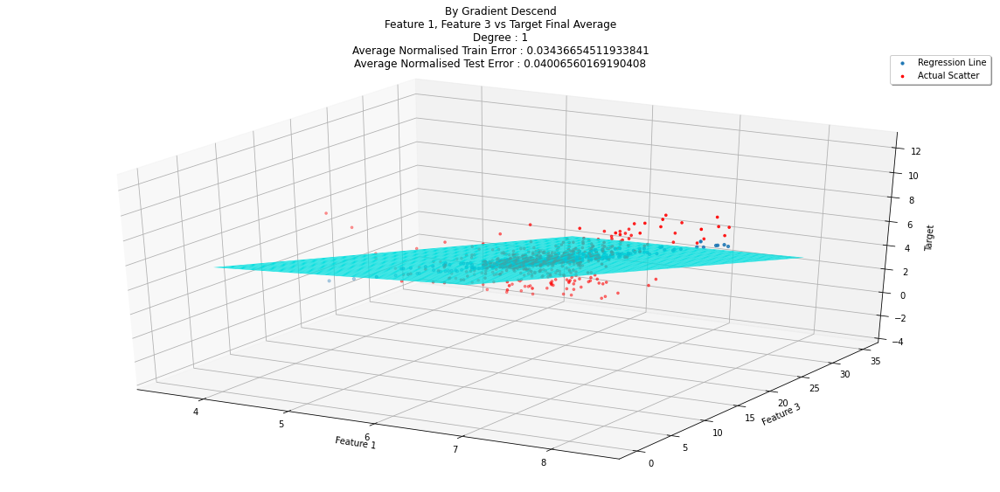



********************
Final Results :
Mean of Weights in k-Fold by Matrix Inversion Method : 
[[-0.03019207]
 [ 1.51938432]
 [-0.26513359]]
Standard Deviation of Weights in k-Fold by Matrix Inversion Method : 
[[0.83236515]
 [0.08121024]
 [0.01980318]]
Mean of Weights in k-Fold by Gradient Descend Method : 
[[-0.03018]
 [ 1.51938]
 [-0.26514]]
Standard Deviation of Weights in k-Fold by Gradient Descend Method : 
[[0.83238159]
 [0.08120102]
 [0.01979299]]
Mean of Normalised Train Error in k-Fold by Matrix Inversion : 0.03436653852245508
Standard Deviation of Normalised Train Error in k-Fold by Matrix Inversion : 0.000504876904377276
Mean of Normalised Test Error in k-Fold by Matrix Inversion : 0.04006521996094315
Standard Deviation of Normalised Test Error in k-Fold by Matrix Inversion : 0.005716800962598356
Mean of Normalised Train Error in k-Fold by Gradient Descent : 0.03436654511933841
Standard Deviation of Normalised Train Error in k-Fold by Gradient Descent : 0.000504874709573810

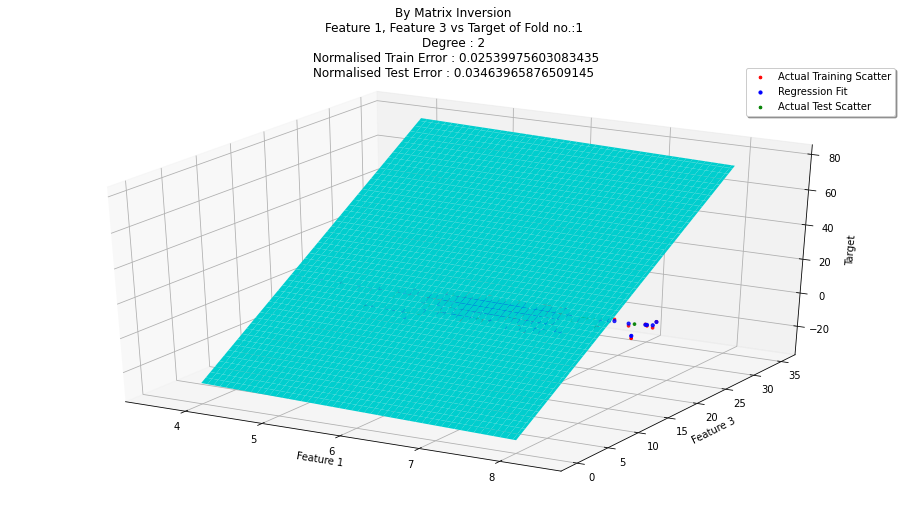

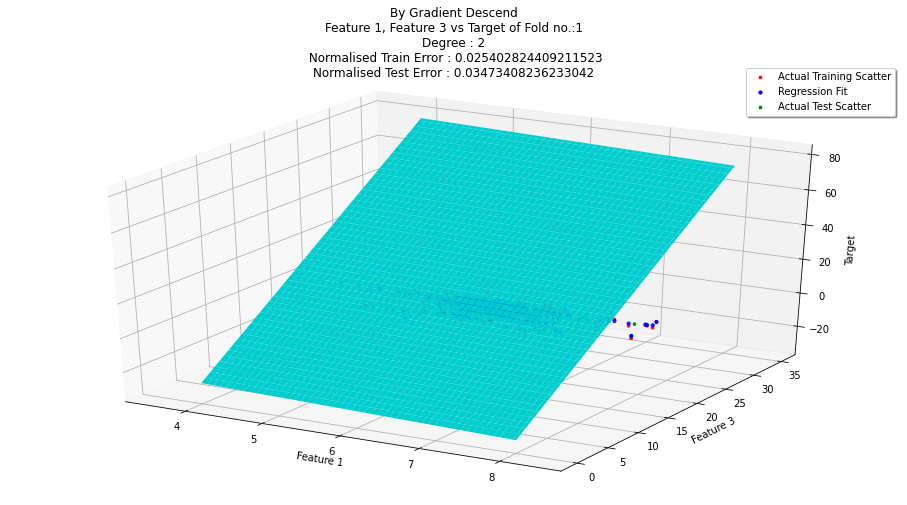

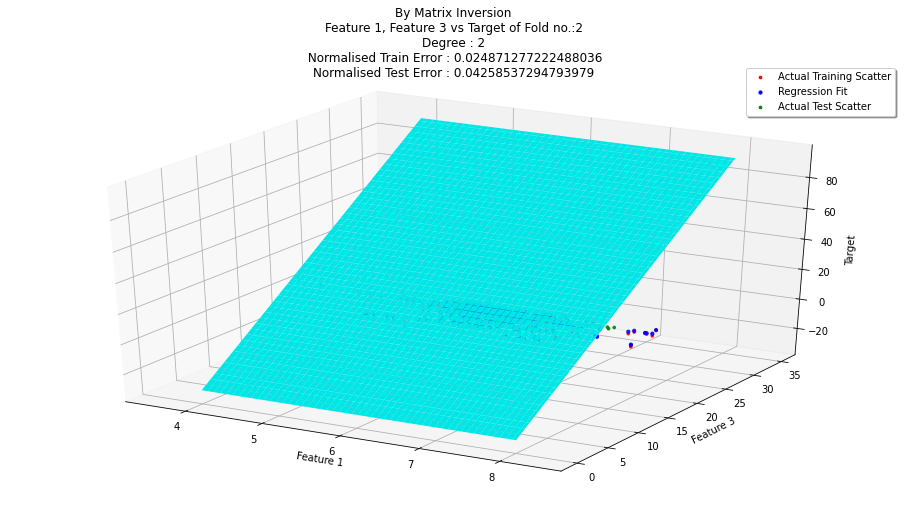

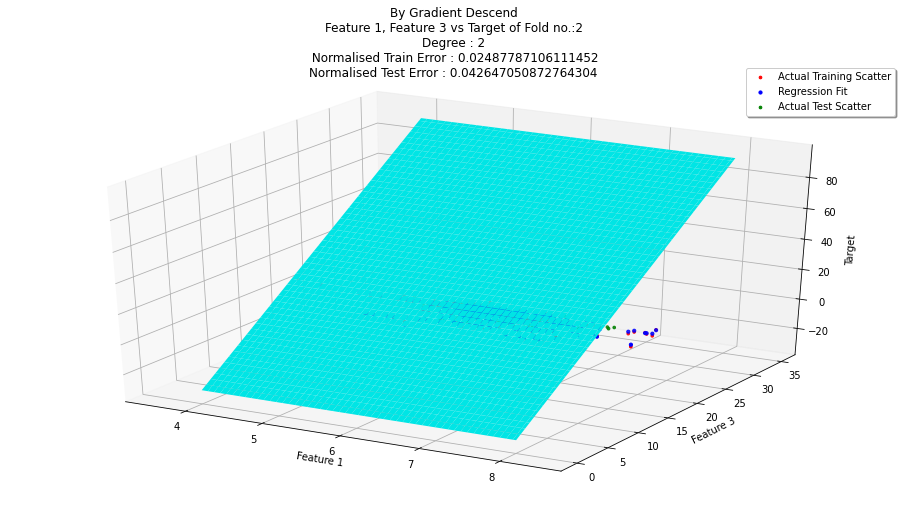

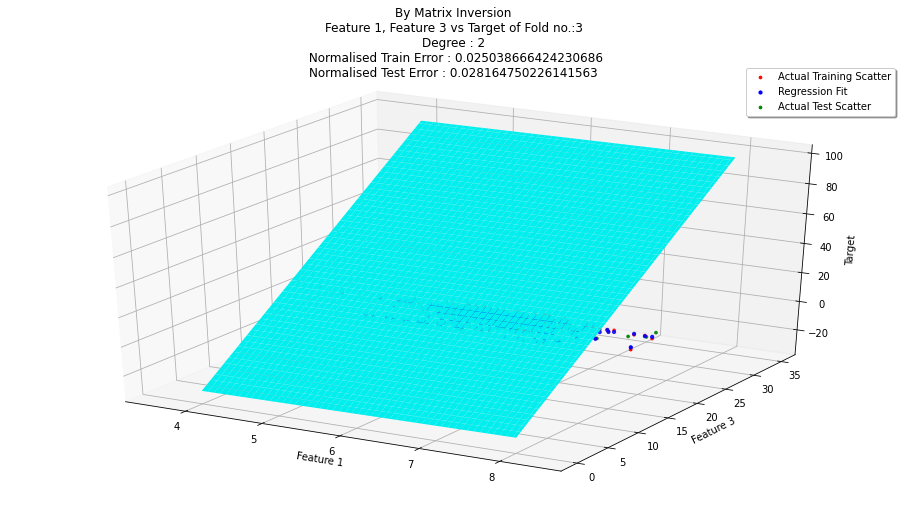

...

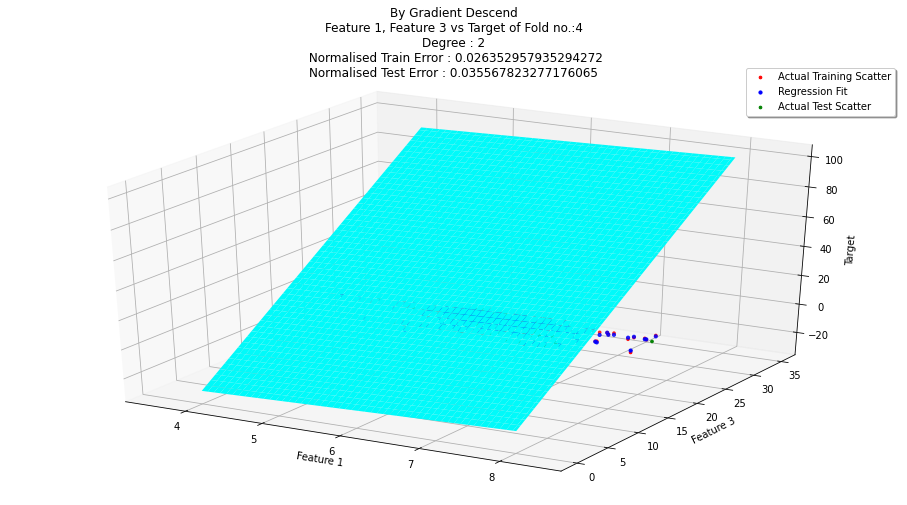

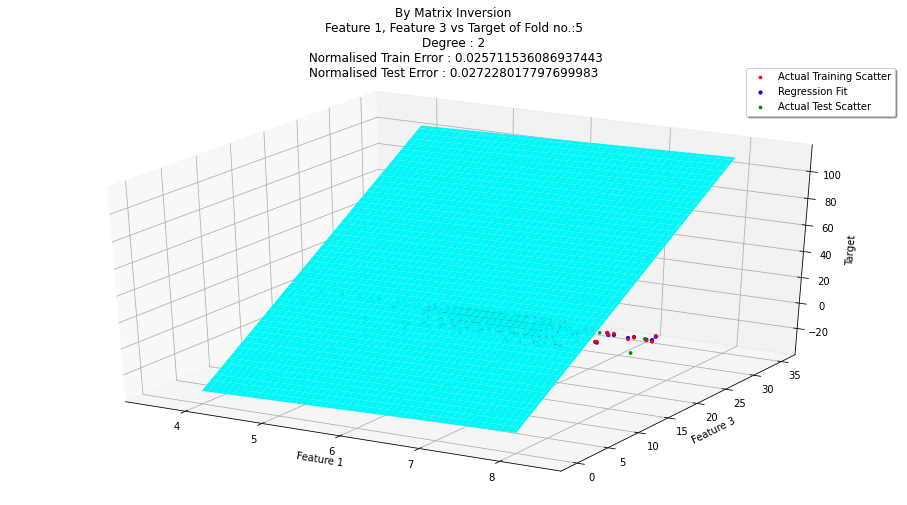

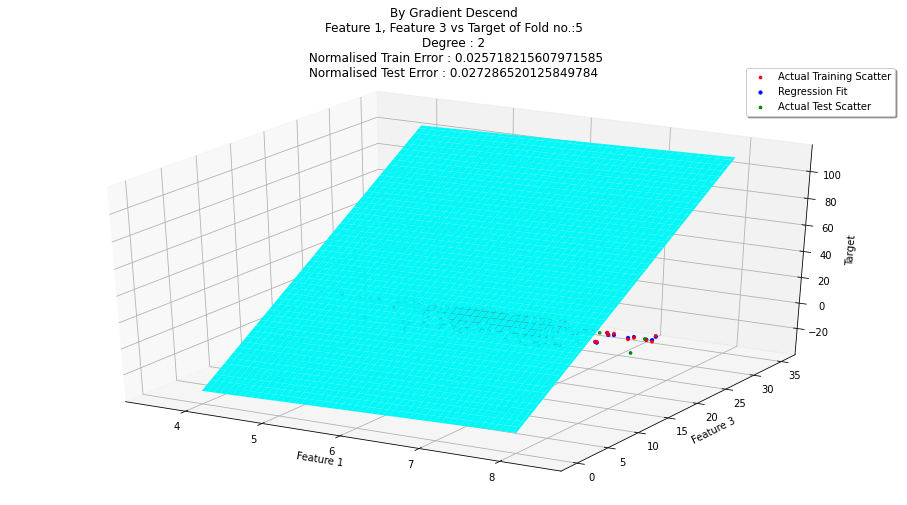

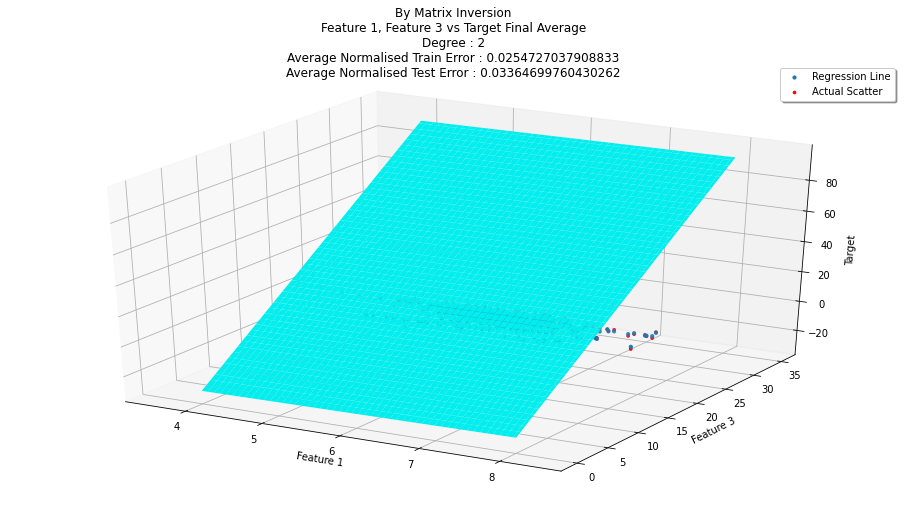

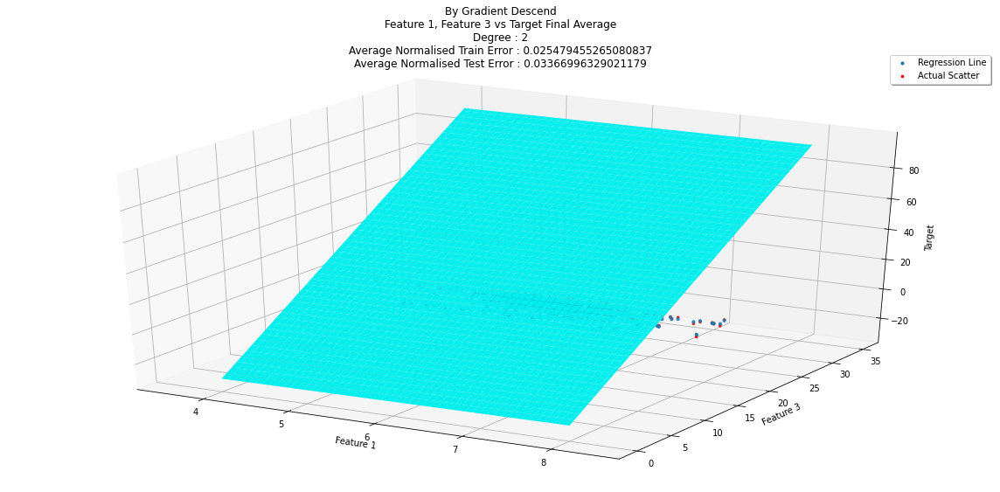



********************
Final Results :
Mean of Weights in k-Fold by Matrix Inversion Method : 
[[-29.64325504]
 [  0.41676861]
 [  3.42884269]
 [ -0.0680004 ]
 [ -0.20159183]
 [  0.3792189 ]]
Standard Deviation of Weights in k-Fold by Matrix Inversion Method : 
[[5.40470421e+00]
 [1.00300957e+00]
 [2.94739485e-01]
 [3.54038272e-03]
 [2.94035355e-02]
 [5.05527048e-02]]
Mean of Weights in k-Fold by Gradient Descend Method : 
[[-29.64324]
 [  0.41676]
 [  3.42884]
 [ -0.06802]
 [ -0.2016 ]
 [  0.3792 ]]
Standard Deviation of Weights in k-Fold by Gradient Descend Method : 
[[5.40470632e+00]
 [1.00299974e+00]
 [2.94745331e-01]
 [3.52102258e-03]
 [2.94135343e-02]
 [5.05460186e-02]]
Mean of Normalised Train Error in k-Fold by Matrix Inversion : 0.0254727037908833
Standard Deviation of Normalised Train Error in k-Fold by Matrix Inversion : 0.0005231888617691571
Mean of Normalised Test Error in k-Fold by Matrix Inversion : 0.03364699760430262
Standard Deviation of Normalised Test Error in k-Fol

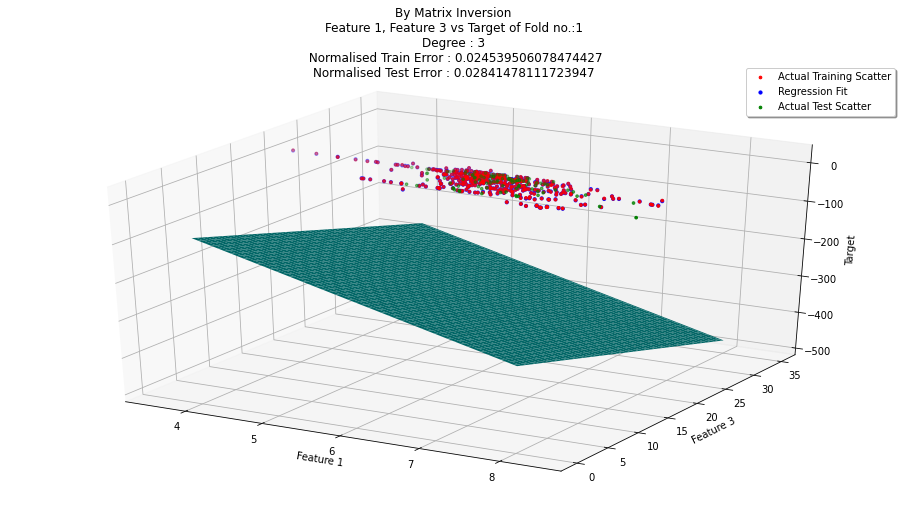

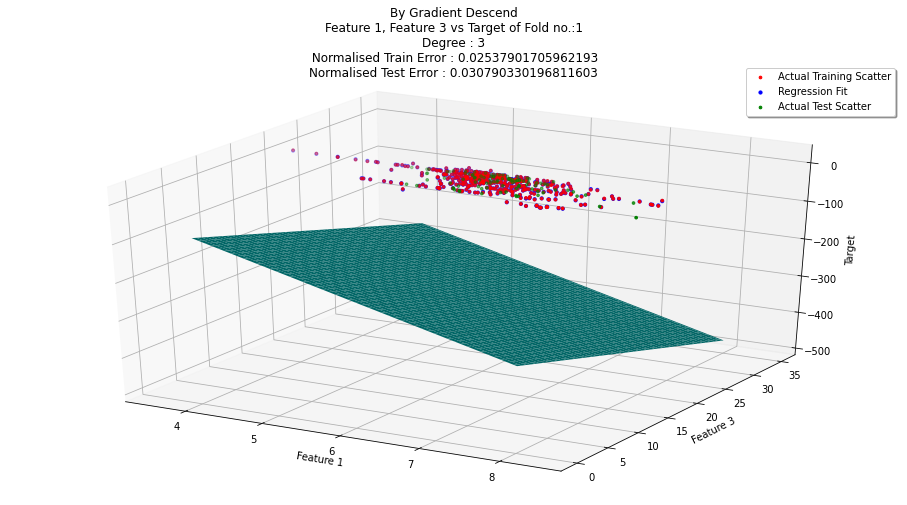

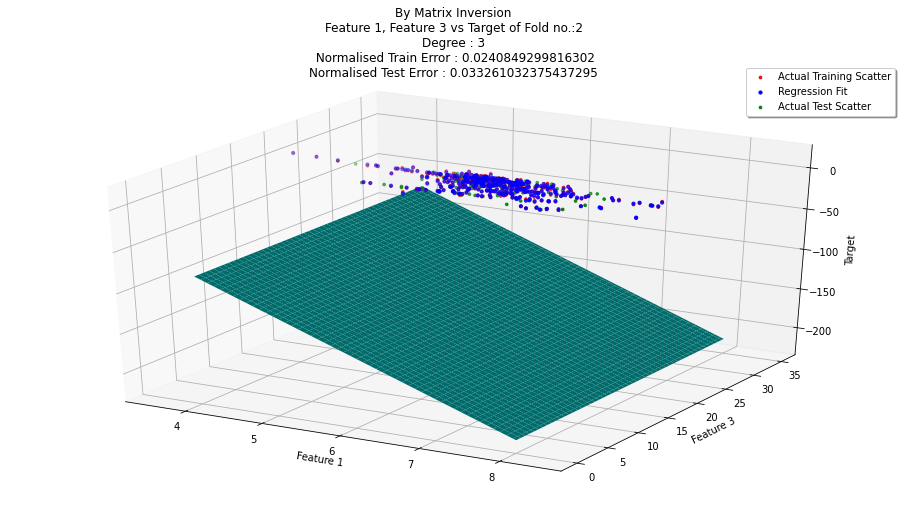

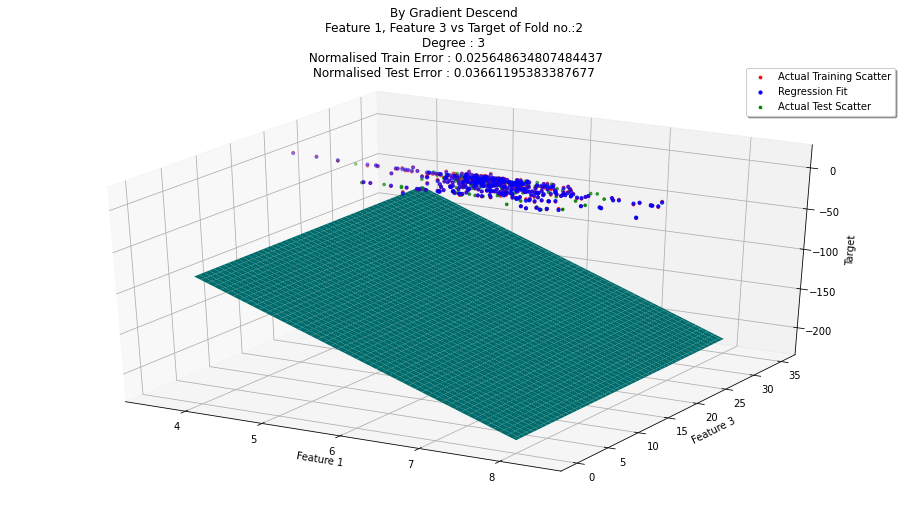

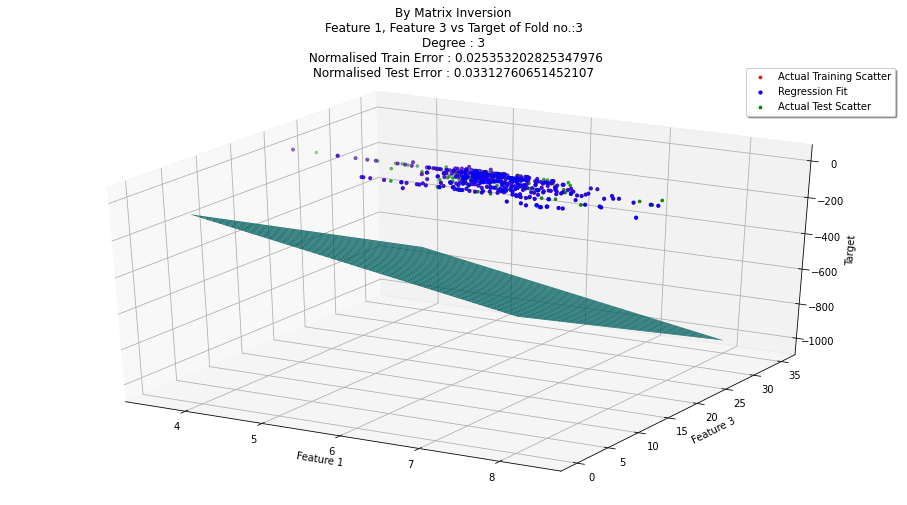

...

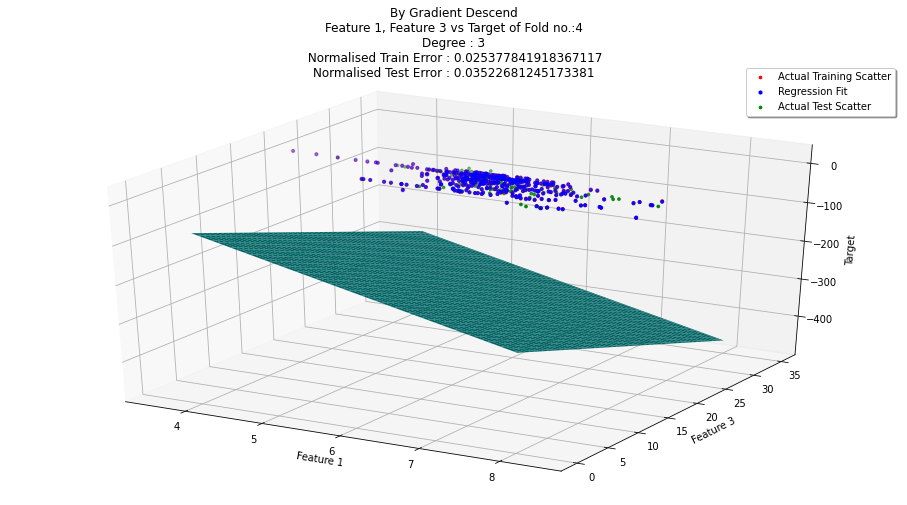

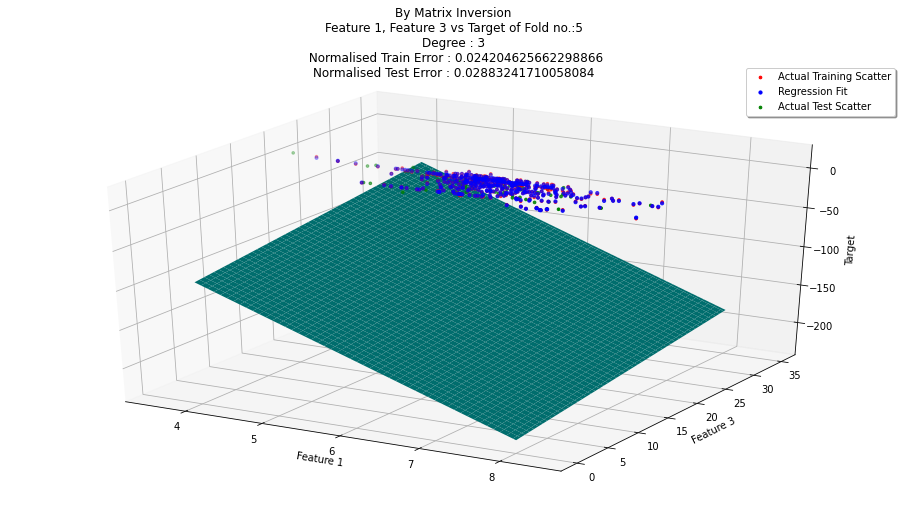

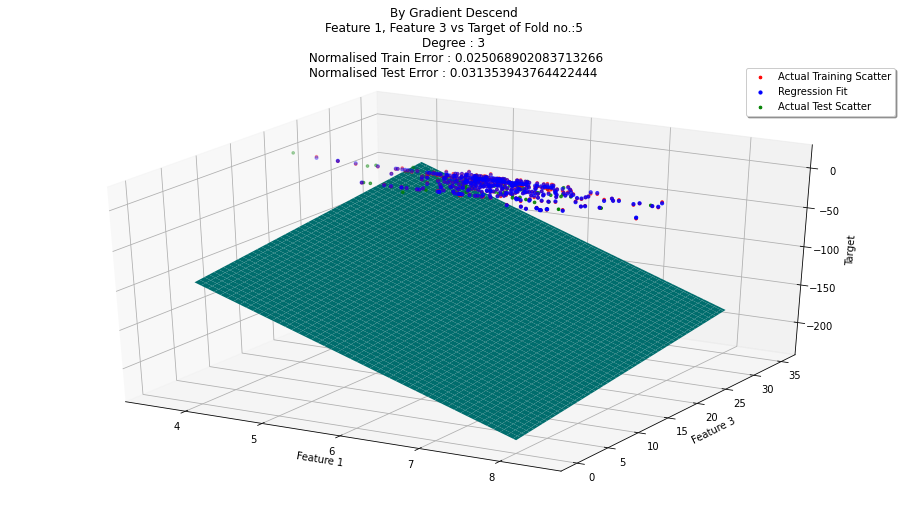

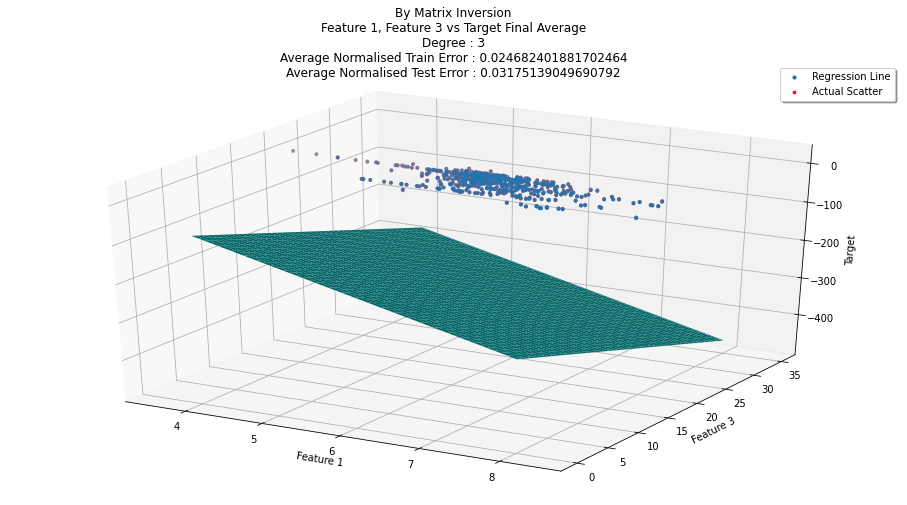

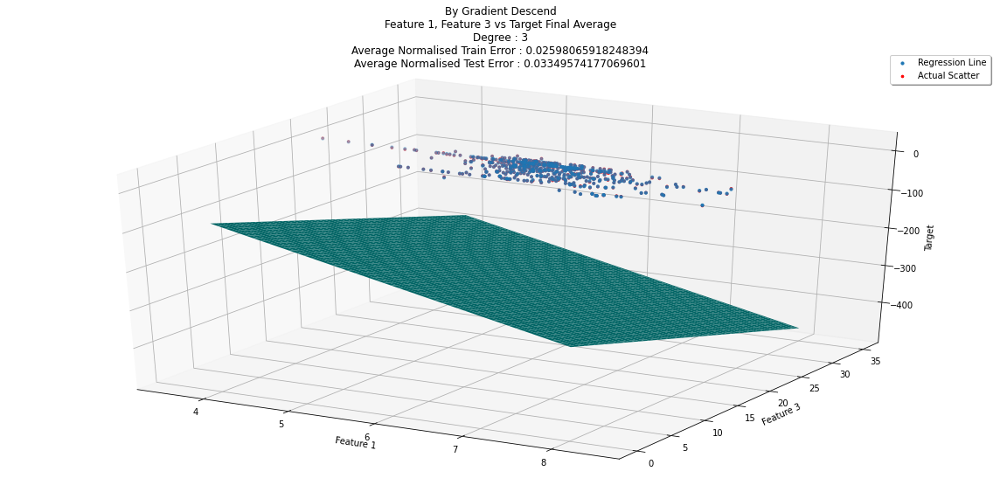



********************
Final Results :
Mean of Weights in k-Fold by Matrix Inversion Method : 
[[ 1.25184147e+02]
 [-4.86678118e+01]
 [-6.03660908e+00]
 [ 1.20139549e-02]
 [ 3.33642031e-03]
 [ 2.40560181e+00]
 [-4.08162461e-02]
 [ 4.68804818e+00]
 [-9.67462561e-02]
 [-1.39321817e-01]]
Standard Deviation of Weights in k-Fold by Matrix Inversion Method : 
[[7.04270192e+01]
 [1.45085052e+01]
 [7.30538145e+00]
 [2.55442124e-01]
 [2.99249497e-03]
 [9.91400492e-01]
 [1.72885981e-02]
 [1.02732155e+00]
 [3.43759175e-02]
 [2.77982054e-02]]
Mean of Weights in k-Fold by Gradient Descend Method : 
[[ 1.25184160e+02]
 [-4.86678000e+01]
 [-6.03660000e+00]
 [ 1.20200000e-02]
 [ 3.35999998e-03]
 [ 2.40562000e+00]
 [-4.08400000e-02]
 [ 4.68806000e+00]
 [-9.67400000e-02]
 [-1.39320000e-01]]
Standard Deviation of Weights in k-Fold by Gradient Descend Method : 
[[7.04270369e+01]
 [1.45085129e+01]
 [7.30539802e+00]
 [2.55442858e-01]
 [2.97832169e-03]
 [9.91400582e-01]
 [1.72805787e-02]
 [1.02733175e+00]
 [

In [23]:
feature1 = np.asarray(data[0]).reshape(1,487)
feature2 = np.asarray(data[2]).reshape(1,487)

for degree in [1,2,3]:
    print("\n\nPolyFit For Degree : "+str(degree))
    feature1_t = data_transform(feature1,feature2,degree)
    feature1_t = np.column_stack((feature1_t.T, data[3]))
    feature1_t = pd.DataFrame(data = feature1_t)
    epoch = 1 if (degree>2) else 3
    w = k.kFCVEvaluate(dataset=feature1_t,extra=['Feature 1','Feature 3'],p=2,q=degree,epoch=epoch,scope=0.001,lr=0.00000000000001)
    y_pred1 = data_transform(feature1,feature2,degree,1).T @ w[0]
    y_pred2 = data_transform(feature1,feature2,degree,1).T @ w[1]
    if degree == 2 : 
        wz1.append(y_pred1)
        wz2.append(y_pred2)



PolyFit For Degree : 1


********************
Results of Parameters and Errors in K-Fold no. : 1
Weights by Matrix Inversion : 
[[10.50452572]
 [-0.16263712]
 [-0.2110532 ]]
Weights by Gradient Descent : 
[[10.5045]
 [-0.1626]
 [-0.2111]]
Normalized Train Error by Matrix Inversion : 0.028377886796790583
Normalized Test Error by Matrix Inversion : 0.037747707579415715
Normalized Train Error by Gradient Descent : 0.028377894015733585
Normalized Test Error by Gradient Descent : 0.03775068460172649
********************


********************
Results of Parameters and Errors in K-Fold no. : 2
Weights by Matrix Inversion : 
[[10.6689534 ]
 [-0.15326887]
 [-0.22322742]]
Weights by Gradient Descent : 
[[10.669 ]
 [-0.1533]
 [-0.2232]]
Normalized Train Error by Matrix Inversion : 0.028519698124955167
Normalized Test Error by Matrix Inversion : 0.03480852658786323
Normalized Train Error by Gradient Descent : 0.02851970011418609
Normalized Test Error by Gradient Descent : 0.0348083264654961
***

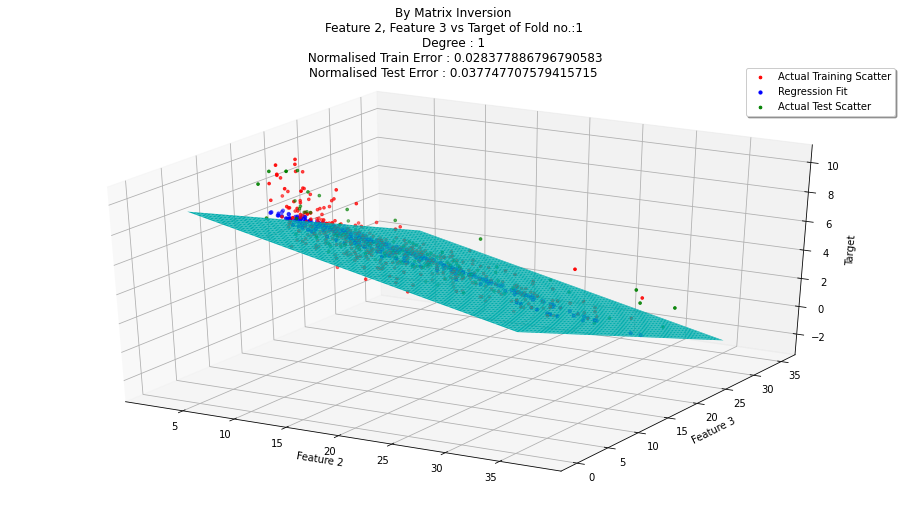

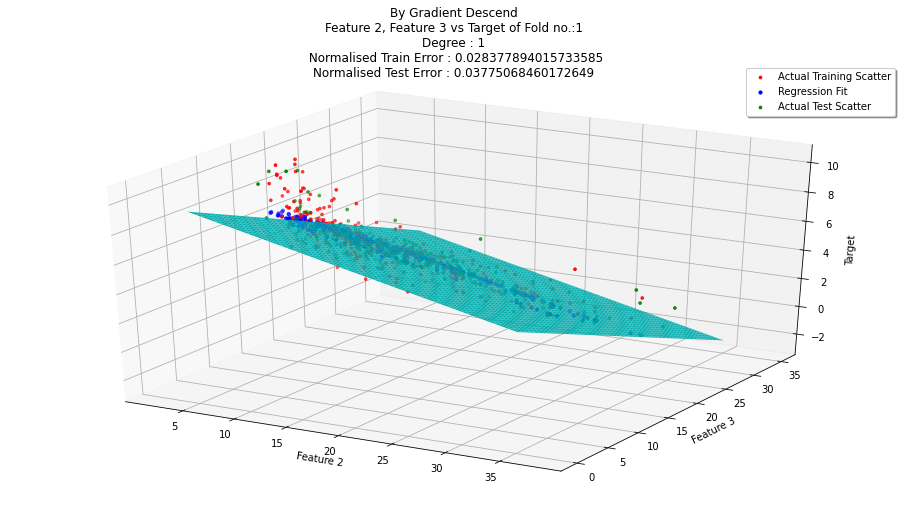

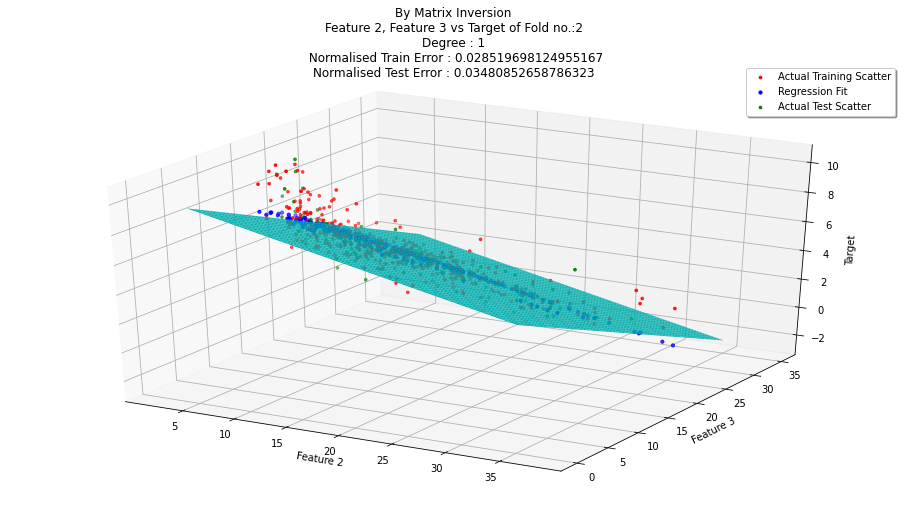

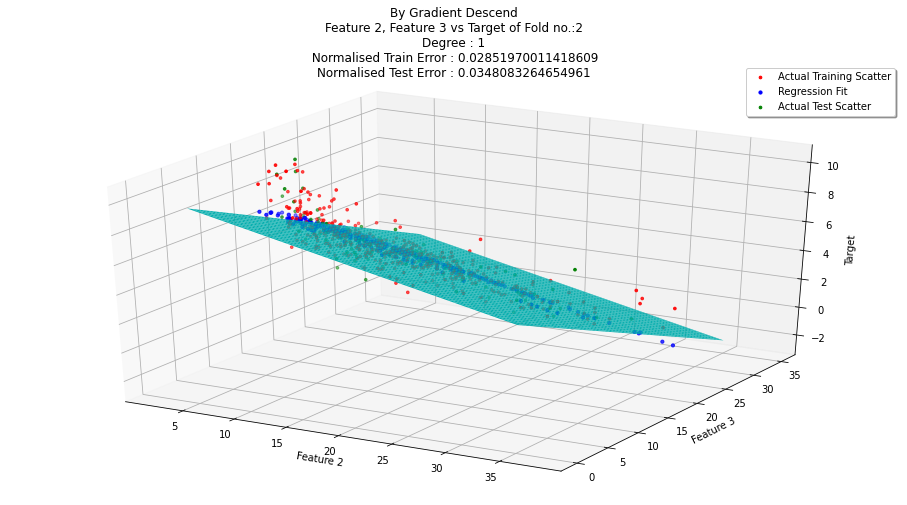

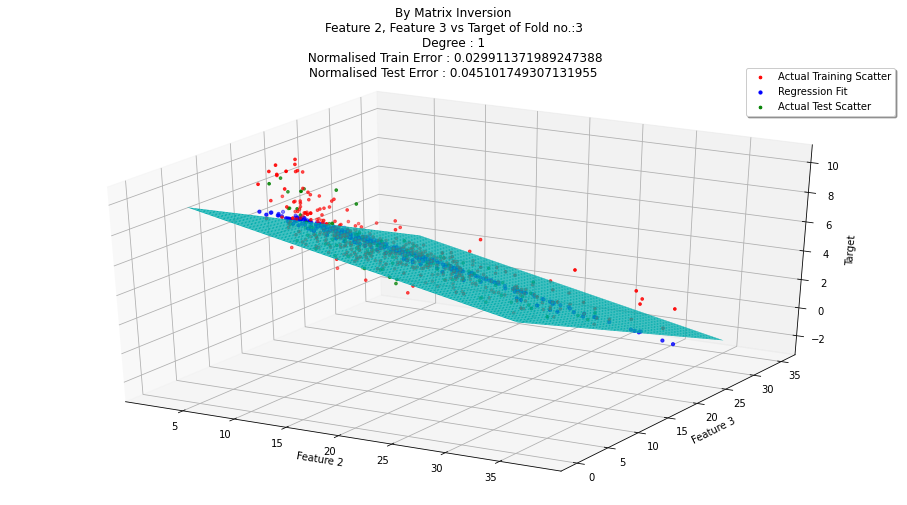

...

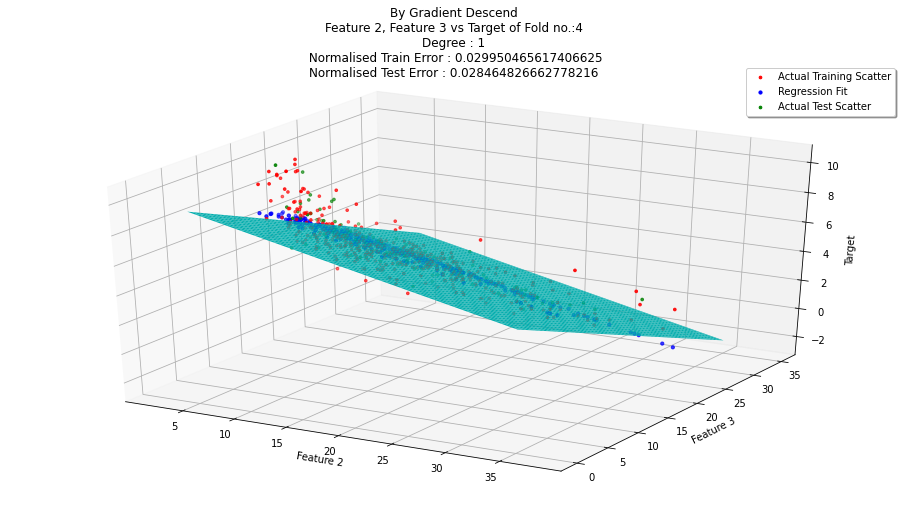

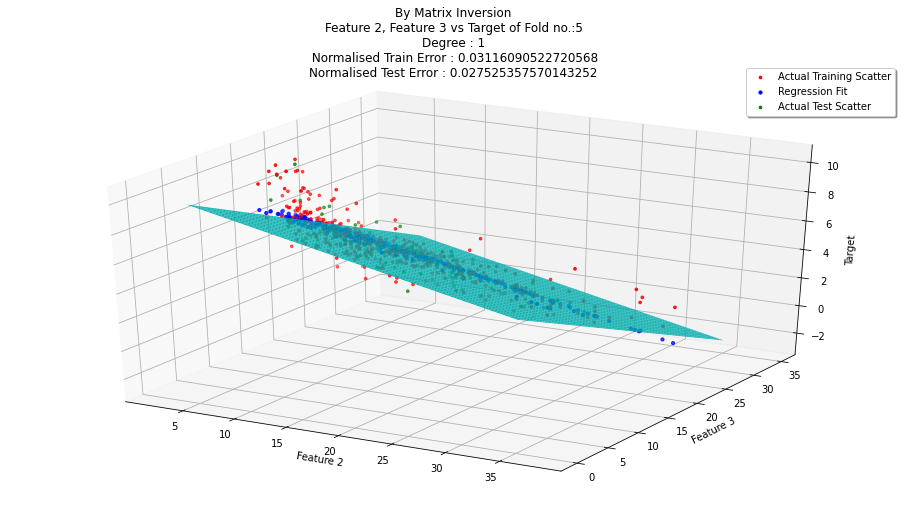

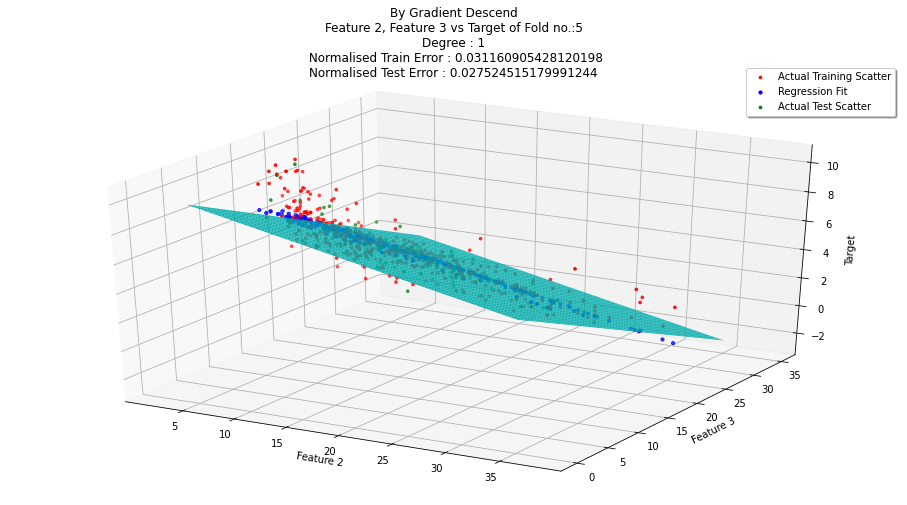

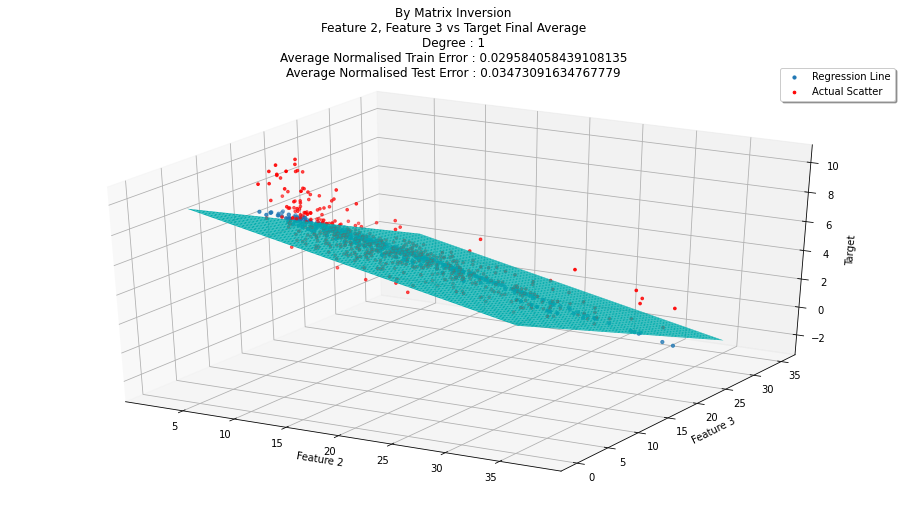

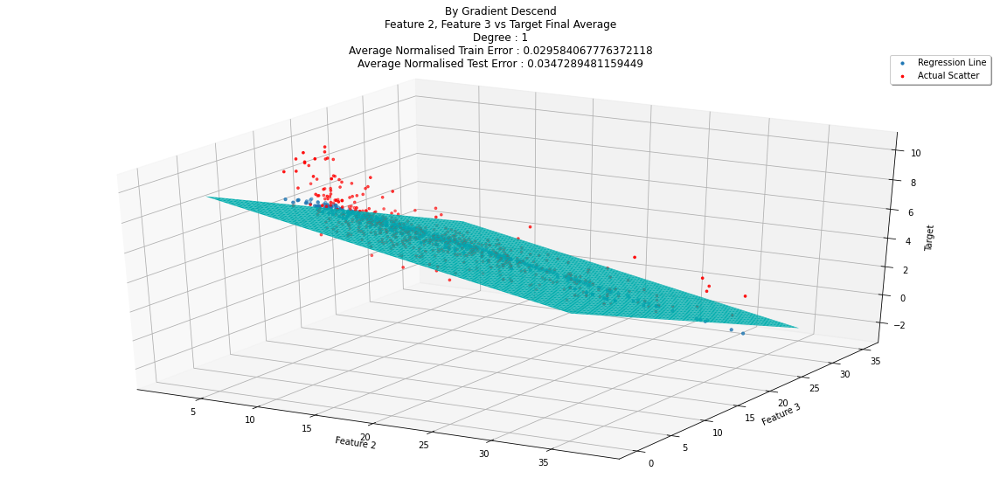



********************
Final Results :
Mean of Weights in k-Fold by Matrix Inversion Method : 
[[10.65587065]
 [-0.1543203 ]
 [-0.2220265 ]]
Standard Deviation of Weights in k-Fold by Matrix Inversion Method : 
[[0.15903611]
 [0.00452332]
 [0.00919364]]
Mean of Weights in k-Fold by Gradient Descend Method : 
[[10.65586]
 [-0.15432]
 [-0.22202]]
Standard Deviation of Weights in k-Fold by Gradient Descend Method : 
[[0.15905356]
 [0.00450218]
 [0.00919095]]
Mean of Normalised Train Error in k-Fold by Matrix Inversion : 0.029584058439108135
Standard Deviation of Normalised Train Error in k-Fold by Matrix Inversion : 0.0010310694472207317
Mean of Normalised Test Error in k-Fold by Matrix Inversion : 0.03473091634767779
Standard Deviation of Normalised Test Error in k-Fold by Matrix Inversion : 0.0064461592525470995
Mean of Normalised Train Error in k-Fold by Gradient Descent : 0.029584067776372118
Standard Deviation of Normalised Train Error in k-Fold by Gradient Descent : 0.00103107004523

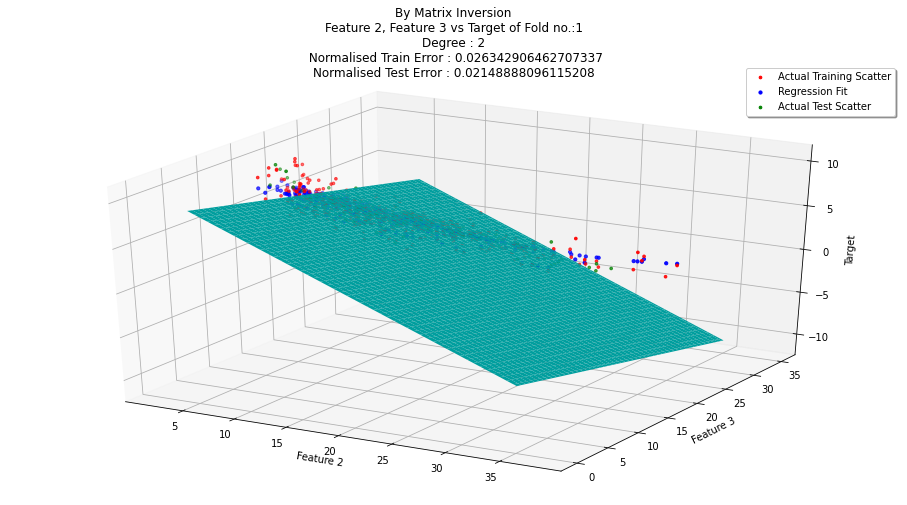

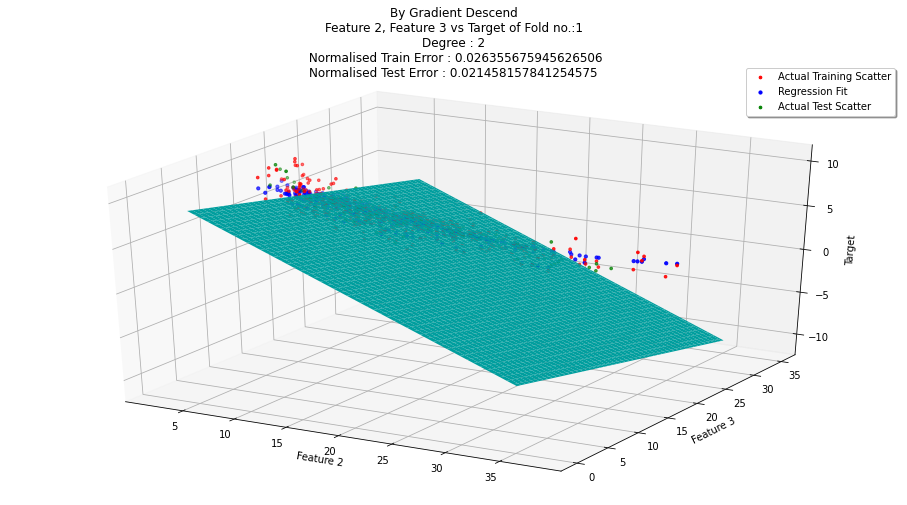

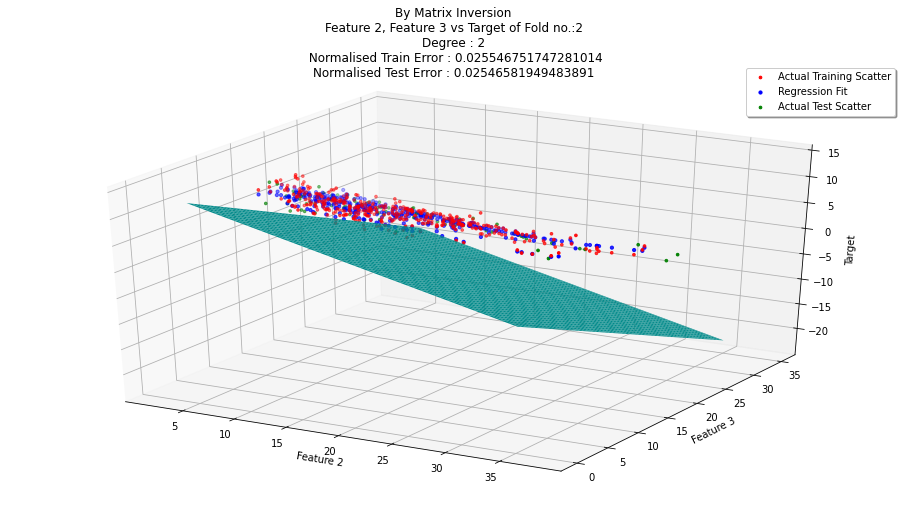

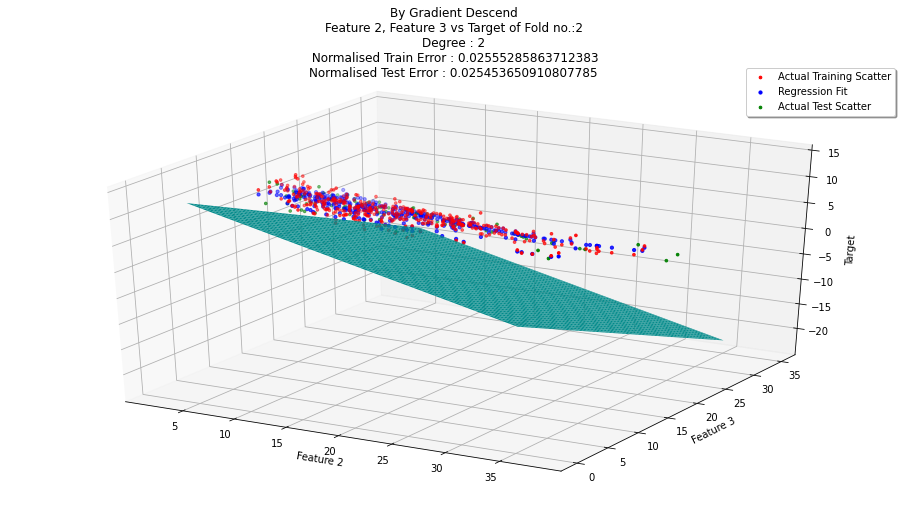

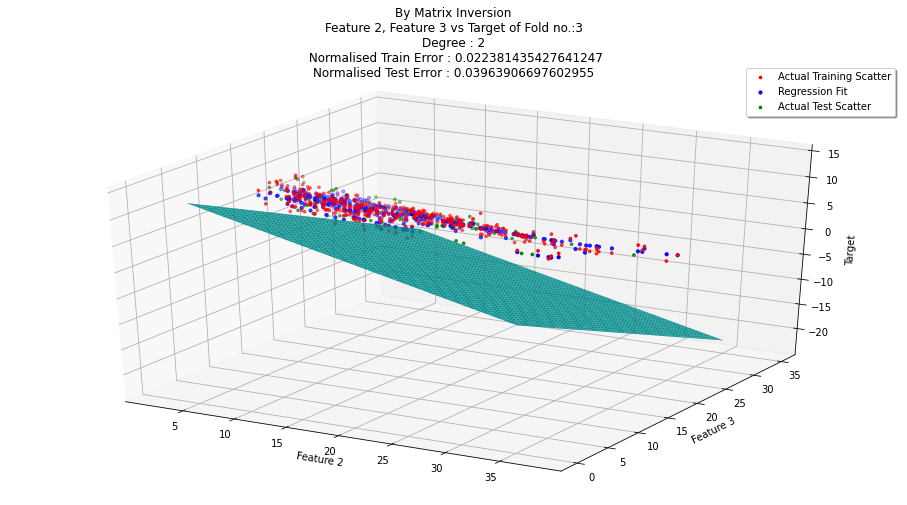

...

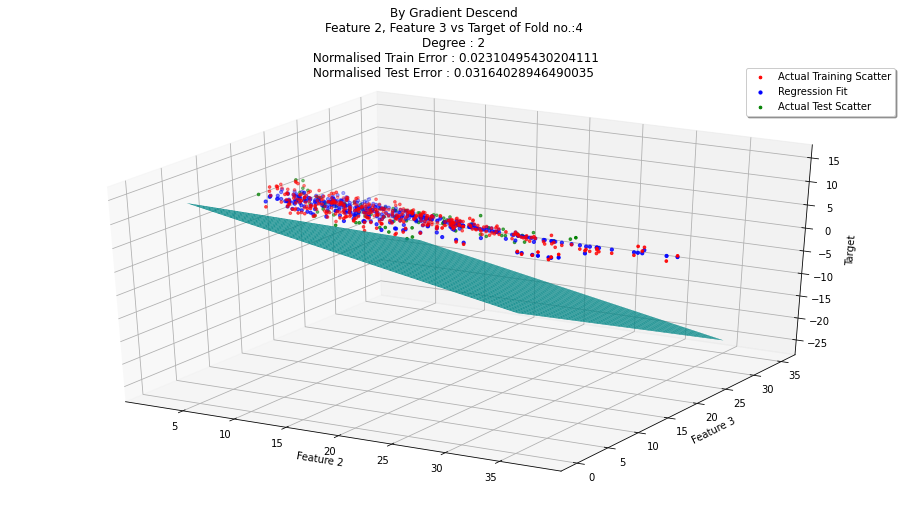

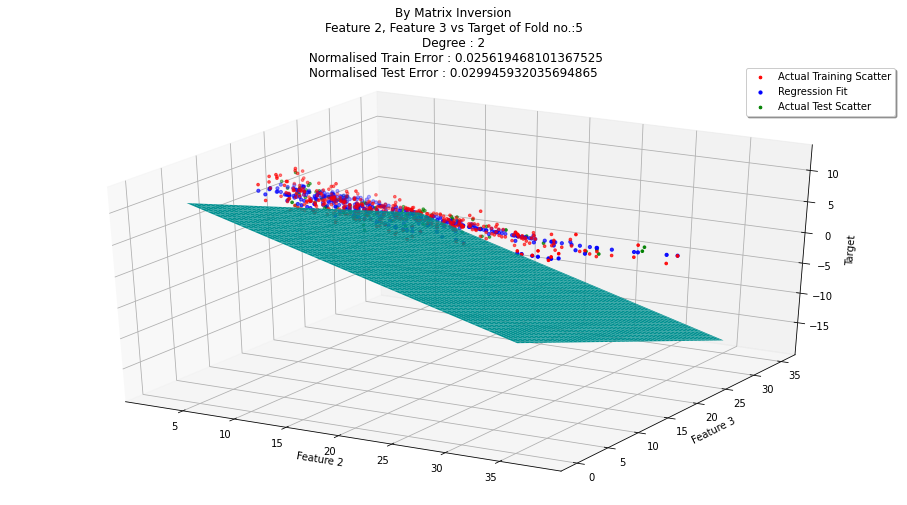

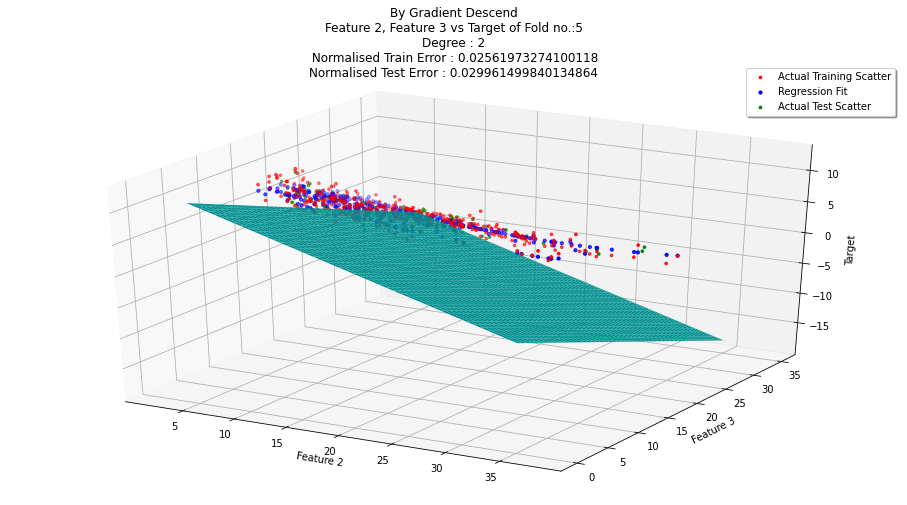

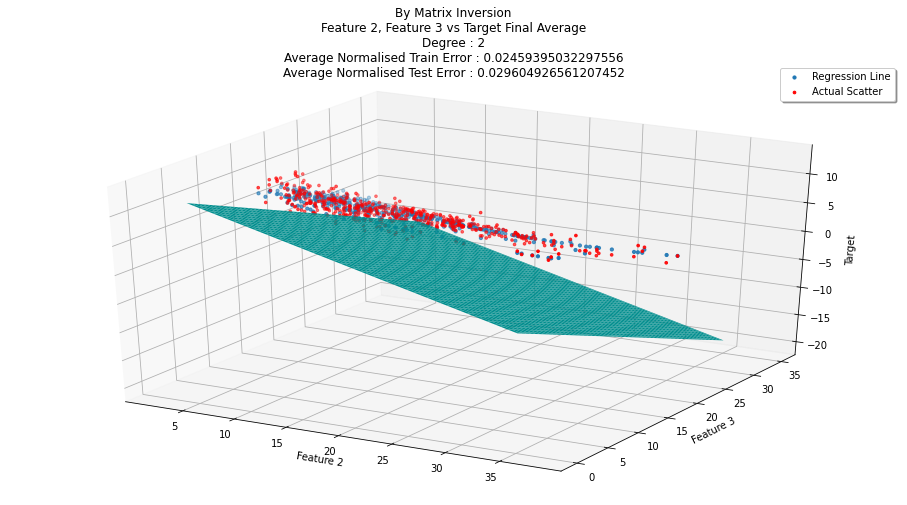

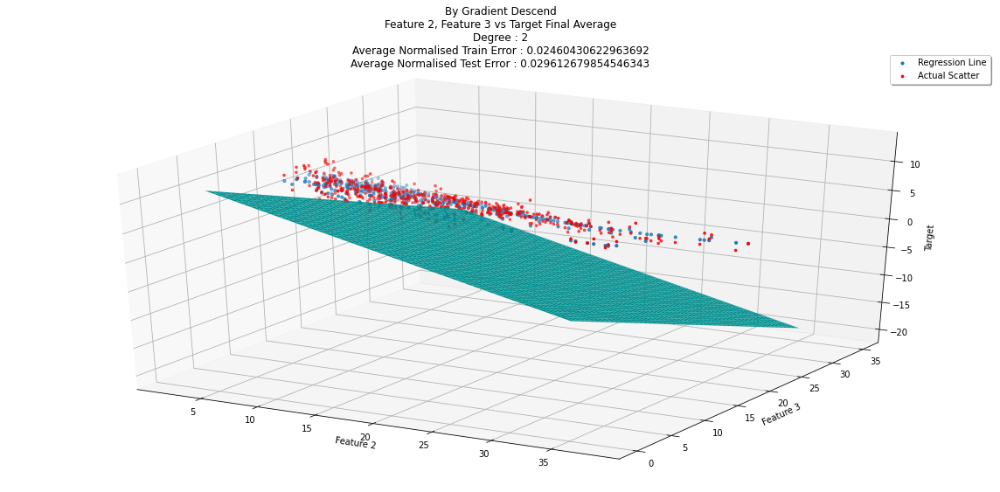



********************
Final Results :
Mean of Weights in k-Fold by Matrix Inversion Method : 
[[ 1.49150758e+01]
 [-4.68264433e-01]
 [-5.30785257e-01]
 [ 7.76736379e-03]
 [ 6.27657634e-03]
 [ 5.90529299e-03]]
Standard Deviation of Weights in k-Fold by Matrix Inversion Method : 
[[1.80467122e+00]
 [1.57772445e-02]
 [2.05368733e-01]
 [5.74858850e-03]
 [5.63011932e-04]
 [3.20858883e-04]]
Mean of Weights in k-Fold by Gradient Descend Method : 
[[ 1.491506e+01]
 [-4.683000e-01]
 [-5.307800e-01]
 [ 7.760000e-03]
 [ 6.260000e-03]
 [ 5.900000e-03]]
Standard Deviation of Weights in k-Fold by Gradient Descend Method : 
[[1.80468651e+00]
 [1.57758043e-02]
 [2.05360214e-01]
 [5.76006944e-03]
 [5.64269439e-04]
 [3.16227766e-04]]
Mean of Normalised Train Error in k-Fold by Matrix Inversion : 0.02459395032297556
Standard Deviation of Normalised Train Error in k-Fold by Matrix Inversion : 0.0015625675166738393
Mean of Normalised Test Error in k-Fold by Matrix Inversion : 0.029604926561207452
Standard

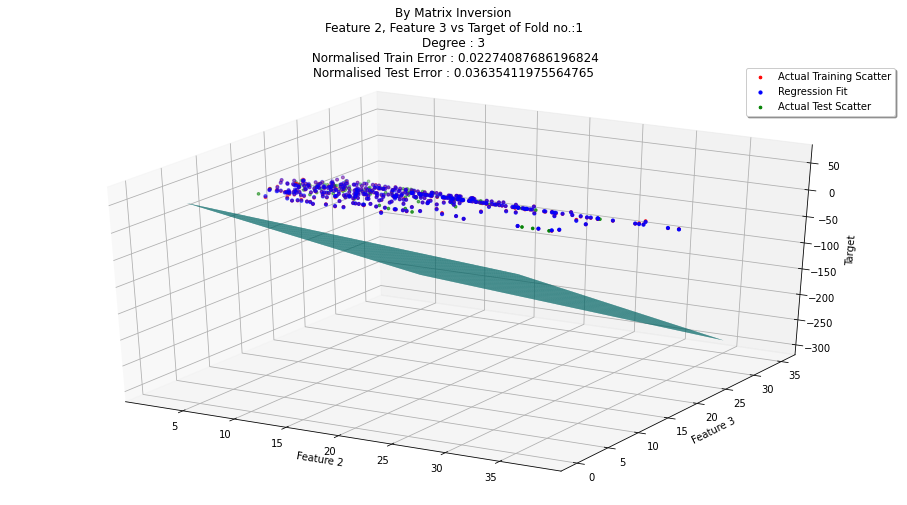

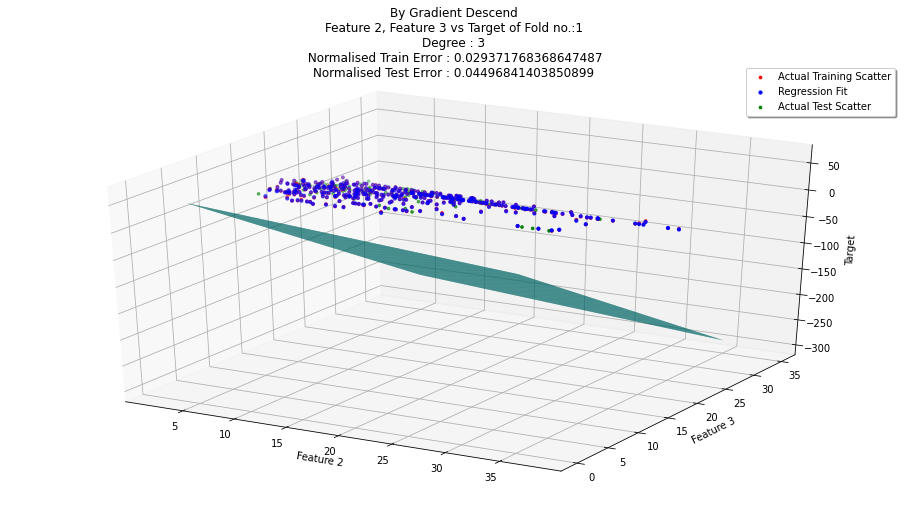

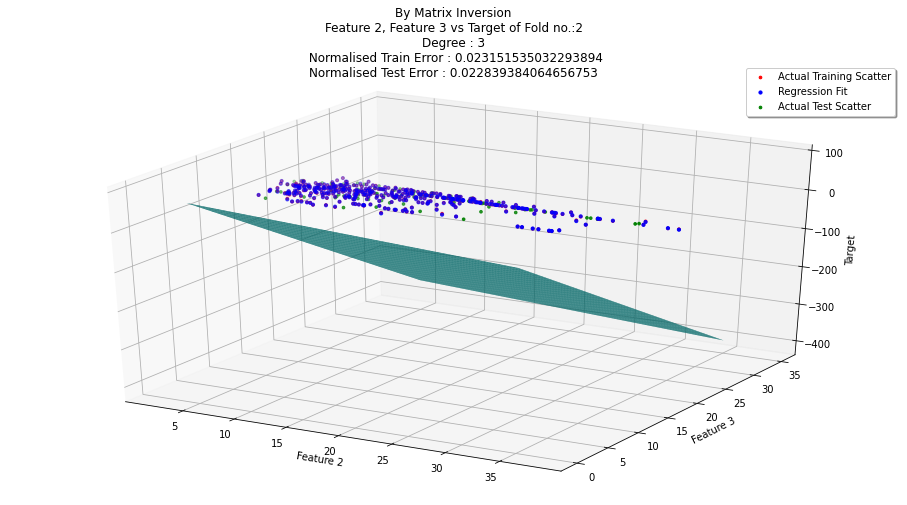

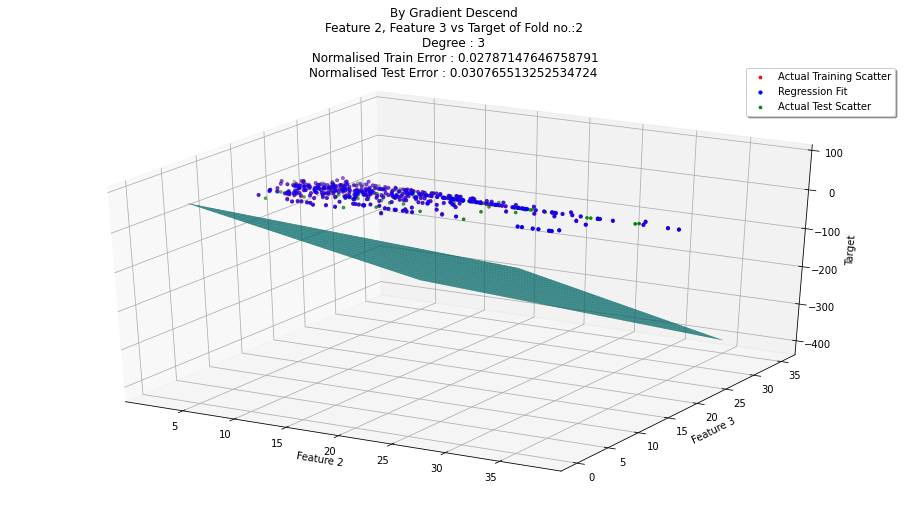

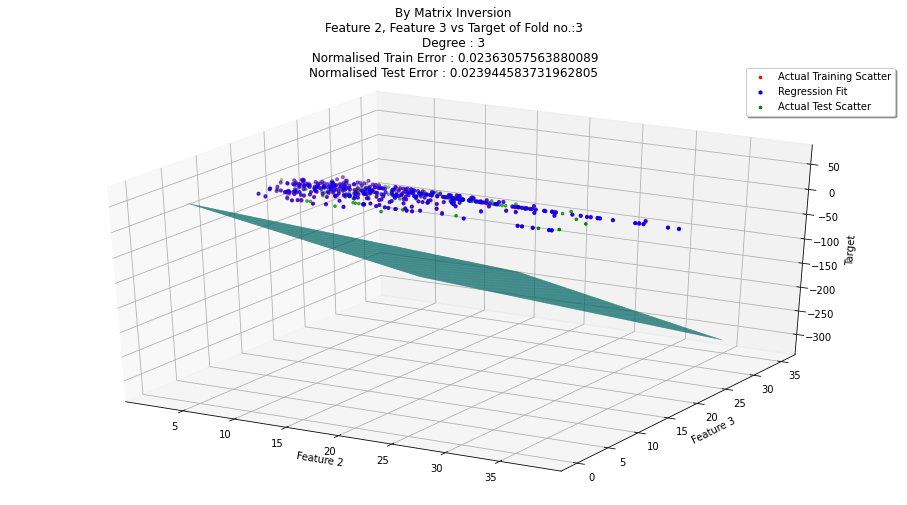

...

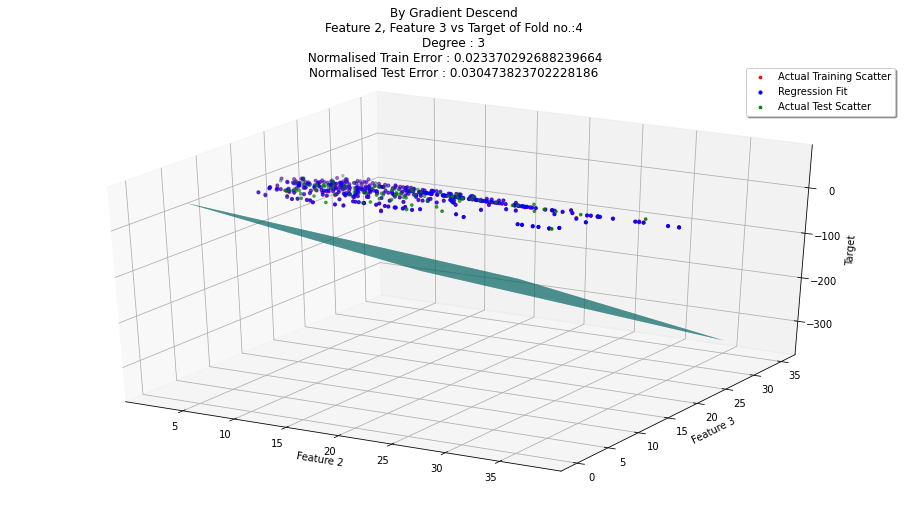

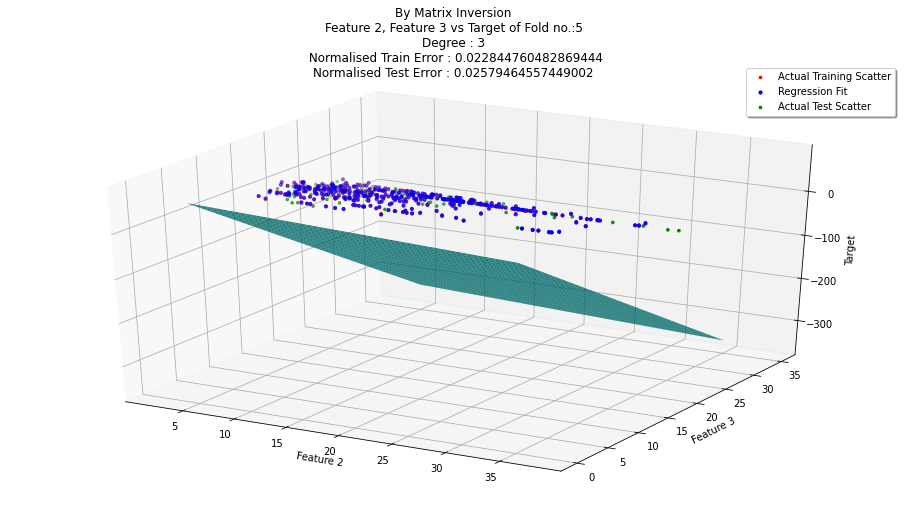

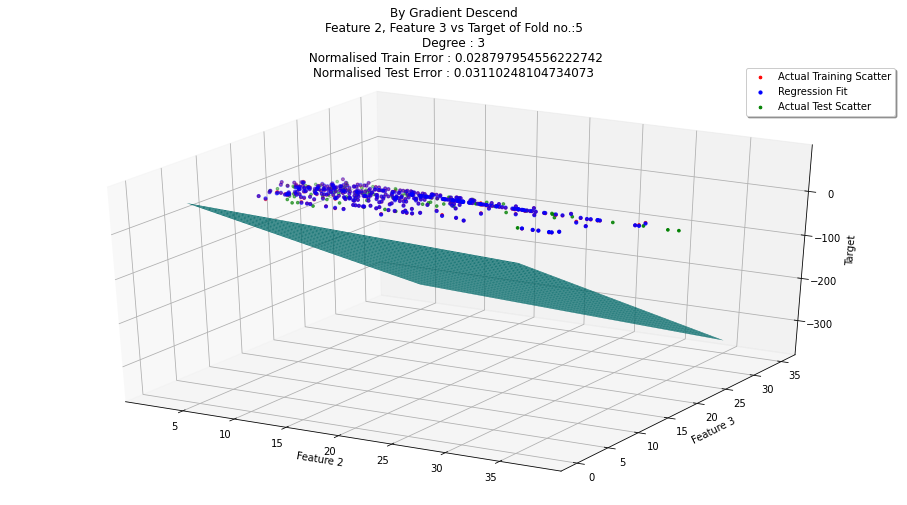

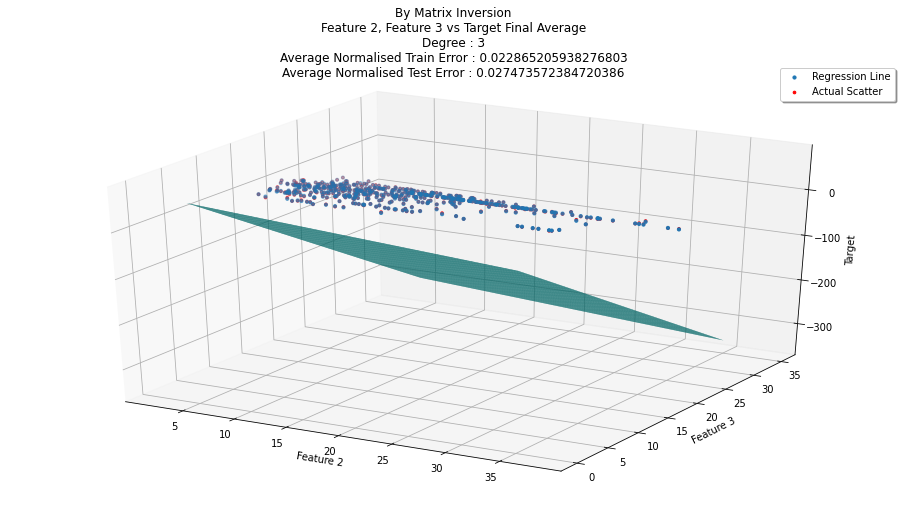

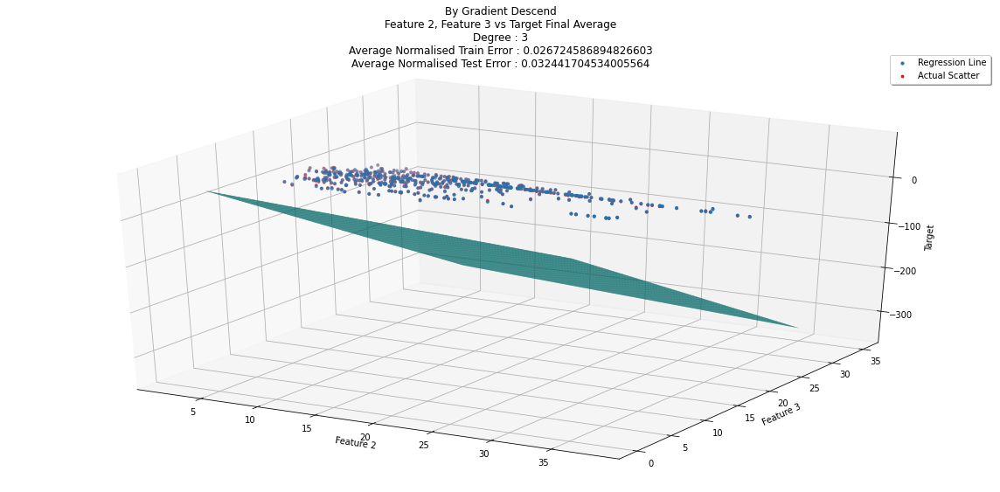



********************
Final Results :
Mean of Weights in k-Fold by Matrix Inversion Method : 
[[ 7.40736828e+01]
 [-1.51879211e+00]
 [-1.03885696e+01]
 [ 5.67096313e-01]
 [-1.07053350e-02]
 [ 7.12962730e-02]
 [-7.41232071e-04]
 [ 3.62430772e-02]
 [-1.26759683e-03]
 [-1.18150642e-04]]
Standard Deviation of Weights in k-Fold by Matrix Inversion Method : 
[[7.53310694e+00]
 [3.36473306e-01]
 [1.30470203e+00]
 [7.68085113e-02]
 [1.50595147e-03]
 [3.42104736e-02]
 [7.82279241e-04]
 [3.34034845e-03]
 [2.36143442e-04]
 [4.58106904e-05]]
Mean of Weights in k-Fold by Gradient Descend Method : 
[[ 7.40736800e+01]
 [-1.51880000e+00]
 [-1.03885600e+01]
 [ 5.67100000e-01]
 [-1.07000000e-02]
 [ 7.13200000e-02]
 [-7.40000007e-04]
 [ 3.62200000e-02]
 [-1.26000001e-03]
 [-1.20000006e-04]]
Standard Deviation of Weights in k-Fold by Gradient Descend Method : 
[[7.53312006e+00]
 [3.36467407e-01]
 [1.30468285e+00]
 [7.68117179e-02]
 [1.48458752e-03]
 [3.42116588e-02]
 [7.78716870e-04]
 [3.32168632e-03]
 [

In [24]:
feature1 = np.asarray(data[1]).reshape(1,487)
feature2 = np.asarray(data[2]).reshape(1,487)

for degree in [1,2,3]:
    print("\n\nPolyFit For Degree : "+str(degree))
    feature1_t = data_transform(feature1,feature2,degree)
    feature1_t = np.column_stack((feature1_t.T, data[3]))
    feature1_t = pd.DataFrame(data = feature1_t)
    epoch = 1 if (degree>2) else 3
    w = k.kFCVEvaluate(dataset=feature1_t,extra=['Feature 2','Feature 3'],p=2,q=degree,epoch=epoch,scope=0.001,lr=0.00000000000001)
    y_pred1 = data_transform(feature1,feature2,degree,1).T @ w[0]
    y_pred2 = data_transform(feature1,feature2,degree,1).T @ w[1]
    if degree == 2 : 
        wz1.append(y_pred1)
        wz2.append(y_pred2)

<h1><strong>B. Final Results of Poly Regression</strong></h1>

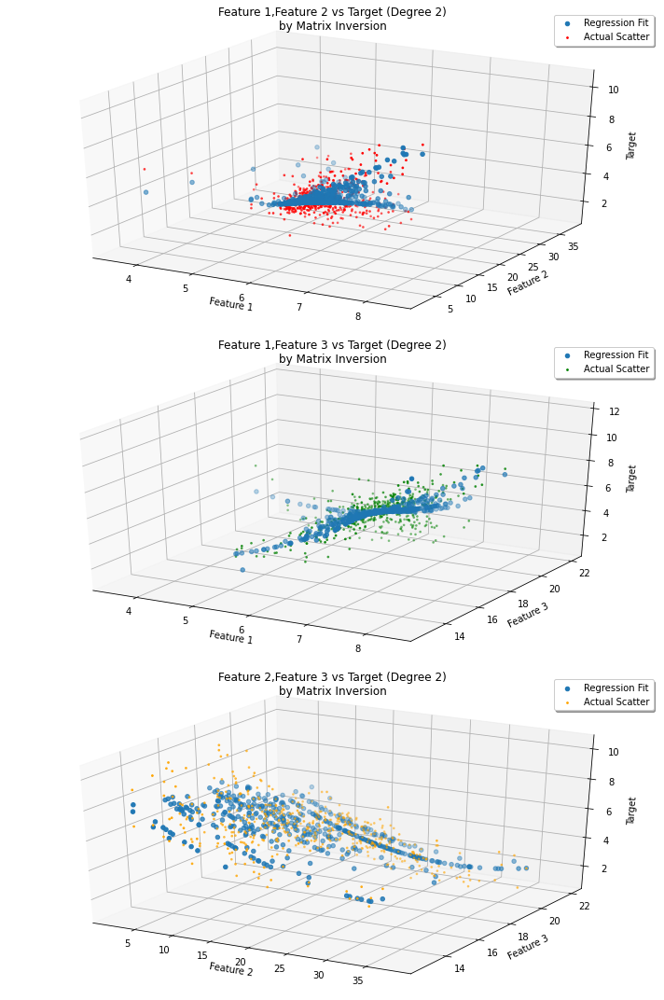

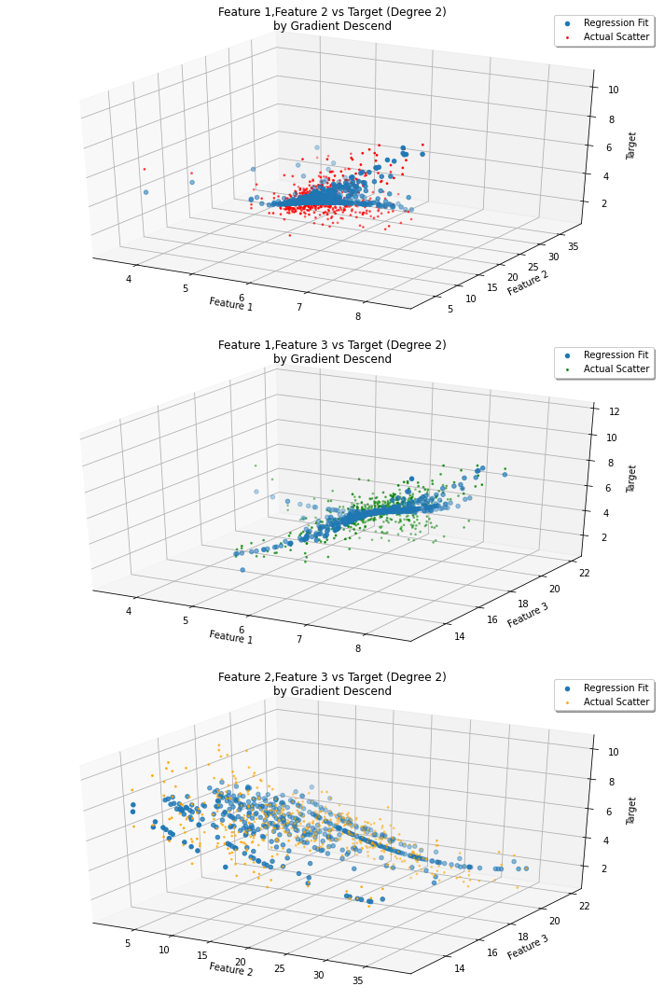

In [25]:
for i,val in enumerate(['Matrix Inversion','Gradient Descend']): 
    w = wz1 if (i==0) else wz2
    fig = plt.figure(figsize=(10,15))

    ax1 = fig.add_subplot(3, 1, 1, projection='3d')
    ax1.scatter(dataset1[dataset1.columns[0]],dataset1[dataset1.columns[1]],w[0],label="Regression Fit")
    ax1.scatter(dataset1[dataset1.columns[0]],dataset1[dataset1.columns[1]], dataset1[dataset1.columns[-1]],c='r',s=3,label="Actual Scatter")
    ax1.set_title('Feature 1,Feature 2 vs Target (Degree 2)\nby '+str(val)) 
    ax1.set(xlabel='Feature 1', ylabel='Feature 2', zlabel="Target")
    ax1.legend(shadow=True, fancybox=True)

    ax2 = fig.add_subplot(3, 1, 2, projection='3d')
    ax2.scatter(dataset2[dataset2.columns[0]],dataset2[dataset2.columns[1]],w[1],label="Regression Fit")
    ax2.scatter(dataset2[dataset2.columns[0]],dataset2[dataset2.columns[1]], dataset2[dataset2.columns[-1]],c='g',s=3,label="Actual Scatter")
    ax2.set_title('Feature 1,Feature 3 vs Target (Degree 2)\nby '+str(val))
    ax2.set(xlabel='Feature 1', ylabel='Feature 3', zlabel="Target")
    ax2.legend(shadow=True, fancybox=True)

    ax3 = fig.add_subplot(3, 1, 3, projection='3d')
    ax3.scatter(dataset3[dataset3.columns[0]],dataset3[dataset3.columns[1]],w[2],label="Regression Fit")
    ax3.scatter(dataset3[dataset3.columns[0]],dataset3[dataset3.columns[1]], dataset3[dataset3.columns[-1]],c='orange',s=3,label="Actual Scatter")
    ax3.set_title('Feature 2,Feature 3 vs Target (Degree 2)\nby '+str(val))
    ax3.set(xlabel='Feature 2', ylabel='Feature 3', zlabel="Target")
    ax3.legend(shadow=True, fancybox=True)

    fig.tight_layout()
    plt.tight_layout()
    plt.show()

<h3><strong> B. Handwritten Notes</strong></h3>

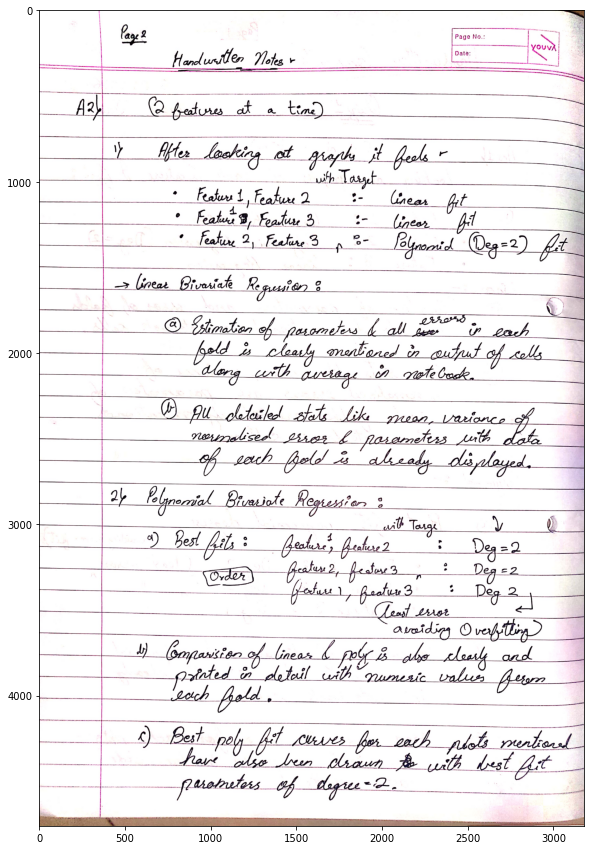

In [26]:
im = cv2.imread('Page2.jpg')
plt.figure(figsize=(30,15))
plt.imshow(cv2.cvtColor(im, cv2.COLOR_BGR2RGB))
plt.show()

<h1><strong> Question 3</strong></h1>
<h2><strong> C. MultiVariable Linear Regression</strong></h2>

<h3><strong> C. Handwritten Notes</strong></h3>

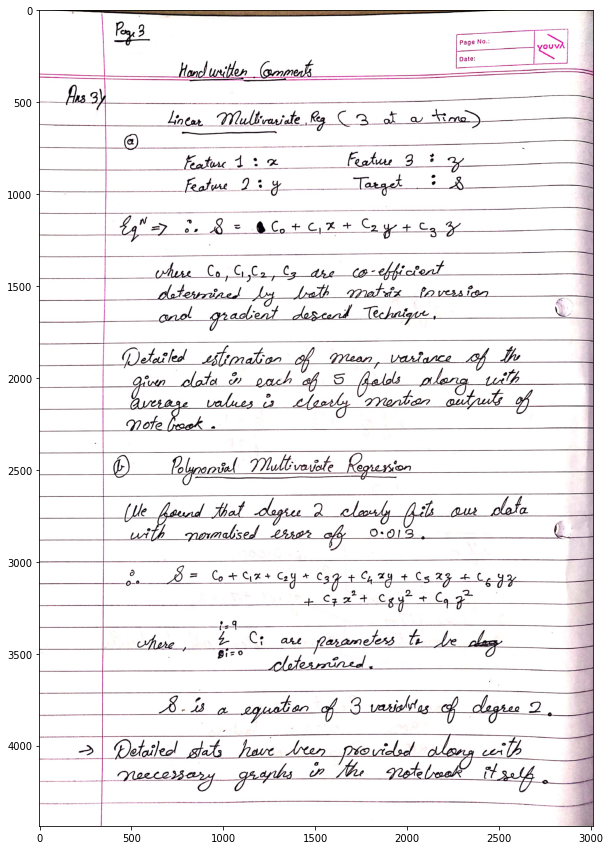

In [27]:
im = cv2.imread('Page3.jpg')
plt.figure(figsize=(30,15))
plt.imshow(cv2.cvtColor(im, cv2.COLOR_BGR2RGB))
plt.show()



********************
Results of Parameters and Errors in K-Fold no. : 1
Weights by Matrix Inversion : 
[[ 4.52266965]
 [ 0.8617979 ]
 [-0.10909008]
 [-0.21583011]]
Weights by Gradient Descent : 
[[ 4.52269906]
 [ 0.86179409]
 [-0.10911159]
 [-0.21581759]]
Normalized Train Error by Matrix Inversion : 0.021913000564377408
Normalized Test Error by Matrix Inversion : 0.0380046095727124
Normalized Train Error by Gradient Descent : 0.021913001213257705
Normalized Test Error by Gradient Descent : 0.03800594411699203
********************


********************
Results of Parameters and Errors in K-Fold no. : 2
Weights by Matrix Inversion : 
[[ 4.09041555]
 [ 0.8655333 ]
 [-0.11072159]
 [-0.18848818]]
Weights by Gradient Descent : 
[[ 4.09040033]
 [ 0.86550218]
 [-0.11069807]
 [-0.18849414]]
Normalized Train Error by Matrix Inversion : 0.02602544469532142
Normalized Test Error by Matrix Inversion : 0.017149086942403826
Normalized Train Error by Gradient Descent : 0.026025445710053035
Normaliz

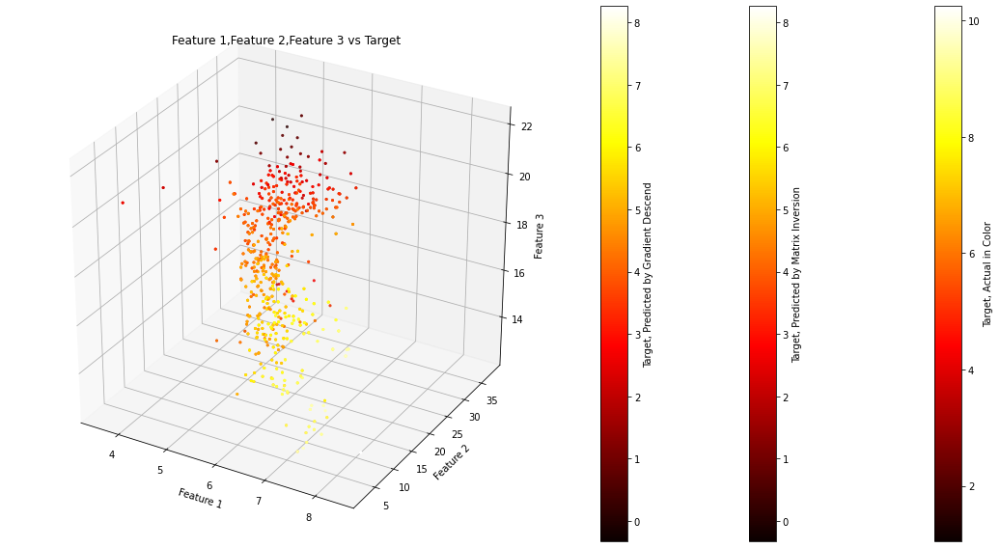



********************
Final Results :
Mean of Weights in k-Fold by Matrix Inversion Method : 
[[ 4.25211835]
 [ 0.86007289]
 [-0.10913204]
 [-0.19755887]]
Standard Deviation of Weights in k-Fold by Matrix Inversion Method : 
[[0.36350977]
 [0.04080603]
 [0.0037415 ]
 [0.00968899]]
Mean of Weights in k-Fold by Gradient Descend Method : 
[[ 4.25212041]
 [ 0.86006249]
 [-0.10913397]
 [-0.19755239]]
Standard Deviation of Weights in k-Fold by Gradient Descend Method : 
[[0.36353076]
 [0.04080716]
 [0.00375455]
 [0.0096824 ]]
Mean of Normalised Train Error in k-Fold by Matrix Inversion : 0.02375585167223567
Standard Deviation of Normalised Train Error in k-Fold by Matrix Inversion : 0.001438299555321287
Mean of Normalised Test Error in k-Fold by Matrix Inversion : 0.02966655878366879
Standard Deviation of Normalised Test Error in k-Fold by Matrix Inversion : 0.00786725520144193
Mean of Normalised Train Error in k-Fold by Gradient Descent : 0.02375585256390056
Standard Deviation of Normalise

In [28]:
w = k.kFCVEvaluate(dataset=data,p=3)

<h2><strong> C. MultiVariable Polynomial Regression</strong></h2>



PolyFit For Degree : 1


********************
Results of Parameters and Errors in K-Fold no. : 1
Weights by Matrix Inversion : 
[[ 4.33575751]
 [ 0.87016487]
 [-0.10641928]
 [-0.20786524]]
Weights by Gradient Descent : 
[[ 4.3358]
 [ 0.8702]
 [-0.1064]
 [-0.2079]]
Normalized Train Error by Matrix Inversion : 0.023478030954407158
Normalized Test Error by Matrix Inversion : 0.028997071898487947
Normalized Train Error by Gradient Descent : 0.023478031955266307
Normalized Test Error by Gradient Descent : 0.02899830854277384
********************


********************
Results of Parameters and Errors in K-Fold no. : 2
Weights by Matrix Inversion : 
[[ 5.21382081]
 [ 0.76533951]
 [-0.11254162]
 [-0.21333649]]
Weights by Gradient Descent : 
[[ 5.2138]
 [ 0.7653]
 [-0.1125]
 [-0.2133]]
Normalized Train Error by Matrix Inversion : 0.024682728064893723
Normalized Test Error by Matrix Inversion : 0.021354435293141884
Normalized Train Error by Gradient Descent : 0.024682759845261942
Normalized T

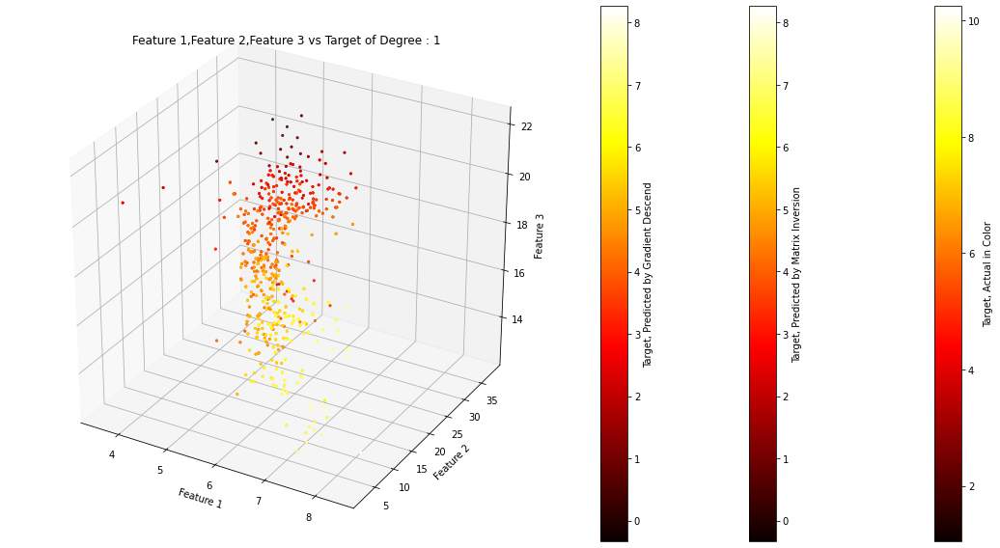



********************
Final Results :
Mean of Weights in k-Fold by Matrix Inversion Method : 
[[ 4.21994916]
 [ 0.86316383]
 [-0.10913266]
 [-0.19690178]]
Standard Deviation of Weights in k-Fold by Matrix Inversion Method : 
[[0.56701823]
 [0.05342337]
 [0.00439297]
 [0.01516092]]
Mean of Weights in k-Fold by Gradient Descend Method : 
[[ 4.21994]
 [ 0.86316]
 [-0.10912]
 [-0.19688]]
Standard Deviation of Weights in k-Fold by Gradient Descend Method : 
[[0.56702369]
 [0.05344233]
 [0.00437145]
 [0.01517187]]
Mean of Normalised Train Error in k-Fold by Matrix Inversion : 0.02379983235106766
Standard Deviation of Normalised Train Error in k-Fold by Matrix Inversion : 0.0007195509077346762
Mean of Normalised Test Error in k-Fold by Matrix Inversion : 0.03245603560483893
Standard Deviation of Normalised Test Error in k-Fold by Matrix Inversion : 0.008650742570084758
Mean of Normalised Train Error in k-Fold by Gradient Descent : 0.02379985053596258
Standard Deviation of Normalised Train Er

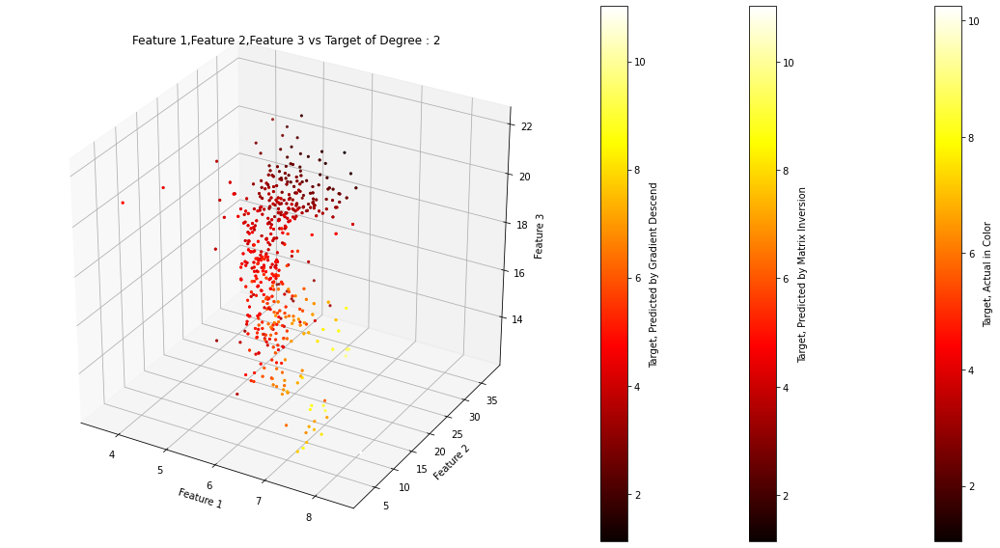



********************
Final Results :
Mean of Weights in k-Fold by Matrix Inversion Method : 
[[-2.29684031e+01]
 [ 1.59951609e+00]
 [ 4.24984654e-01]
 [ 2.12270527e+00]
 [-2.54027096e-02]
 [-1.24142150e-02]
 [-3.04577564e-04]
 [-1.93367854e-01]
 [-4.90170394e-02]
 [ 2.73003756e-01]]
Standard Deviation of Weights in k-Fold by Matrix Inversion Method : 
[[3.62749709e+00]
 [6.52456795e-01]
 [4.37713823e-02]
 [2.40662509e-01]
 [3.26820655e-03]
 [1.56891345e-03]
 [3.74246757e-04]
 [1.85429657e-02]
 [7.24420741e-03]
 [3.96198300e-02]]
Mean of Weights in k-Fold by Gradient Descend Method : 
[[-2.29684e+01]
 [ 1.59950e+00]
 [ 4.25000e-01]
 [ 2.12270e+00]
 [-2.54200e-02]
 [-1.24200e-02]
 [-3.20000e-04]
 [-1.93340e-01]
 [-4.90200e-02]
 [ 2.73000e-01]]
Standard Deviation of Weights in k-Fold by Gradient Descend Method : 
[[3.62749432e+00]
 [6.52477374e-01]
 [4.37913690e-02]
 [2.40664488e-01]
 [3.26582302e-03]
 [1.56511980e-03]
 [3.86781592e-04]
 [1.85356521e-02]
 [7.23834235e-03]
 [3.96079790e-

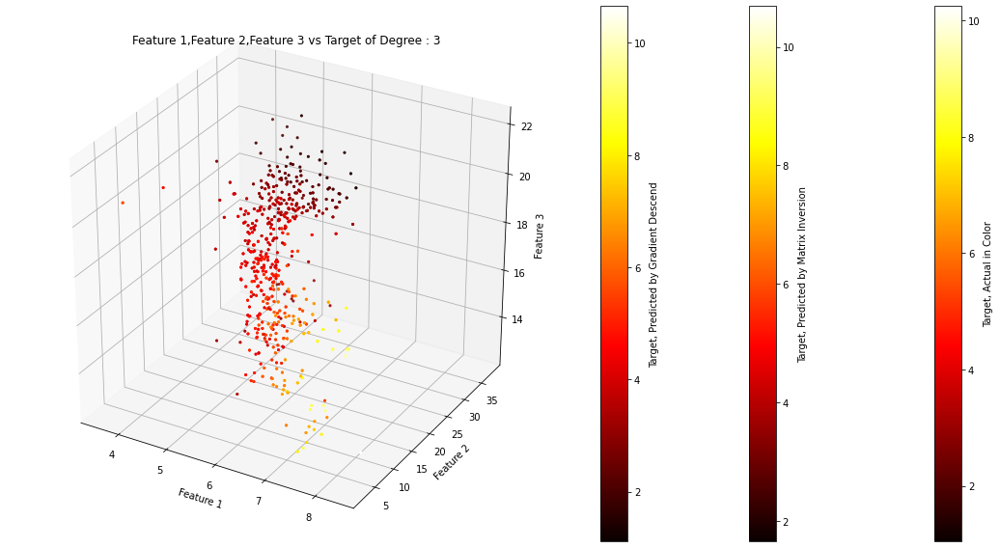



********************
Final Results :
Mean of Weights in k-Fold by Matrix Inversion Method : 
[[ 7.78900079e+00]
 [-1.70340488e+01]
 [-6.48542148e-01]
 [ 3.87012341e+00]
 [-1.38790737e-01]
 [ 1.55123497e-03]
 [ 4.96982155e-02]
 [-1.73186162e-03]
 [-1.74229638e-02]
 [-2.04039937e-04]
 [ 2.52966844e-04]
 [-2.78870724e-01]
 [ 8.21181366e-03]
 [ 2.47756581e-01]
 [ 1.33727194e-03]
 [ 1.25382911e-03]
 [ 3.26200289e+00]
 [-1.38295673e-02]
 [-3.27677972e-02]
 [-1.35710536e-01]]
Standard Deviation of Weights in k-Fold by Matrix Inversion Method : 
[[2.14102087e+01]
 [7.61837409e+00]
 [5.98233852e-01]
 [2.74823627e+00]
 [1.49603175e-01]
 [2.77915469e-03]
 [2.33563819e-02]
 [5.00655555e-04]
 [6.73347756e-03]
 [9.44192692e-05]
 [5.10114231e-05]
 [3.83086194e-01]
 [9.14404773e-03]
 [1.22674190e-01]
 [2.52436598e-03]
 [6.06431300e-04]
 [8.18341341e-01]
 [1.41479240e-02]
 [6.65447332e-03]
 [2.85979179e-02]]
Mean of Weights in k-Fold by Gradient Descend Method : 
[[ 7.78900000e+00]
 [-1.70340600e+01]

In [29]:
def data_transform(X,Y,Z,degree,n=0): 
    X_new = np.ones(X.shape)
    X_new = np.concatenate((X_new,X))
    X_new = np.concatenate((X_new,Y))
    X_new = np.concatenate((X_new,Z))
    for i in range(degree+1): 
        for j in range(degree+1):
            for k in range(degree+1):
                if ((i+j+k > 1) and (i+j+k <= degree)) : X_new = np.concatenate((X_new,((X**i)*(Y**j)*(Z**k))))
    if(n==0) : X_new = np.delete(X_new, 0, 0)
    return X_new

feature1 = np.asarray(data[0]).reshape(1,487)
feature2 = np.asarray(data[1]).reshape(1,487)
feature3 = np.asarray(data[2]).reshape(1,487)

for degree in [1,2,3]:
    print("\n\nPolyFit For Degree : "+str(degree))
    feature1_t = data_transform(feature1,feature2,feature3,degree)
    feature1_t = np.column_stack((feature1_t.T, data[3]))
    feature1_t = pd.DataFrame(data = feature1_t)
    epoch = 1  if (degree>2) else 3
    w = k.kFCVEvaluate(dataset=feature1_t,p=3,q=degree,epoch=epoch,scope=0.001,lr=0.00000000000001)

<h3><strong> C. Handwritten Notes</strong></h3>

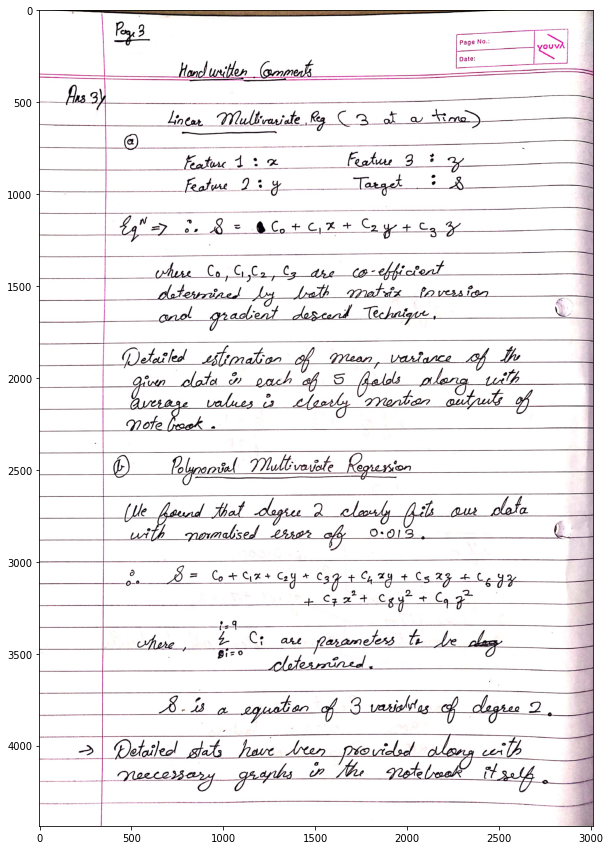

In [30]:
im = cv2.imread('Page3.jpg')
plt.figure(figsize=(30,15))
plt.imshow(cv2.cvtColor(im, cv2.COLOR_BGR2RGB))
plt.show()

<h1><strong> Code Ends Here</strong></h1>
<h2> Both Matrix Inversion & Gradient Descend are Used everywhere</h2>
<h3>
Both Hand Written Comments as well as all fully detailed Stats (i.e Mean, Variance) are provided for all sorts of Computations
</h3>
<h3><strong>Thanks for extending the deadline, Bye. </strong></h3>

---






